In [10]:
#setting for google colab
!apt-get install -y -qq software-properties-common python-software-properties module-init-tools
!add-apt-repository -y ppa:alessandro-strada/ppa 2>&1 > /dev/null
!apt-get update -qq 2>&1 > /dev/null
!apt-get -y install -qq google-drive-ocamlfuse fuse
from google.colab import auth
auth.authenticate_user()
from oauth2client.client import GoogleCredentials
creds = GoogleCredentials.get_application_default()
import getpass
!google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret} < /dev/null 2>&1 | grep URL
vcode = getpass.getpass()
!echo {vcode} | google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret}

gpg: keybox '/tmp/tmpt2sn8ulr/pubring.gpg' created
gpg: /tmp/tmpt2sn8ulr/trustdb.gpg: trustdb created
gpg: key AD5F235DF639B041: public key "Launchpad PPA for Alessandro Strada" imported
gpg: Total number processed: 1
gpg:               imported: 1
··········


In [0]:
!mkdir -p drive
!google-drive-ocamlfuse drive  -o nonempty

# Fully-Connected Neural Nets
In the previous homework you implemented a fully-connected two-layer neural network on CIFAR-10. The implementation was simple but not very modular since the loss and gradient were computed in a single monolithic function. This is manageable for a simple two-layer network, but would become impractical as we move to bigger models. Ideally we want to build networks using a more modular design so that we can implement different layer types in isolation and then snap them together into models with different architectures.

In this exercise we will implement fully-connected networks using a more modular approach. For each layer we will implement a `forward` and a `backward` function. The `forward` function will receive inputs, weights, and other parameters and will return both an output and a `cache` object storing data needed for the backward pass, like this:

```python
def layer_forward(x, w):
  """ Receive inputs x and weights w """
  # Do some computations ...
  z = # ... some intermediate value
  # Do some more computations ...
  out = # the output
   
  cache = (x, w, z, out) # Values we need to compute gradients
   
  return out, cache
```

The backward pass will receive upstream derivatives and the `cache` object, and will return gradients with respect to the inputs and weights, like this:

```python
def layer_backward(dout, cache):
  """
  Receive derivative of loss with respect to outputs and cache,
  and compute derivative with respect to inputs.
  """
  # Unpack cache values
  x, w, z, out = cache
  
  # Use values in cache to compute derivatives
  dx = # Derivative of loss with respect to x
  dw = # Derivative of loss with respect to w
  
  return dx, dw
```

After implementing a bunch of layers this way, we will be able to easily combine them to build classifiers with different architectures.

In addition to implementing fully-connected networks of arbitrary depth, we will also explore different update rules for optimization, and introduce Dropout as a regularizer and Batch Normalization as a tool to more efficiently optimize deep networks.
  

In [11]:
# As usual, a bit of setup
from __future__ import print_function
import time
import numpy as np
import matplotlib.pyplot as plt
from drive.Stanford.CS231n_master.assignment2.cs231n.classifiers.fc_net import *
from drive.Stanford.CS231n_master.assignment2.cs231n.data_utils import get_CIFAR10_data
from drive.Stanford.CS231n_master.assignment2.cs231n.gradient_check import eval_numerical_gradient, eval_numerical_gradient_array
#from drive.Stanford.CS231n_master.assignment2.cs231n.solver import Solver

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
  """ returns relative error """
  return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
!sh drive/Stanford/CS231n_master/assignment1/cs231n/datasets/get_datasets.sh

--2018-06-05 03:28:30--  http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz
Resolving www.cs.toronto.edu (www.cs.toronto.edu)... 128.100.3.30
Connecting to www.cs.toronto.edu (www.cs.toronto.edu)|128.100.3.30|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 170498071 (163M) [application/x-gzip]
Saving to: ‘cifar-10-python.tar.gz’

cifar-10-python.tar  46%[========>           ]  75.16M   838KB/s    eta 64s    

cifar-10-python.tar 100%[===================>] 162.60M  1.13MB/s    in 2m 12s  

2018-06-05 03:30:42 (1.23 MB/s) - ‘cifar-10-python.tar.gz’ saved [170498071/170498071]

cifar-10-batches-py/
cifar-10-batches-py/data_batch_4
cifar-10-batches-py/readme.html
cifar-10-batches-py/test_batch
cifar-10-batches-py/data_batch_3
cifar-10-batches-py/batches.meta
cifar-10-batches-py/data_batch_2
cifar-10-batches-py/data_batch_5
cifar-10-batches-py/data_batch_1


In [12]:
# Load the (preprocessed) CIFAR10 data.
import os
data = get_CIFAR10_data()
for k, v in list(data.items()):
  print(('%s: ' % k, v.shape))

('X_train: ', (49000, 3, 32, 32))
('y_train: ', (49000,))
('X_val: ', (1000, 3, 32, 32))
('y_val: ', (1000,))
('X_test: ', (1000, 3, 32, 32))
('y_test: ', (1000,))


In [0]:
from __future__ import print_function

from builtins import range
from six.moves import cPickle as pickle
import numpy as np
import os
from scipy.misc import imread
import platform

def load_pickle(f):
    version = platform.python_version_tuple()
    if version[0] == '2':
        return  pickle.load(f)
    elif version[0] == '3':
        return  pickle.load(f, encoding='latin1')
    raise ValueError("invalid python version: {}".format(version))

def load_CIFAR_batch(filename):
    """ load single batch of cifar """
    with open(filename, 'rb') as f:
        datadict = load_pickle(f)
        X = datadict['data']
        Y = datadict['labels']
        X = X.reshape(10000, 3, 32, 32).transpose(0,2,3,1).astype("float")
        Y = np.array(Y)
        return X, Y

def load_CIFAR10(ROOT):
    """ load all of cifar """
    xs = []
    ys = []
    for b in range(1,6):
        f = os.path.join(ROOT, 'data_batch_%d' % (b, ))
        X, Y = load_CIFAR_batch(f)
        xs.append(X)
        ys.append(Y)
    Xtr = np.concatenate(xs)
    Ytr = np.concatenate(ys)
    del X, Y
    Xte, Yte = load_CIFAR_batch(os.path.join(ROOT, 'test_batch'))
    return Xtr, Ytr, Xte, Yte


def get_CIFAR10_data(num_training=49000, num_validation=1000, num_test=1000,
                     subtract_mean=True):
    """
    Load the CIFAR-10 dataset from disk and perform preprocessing to prepare
    it for classifiers. These are the same steps as we used for the SVM, but
    condensed to a single function.
    """
    # Load the raw CIFAR-10 data
    cifar10_dir = 'cifar-10-batches-py'
    X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)

    # Subsample the data
    mask = list(range(num_training, num_training + num_validation))
    X_val = X_train[mask]
    y_val = y_train[mask]
    mask = list(range(num_training))
    X_train = X_train[mask]
    y_train = y_train[mask]
    mask = list(range(num_test))
    X_test = X_test[mask]
    y_test = y_test[mask]

    # Normalize the data: subtract the mean image
    if subtract_mean:
        mean_image = np.mean(X_train, axis=0)
        X_train -= mean_image
        X_val -= mean_image
        X_test -= mean_image

    # Transpose so that channels come first
    X_train = X_train.transpose(0, 3, 1, 2).copy()
    X_val = X_val.transpose(0, 3, 1, 2).copy()
    X_test = X_test.transpose(0, 3, 1, 2).copy()

    # Package data into a dictionary
    return {
      'X_train': X_train, 'y_train': y_train,
      'X_val': X_val, 'y_val': y_val,
      'X_test': X_test, 'y_test': y_test,
    }


def load_tiny_imagenet(path, dtype=np.float32, subtract_mean=True):
    """
    Load TinyImageNet. Each of TinyImageNet-100-A, TinyImageNet-100-B, and
    TinyImageNet-200 have the same directory structure, so this can be used
    to load any of them.

    Inputs:
    - path: String giving path to the directory to load.
    - dtype: numpy datatype used to load the data.
    - subtract_mean: Whether to subtract the mean training image.

    Returns: A dictionary with the following entries:
    - class_names: A list where class_names[i] is a list of strings giving the
      WordNet names for class i in the loaded dataset.
    - X_train: (N_tr, 3, 64, 64) array of training images
    - y_train: (N_tr,) array of training labels
    - X_val: (N_val, 3, 64, 64) array of validation images
    - y_val: (N_val,) array of validation labels
    - X_test: (N_test, 3, 64, 64) array of testing images.
    - y_test: (N_test,) array of test labels; if test labels are not available
      (such as in student code) then y_test will be None.
    - mean_image: (3, 64, 64) array giving mean training image
    """
    # First load wnids
    with open(os.path.join(path, 'wnids.txt'), 'r') as f:
        wnids = [x.strip() for x in f]

    # Map wnids to integer labels
    wnid_to_label = {wnid: i for i, wnid in enumerate(wnids)}

    # Use words.txt to get names for each class
    with open(os.path.join(path, 'words.txt'), 'r') as f:
        wnid_to_words = dict(line.split('\t') for line in f)
        for wnid, words in wnid_to_words.items():
            wnid_to_words[wnid] = [w.strip() for w in words.split(',')]
    class_names = [wnid_to_words[wnid] for wnid in wnids]

    # Next load training data.
    X_train = []
    y_train = []
    for i, wnid in enumerate(wnids):
        if (i + 1) % 20 == 0:
            print('loading training data for synset %d / %d'
                  % (i + 1, len(wnids)))
        # To figure out the filenames we need to open the boxes file
        boxes_file = os.path.join(path, 'train', wnid, '%s_boxes.txt' % wnid)
        with open(boxes_file, 'r') as f:
            filenames = [x.split('\t')[0] for x in f]
        num_images = len(filenames)

        X_train_block = np.zeros((num_images, 3, 64, 64), dtype=dtype)
        y_train_block = wnid_to_label[wnid] * \
                        np.ones(num_images, dtype=np.int64)
        for j, img_file in enumerate(filenames):
            img_file = os.path.join(path, 'train', wnid, 'images', img_file)
            img = imread(img_file)
            if img.ndim == 2:
        ## grayscale file
                img.shape = (64, 64, 1)
            X_train_block[j] = img.transpose(2, 0, 1)
        X_train.append(X_train_block)
        y_train.append(y_train_block)

    # We need to concatenate all training data
    X_train = np.concatenate(X_train, axis=0)
    y_train = np.concatenate(y_train, axis=0)

    # Next load validation data
    with open(os.path.join(path, 'val', 'val_annotations.txt'), 'r') as f:
        img_files = []
        val_wnids = []
        for line in f:
            img_file, wnid = line.split('\t')[:2]
            img_files.append(img_file)
            val_wnids.append(wnid)
        num_val = len(img_files)
        y_val = np.array([wnid_to_label[wnid] for wnid in val_wnids])
        X_val = np.zeros((num_val, 3, 64, 64), dtype=dtype)
        for i, img_file in enumerate(img_files):
            img_file = os.path.join(path, 'val', 'images', img_file)
            img = imread(img_file)
            if img.ndim == 2:
                img.shape = (64, 64, 1)
            X_val[i] = img.transpose(2, 0, 1)

    # Next load test images
    # Students won't have test labels, so we need to iterate over files in the
    # images directory.
    img_files = os.listdir(os.path.join(path, 'test', 'images'))
    X_test = np.zeros((len(img_files), 3, 64, 64), dtype=dtype)
    for i, img_file in enumerate(img_files):
        img_file = os.path.join(path, 'test', 'images', img_file)
        img = imread(img_file)
        if img.ndim == 2:
            img.shape = (64, 64, 1)
        X_test[i] = img.transpose(2, 0, 1)

    y_test = None
    y_test_file = os.path.join(path, 'test', 'test_annotations.txt')
    if os.path.isfile(y_test_file):
        with open(y_test_file, 'r') as f:
            img_file_to_wnid = {}
            for line in f:
                line = line.split('\t')
                img_file_to_wnid[line[0]] = line[1]
        y_test = [wnid_to_label[img_file_to_wnid[img_file]]
                  for img_file in img_files]
        y_test = np.array(y_test)

    mean_image = X_train.mean(axis=0)
    if subtract_mean:
        X_train -= mean_image[None]
        X_val -= mean_image[None]
        X_test -= mean_image[None]

    return {
      'class_names': class_names,
      'X_train': X_train,
      'y_train': y_train,
      'X_val': X_val,
      'y_val': y_val,
      'X_test': X_test,
      'y_test': y_test,
      'class_names': class_names,
      'mean_image': mean_image,
    }


def load_models(models_dir):
    """
    Load saved models from disk. This will attempt to unpickle all files in a
    directory; any files that give errors on unpickling (such as README.txt)
    will be skipped.

    Inputs:
    - models_dir: String giving the path to a directory containing model files.
      Each model file is a pickled dictionary with a 'model' field.

    Returns:
    A dictionary mapping model file names to models.
    """
    models = {}
    for model_file in os.listdir(models_dir):
        with open(os.path.join(models_dir, model_file), 'rb') as f:
            try:
                models[model_file] = load_pickle(f)['model']
            except pickle.UnpicklingError:
                continue
    return models


def load_imagenet_val(num=None):
    """Load a handful of validation images from ImageNet.

    Inputs:
    - num: Number of images to load (max of 25)

    Returns:
    - X: numpy array with shape [num, 224, 224, 3]
    - y: numpy array of integer image labels, shape [num]
    - class_names: dict mapping integer label to class name
    """
    imagenet_fn = 'cs231n/datasets/imagenet_val_25.npz'
    if not os.path.isfile(imagenet_fn):
      print('file %s not found' % imagenet_fn)
      print('Run the following:')
      print('cd cs231n/datasets')
      print('bash get_imagenet_val.sh')
      assert False, 'Need to download imagenet_val_25.npz'
    f = np.load(imagenet_fn)
    X = f['X']
    y = f['y']
    class_names = f['label_map'].item()
    if num is not None:
        X = X[:num]
        y = y[:num]
    return X, y, class_names

# Affine layer: foward
Open the file `cs231n/layers.py` and implement the `affine_forward` function.

Once you are done you can test your implementaion by running the following:

In [18]:
# Test the affine_forward function

num_inputs = 2
input_shape = (4, 5, 6)
output_dim = 3
#input_size = 240
input_size = num_inputs * np.prod(input_shape) # np.prod 做乘積
print("input_size :",input_size)
print("input_size.shape :",input_size.shape)
#weight_size = 360
weight_size = output_dim * np.prod(input_shape)
print("weight_size :",weight_size)
print("weight_size.shape :",weight_size.shape)

# np.linspace(-0.1, 0.5, num=input_size)的shape = (240,)
# reshape 後面* 當成一個container 跟num_inputs 結合 變(2, 4, 5, 6) 但是為何只能2??
x = np.linspace(-0.1, 0.5, num=input_size).reshape(num_inputs, *input_shape)
print("x :",x)
print("x.shape :",x.shape)

# w.shape = (120, 3)
# weight_size =360     input_shape = (4, 5, 6)  output_dim = 3
w = np.linspace(-0.2, 0.3, num=weight_size).reshape(np.prod(input_shape), output_dim)
print("w :",w)
print("w.shape :",w.shape)

# b.shape = (3,)
b = np.linspace(-0.3, 0.1, num=output_dim)
print("b :",b)
print("b.shape :",b.shape)

# x = (2, 4, 5, 6)   w = (120, 3)  b = (3,)
out, _ = affine_forward(x, w, b)
correct_out = np.array([[ 1.49834967,  1.70660132,  1.91485297],
                        [ 3.25553199,  3.5141327,   3.77273342]])

# Compare your output with ours. The error should be around 1e-9.
print('Testing affine_forward function:')
print('difference: ', rel_error(out, correct_out))

input_size : 240
input_size.shape : ()
weight_size : 360
weight_size.shape : ()
x : [[[[-1.00000000e-01 -9.74895397e-02 -9.49790795e-02 -9.24686192e-02
    -8.99581590e-02 -8.74476987e-02]
   [-8.49372385e-02 -8.24267782e-02 -7.99163180e-02 -7.74058577e-02
    -7.48953975e-02 -7.23849372e-02]
   [-6.98744770e-02 -6.73640167e-02 -6.48535565e-02 -6.23430962e-02
    -5.98326360e-02 -5.73221757e-02]
   [-5.48117155e-02 -5.23012552e-02 -4.97907950e-02 -4.72803347e-02
    -4.47698745e-02 -4.22594142e-02]
   [-3.97489540e-02 -3.72384937e-02 -3.47280335e-02 -3.22175732e-02
    -2.97071130e-02 -2.71966527e-02]]

  [[-2.46861925e-02 -2.21757322e-02 -1.96652720e-02 -1.71548117e-02
    -1.46443515e-02 -1.21338912e-02]
   [-9.62343096e-03 -7.11297071e-03 -4.60251046e-03 -2.09205021e-03
     4.18410042e-04  2.92887029e-03]
   [ 5.43933054e-03  7.94979079e-03  1.04602510e-02  1.29707113e-02
     1.54811715e-02  1.79916318e-02]
   [ 2.05020921e-02  2.30125523e-02  2.55230126e-02  2.80334728e-02
     3

In [0]:
from builtins import range
import numpy as np


def affine_forward(x, w, b):
    """
    Computes the forward pass for an affine (fully-connected) layer.

    The input x has shape (N, d_1, ..., d_k) and contains a minibatch of N
    examples, where each example x[i] has shape (d_1, ..., d_k). We will
    reshape each input into a vector of dimension D = d_1 * ... * d_k, and
    then transform it to an output vector of dimension M.

    Inputs:
    - x: A numpy array containing input data, of shape (N, d_1, ..., d_k)
    - w: A numpy array of weights, of shape (D, M)
    - b: A numpy array of biases, of shape (M,)

    Returns a tuple of:
    - out: output, of shape (N, M)
    - cache: (x, w, b)
    """
    print("x.shape :",x.shape)
    print("w.shape :",w.shape)
    print("b.shape :",b.shape)
    out = None
    ###########################################################################
    # TODO: Implement the affine forward pass. Store the result in out. You   #
    # will need to reshape the input into rows.                               #
    ###########################################################################
    # 會變成 (2, 3)
    out = x.reshape(x.shape[0], -1).dot(w) + b
    print("out :",out)
    print("out.shape :",out.shape)
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################
    cache = (x, w, b)
    return out, cache


def affine_backward(dout, cache):
    """
    Computes the backward pass for an affine layer.

    Inputs:
    - dout: Upstream derivative, of shape (N, M)
    - cache: Tuple of:
      - x: Input data, of shape (N, d_1, ... d_k)
      - w: Weights, of shape (D, M)

    Returns a tuple of:
    - dx: Gradient with respect to x, of shape (N, d1, ..., d_k)
    - dw: Gradient with respect to w, of shape (D, M)
    - db: Gradient with respect to b, of shape (M,)
    """
    x, w, b = cache
    dx, dw, db = None, None, None
    ###########################################################################
    # TODO: Implement the affine backward pass.                               #
    ###########################################################################
    dx = dout.dot(w.T).reshape(x.shape) # 為何要.T
    dw = x.reshape(x.shape[0], -1).T.dot(dout) # 中間的shape 為何這樣轉至運算
    db = np.sum(dout, axis=0)
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################
    return dx, dw, db


def relu_forward(x):
    """
    Computes the forward pass for a layer of rectified linear units (ReLUs).

    Input:
    - x: Inputs, of any shape

    Returns a tuple of:
    - out: Output, of the same shape as x
    - cache: x
    """
    out = None
    ###########################################################################
    # TODO: Implement the ReLU forward pass.                                  #
    ###########################################################################
    out = np.maximum(0, x)
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################
    cache = x
    return out, cache


def relu_backward(dout, cache):
    """
    Computes the backward pass for a layer of rectified linear units (ReLUs).

    Input:
    - dout: Upstream derivatives, of any shape
    - cache: Input x, of same shape as dout

    Returns:
    - dx: Gradient with respect to x
    """
    dx, x = None, cache
    ###########################################################################
    # TODO: Implement the ReLU backward pass.                                 #
    ###########################################################################
    dx = (x > 0) * dout
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################
    return dx

           
def batchnorm_forward(x, gamma, beta, bn_param): # D3 裡面都裝 gamma 1    D3 裡面都裝 beta 0    bn_param = {'mode': 'train'}
    """
    Forward pass for batch normalization.

    During training the sample mean and (uncorrected) sample variance are
    computed from minibatch statistics and used to normalize the incoming data.
    During training we also keep an exponentially decaying running mean of the
    mean and variance of each feature, and these averages are used to normalize
    data at test-time.

    At each timestep we update the running averages for mean and variance using
    an exponential decay based on the momentum parameter:

    running_mean = momentum * running_mean + (1 - momentum) * sample_mean
    running_var = momentum * running_var + (1 - momentum) * sample_var

    Note that the batch normalization paper suggests a different test-time
    behavior: they compute sample mean and variance for each feature using a
    large number of training images rather than using a running average. For
    this implementation we have chosen to use running averages instead since
    they do not require an additional estimation step; the torch7
    implementation of batch normalization also uses running averages.

    Input:
    - x: Data of shape (N, D)
    - gamma: Scale parameter of shape (D,)
    - beta: Shift paremeter of shape (D,)
    - bn_param: Dictionary with the following keys:
      - mode: 'train' or 'test'; required
      - eps: Constant for numeric stability
      - momentum: Constant for running mean / variance.
      - running_mean: Array of shape (D,) giving running mean of features
      - running_var Array of shape (D,) giving running variance of features

    Returns a tuple of:
    - out: of shape (N, D)
    - cache: A tuple of values needed in the backward pass
    """
    mode = bn_param['mode']
    eps = bn_param.get('eps', 1e-5)
    momentum = bn_param.get('momentum', 0.9)

    N, D = x.shape
    running_mean = bn_param.get('running_mean', np.zeros(D, dtype=x.dtype))
    running_var = bn_param.get('running_var', np.zeros(D, dtype=x.dtype))

    out, cache = None, None
    if mode == 'train':
        #######################################################################
        # TODO: Implement the training-time forward pass for batch norm.      #
        # Use minibatch statistics to compute the mean and variance, use      #
        # these statistics to normalize the incoming data, and scale and      #
        # shift the normalized data using gamma and beta.                     #
        #                                                                     #
        # You should store the output in the variable out. Any intermediates  #
        # that you need for the backward pass should be stored in the cache   #
        # variable.                                                           #
        #                                                                     #
        # You should also use your computed sample mean and variance together #
        # with the momentum variable to update the running mean and running   #
        # variance, storing your result in the running_mean and running_var   #
        # variables.                                                          #
        #######################################################################
        sample_mean = np.mean(x, axis=0) # 平均
        sample_var = np.var(x, axis=0) # 標準差
        xhat = (x - sample_mean) / np.sqrt(sample_var + eps) # normalize
        out = gamma * xhat + beta  # scale and shift 
        cache = (gamma, x, sample_mean, sample_var, eps, xhat) 
        running_mean = momentum * running_mean + (1 - momentum) * sample_mean
        running_var = momentum * running_var + (1 - momentum) * sample_var
        #######################################################################
        #                           END OF YOUR CODE                          #
        #######################################################################
    elif mode == 'test':
        #######################################################################
        # TODO: Implement the test-time forward pass for batch normalization. #
        # Use the running mean and variance to normalize the incoming data,   #
        # then scale and shift the normalized data using gamma and beta.      #
        # Store the result in the out variable.                               #
        #######################################################################
        a = gamma / np.sqrt(running_var + eps)
        out = a * x + beta - a * running_mean
        #######################################################################
        #                          END OF YOUR CODE                           #
        #######################################################################
    else:
        raise ValueError('Invalid forward batchnorm mode "%s"' % mode)

    # Store the updated running means back into bn_param
    bn_param['running_mean'] = running_mean
    bn_param['running_var'] = running_var

    return out, cache


def batchnorm_backward(dout, cache):
    """
    Backward pass for batch normalization.

    For this implementation, you should write out a computation graph for
    batch normalization on paper and propagate gradients backward through
    intermediate nodes.

    Inputs:
    - dout: Upstream derivatives, of shape (N, D)
    - cache: Variable of intermediates from batchnorm_forward.

    Returns a tuple of:
    - dx: Gradient with respect to inputs x, of shape (N, D)
    - dgamma: Gradient with respect to scale parameter gamma, of shape (D,)
    - dbeta: Gradient with respect to shift parameter beta, of shape (D,)
    """
    dx, dgamma, dbeta = None, None, None
    ###########################################################################
    # TODO: Implement the backward pass for batch normalization. Store the    #
    # results in the dx, dgamma, and dbeta variables. 
    #
    ###########################################################################
    gamma, x, mean, var, eps, xhat = cache
    N = x.shape[0]
    
    a = np.sqrt(var + eps)
    dxhat = dout * gamma
    dvar = np.sum((x - mean) * dxhat * -0.5 / a**3, axis=0)
    dmean = np.sum( - dxhat / a, axis=0) + dvar * np.sum(-2 * (x - mean), axis=0) / N
    dx = dxhat / a  + dvar * 2 * (x - mean) / N + dmean / N
    
    dgamma = np.sum(dout * xhat, axis=0)
    dbeta = np.sum(dout, axis=0)
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################

    return dx, dgamma, dbeta


def batchnorm_backward_alt(dout, cache):
    """
    Alternative backward pass for batch normalization.

    For this implementation you should work out the derivatives for the batch
    normalizaton backward pass on paper and simplify as much as possible. You
    should be able to derive a simple expression for the backward pass.

    Note: This implementation should expect to receive the same cache variable
    as batchnorm_backward, but might not use all of the values in the cache.

    Inputs / outputs: Same as batchnorm_backward
    """
    dx, dgamma, dbeta = None, None, None
    ###########################################################################
    # TODO: Implement the backward pass for batch normalization. Store the    #
    # results in the dx, dgamma, and dbeta variables.                         #
    #                                                                         #
    # After computing the gradient with respect to the centered inputs, you   #
    # should be able to compute gradients with respect to the inputs in a     #
    # single statement; our implementation fits on a single 80-character line.#
    ###########################################################################
    gamma, x, mean, var, eps, xhat = cache
    N = x.shape[0]
    
    a = np.sqrt(var + eps)
    dxhat = dout * gamma
    dvar = np.sum((x - mean) * dxhat * -0.5 / a**3, axis=0)
    dmean = np.sum( - dxhat / a, axis=0)# + dvar * np.sum(-2 * (x - mean), axis=0) / 后面这串=0
    dx = dxhat / a  + dvar * 2 * (x - mean) / N + dmean / N
    
    dgamma = np.sum(dout * xhat, axis=0)
    dbeta = np.sum(dout, axis=0)
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################

    return dx, dgamma, dbeta


def dropout_forward(x, dropout_param):
    """
    Performs the forward pass for (inverted) dropout.

    Inputs:
    - x: Input data, of any shape
    - dropout_param: A dictionary with the following keys:
      - p: Dropout parameter. We drop each neuron output with probability p.
      - mode: 'test' or 'train'. If the mode is train, then perform dropout;
        if the mode is test, then just return the input.
      - seed: Seed for the random number generator. Passing seed makes this
        function deterministic, which is needed for gradient checking but not
        in real networks.

    Outputs:
    - out: Array of the same shape as x.
    - cache: tuple (dropout_param, mask). In training mode, mask is the dropout
      mask that was used to multiply the input; in test mode, mask is None.
    """
    p, mode = dropout_param['p'], dropout_param['mode']
    if 'seed' in dropout_param:
        np.random.seed(dropout_param['seed'])

    mask = None
    out = None

    if mode == 'train':
        #######################################################################
        # TODO: Implement training phase forward pass for inverted dropout.   #
        # Store the dropout mask in the mask variable.                        #
        #######################################################################
        mask = (np.random.rand(x.shape[0], x.shape[1]) < p) / p
        out = x * mask
        #######################################################################
        #                           END OF YOUR CODE                          #
        #######################################################################
    elif mode == 'test':
        #######################################################################
        # TODO: Implement the test phase forward pass for inverted dropout.   #
        #######################################################################
        out = x
        #######################################################################
        #                            END OF YOUR CODE                         #
        #######################################################################

    cache = (dropout_param, mask)
    out = out.astype(x.dtype, copy=False)

    return out, cache


def dropout_backward(dout, cache):
    """
    Perform the backward pass for (inverted) dropout.

    Inputs:
    - dout: Upstream derivatives, of any shape
    - cache: (dropout_param, mask) from dropout_forward.
    """
    dropout_param, mask = cache
    mode = dropout_param['mode']

    dx = None
    if mode == 'train':
        #######################################################################
        # TODO: Implement training phase backward pass for inverted dropout   #
        #######################################################################
        dx = dout * mask #不参与更新
        #######################################################################
        #                          END OF YOUR CODE                           #
        #######################################################################
    elif mode == 'test':
        dx = dout
    return dx


def conv_forward_naive(x, w, b, conv_param):
    """
    A naive implementation of the forward pass for a convolutional layer.

    The input consists of N data points, each with C channels, height H and
    width W. We convolve each input with F different filters, where each filter
    spans all C channels and has height HH and width HH.

    Input:
    - x: Input data of shape (N, C, H, W)
    - w: Filter weights of shape (F, C, HH, WW)
    - b: Biases, of shape (F,)
    - conv_param: A dictionary with the following keys:
      - 'stride': The number of pixels between adjacent receptive fields in the
        horizontal and vertical directions.
      - 'pad': The number of pixels that will be used to zero-pad the input.

    Returns a tuple of:
    - out: Output data, of shape (N, F, H', W') where H' and W' are given by
      H' = 1 + (H + 2 * pad - HH) / stride
      W' = 1 + (W + 2 * pad - WW) / stride
    - cache: (x, w, b, conv_param)
    """
    out = None
    ###########################################################################
    # TODO: Implement the convolutional forward pass.                         #
    # Hint: you can use the function np.pad for padding.                      #
    ###########################################################################
    stride, pad = conv_param['stride'], conv_param['pad']
    N, C, H, W = x.shape
    F, C, HH, WW = w.shape
    #shape of out
    H_out = int(1 + (H + 2 * pad - HH) / stride)
    W_out = int(1 + (W + 2 * pad - WW) / stride)
    out = np.zeros((N, F, H_out, W_out))
    #zero padding
    x_pad = np.pad(x, ((0,), (0,), (pad,), (pad,)), mode='constant', constant_values=0)
    for i in range(H_out):
        for j in range(W_out):
            #跳stride
            x_padded_mask = x_pad[:, :, i*stride:i*stride+HH, j*stride:j*stride+WW] #(:, :, HH, WW)
            for k in range(F):
                #卷积
                out[:, k , i, j] = np.sum(x_padded_mask * w[k, :, :, :], axis=(1,2,3))
    out += b[None, :, None, None]# None 相当于 numpy.newaxis
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################
    cache = (x, w, b, conv_param)
    return out, cache


def conv_backward_naive(dout, cache):
    """
    A naive implementation of the backward pass for a convolutional layer.

    Inputs:
    - dout: Upstream derivatives.
    - cache: A tuple of (x, w, b, conv_param) as in conv_forward_naive

    Returns a tuple of:
    - dx: Gradient with respect to x
    - dw: Gradient with respect to w
    - db: Gradient with respect to b
    """
    dx, dw, db = None, None, None
    ###########################################################################
    # TODO: Implement the convolutional backward pass.                        #
    ###########################################################################
    (x, w, b, conv_param) = cache
    stride, pad = conv_param['stride'], conv_param['pad']
    N, C, H, W = x.shape
    F, C, HH, WW = w.shape
    #shape of out
    H_out = int(1 + (H + 2 * pad - HH) / stride)
    W_out = int(1 + (W + 2 * pad - WW) / stride)
    out = np.zeros((N, F, H_out, W_out))
    #zero padding
    x_pad = np.pad(x, ((0,), (0,), (pad,), (pad,)), mode='constant', constant_values=0)
    dx = np.zeros_like(x)
    dx_pad = np.zeros_like(x_pad)
    dw = np.zeros_like(w)
    
    db = np.sum(dout, axis=(0,2,3))
    for i in range(H_out):
        for j in range(W_out):
            #跳stride
            x_padded_mask = x_pad[:, :, i*stride:i*stride+HH, j*stride:j*stride+WW] #(:, :, HH, WW)
            for k in range(F):
                dw[k, :, :, :] += np.sum((dout[:, k , i, j])[:, None, None, None] * x_padded_mask, axis=0)
            for n in range(N):
                dx_pad[n, :, i*stride:i*stride+HH, j*stride:j*stride+WW] += np.sum((dout[n, : , i, j])[:, None, None, None] * w, axis=0)
    dx = dx_pad[:,:,pad:-pad,pad:-pad]
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################
    return dx, dw, db


def max_pool_forward_naive(x, pool_param):
    """
    A naive implementation of the forward pass for a max pooling layer.

    Inputs:
    - x: Input data, of shape (N, C, H, W)
    - pool_param: dictionary with the following keys:
      - 'pool_height': The height of each pooling region
      - 'pool_width': The width of each pooling region
      - 'stride': The distance between adjacent pooling regions

    Returns a tuple of:
    - out: Output data
    - cache: (x, pool_param)
    """
    out = None
    ###########################################################################
    # TODO: Implement the max pooling forward pass                            #
    ###########################################################################
    pool_height, pool_width, stride = pool_param['pool_height'], pool_param['pool_width'], pool_param['stride'], 
    N, C, H, W = x.shape
    #shape of out
    H_out = int(1 + (H - pool_height) / stride)
    W_out = int(1 + (W - pool_width) / stride)
    out = np.zeros((N, C, H_out, W_out))
    
    for i in range(H_out):
        for j in range(W_out):
            #跳stride
            x_padded_mask = x[:, :, i*stride:i*stride+pool_height, j*stride:j*stride+pool_width] #(:, :, HH, WW)
            # findmax
            out[:,:,i,j] = np.max(x_padded_mask, axis=(2,3))
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################
    cache = (x, pool_param)
    return out, cache


def max_pool_backward_naive(dout, cache):
    """
    A naive implementation of the backward pass for a max pooling layer.

    Inputs:
    - dout: Upstream derivatives
    - cache: A tuple of (x, pool_param) as in the forward pass.

    Returns:
    - dx: Gradient with respect to x
    """
    dx = None
    ###########################################################################
    # TODO: Implement the max pooling backward pass                           #
    ###########################################################################
    (x, pool_param) = cache
    pool_height, pool_width, stride = pool_param['pool_height'], pool_param['pool_width'], pool_param['stride'], 
    N, C, H, W = x.shape
    #shape of out
    H_out = int(1 + (H - pool_height) / stride)
    W_out = int(1 + (W - pool_width) / stride)
    dx = np.zeros((N, C, H, W))

    for i in range(H_out):
        for j in range(W_out):
            #跳stride
            x_padded_mask = x[:, :, i*stride:i*stride+pool_height, j*stride:j*stride+pool_width] #(:, :, HH, WW)
            # findmax
            max_mask = np.max(x_padded_mask, axis=(2,3))
            temp_binary_mask = (x_padded_mask == (max_mask)[:,:,None,None])
            dx[:, :, i*stride:i*stride+pool_height, j*stride:j*stride+pool_width] += temp_binary_mask * (dout[:,:,i,j])[:,:,None,None]
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################
    return dx


def spatial_batchnorm_forward(x, gamma, beta, bn_param):
    """
    Computes the forward pass for spatial batch normalization.

    Inputs:
    - x: Input data of shape (N, C, H, W)
    - gamma: Scale parameter, of shape (C,)
    - beta: Shift parameter, of shape (C,)
    - bn_param: Dictionary with the following keys:
      - mode: 'train' or 'test'; required
      - eps: Constant for numeric stability
      - momentum: Constant for running mean / variance. momentum=0 means that
        old information is discarded completely at every time step, while
        momentum=1 means that new information is never incorporated. The
        default of momentum=0.9 should work well in most situations.
      - running_mean: Array of shape (D,) giving running mean of features
      - running_var Array of shape (D,) giving running variance of features

    Returns a tuple of:
    - out: Output data, of shape (N, C, H, W)
    - cache: Values needed for the backward pass
    """
    out, cache = None, None

    ###########################################################################
    # TODO: Implement the forward pass for spatial batch normalization.       #
    #                                                                         #
    # HINT: You can implement spatial batch normalization using the vanilla   #
    # version of batch normalization defined above. Your implementation should#
    # be very short; ours is less than five lines.                            #
    ###########################################################################
    N, C, H, W = x.shape
    # (N, C, H, W)->(N*H*W, C)
    a, cache = batchnorm_forward(x.transpose(0,2,3,1).reshape((N*H*W,C)), gamma, beta, bn_param)
    # (N*H*W,, C)->(N, C, H, W)
    out = a.reshape(N, H, W, C).transpose(0,3,1,2)
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################

    return out, cache


def spatial_batchnorm_backward(dout, cache):
    """
    Computes the backward pass for spatial batch normalization.

    Inputs:
    - dout: Upstream derivatives, of shape (N, C, H, W)
    - cache: Values from the forward pass

    Returns a tuple of:
    - dx: Gradient with respect to inputs, of shape (N, C, H, W)
    - dgamma: Gradient with respect to scale parameter, of shape (C,)
    - dbeta: Gradient with respect to shift parameter, of shape (C,)
    """
    dx, dgamma, dbeta = None, None, None

    ###########################################################################
    # TODO: Implement the backward pass for spatial batch normalization.      #
    #                                                                         #
    # HINT: You can implement spatial batch normalization using the vanilla   #
    # version of batch normalization defined above. Your implementation should#
    # be very short; ours is less than five lines.                            #
    ###########################################################################
    N, C, H, W = dout.shape
    # (N, C, H, W)->(N*H*W, C) transpose表示将原有的轴放在哪个位置                                    
    dx_bn, dgamma, dbeta = batchnorm_backward(dout.transpose(0,2,3,1).reshape((N*H*W,C)), cache)
    # (N*H*W, C) ->(N, C, H, W)
    dx = dx_bn.reshape(N, H, W, C).transpose(0,3,1,2)  
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################

    return dx, dgamma, dbeta


def svm_loss(x, y):
    """
    Computes the loss and gradient using for multiclass SVM classification.

    Inputs:
    - x: Input data, of shape (N, C) where x[i, j] is the score for the jth
      class for the ith input.
    - y: Vector of labels, of shape (N,) where y[i] is the label for x[i] and
      0 <= y[i] < C

    Returns a tuple of:
    - loss: Scalar giving the loss
    - dx: Gradient of the loss with respect to x
    """
    N = x.shape[0]
    correct_class_scores = x[np.arange(N), y]
    margins = np.maximum(0, x - correct_class_scores[:, np.newaxis] + 1.0)
    margins[np.arange(N), y] = 0
    loss = np.sum(margins) / N
    num_pos = np.sum(margins > 0, axis=1)
    dx = np.zeros_like(x)
    dx[margins > 0] = 1
    dx[np.arange(N), y] -= num_pos
    dx /= N
    return loss, dx


def softmax_loss(x, y):
    """
    Computes the loss and gradient for softmax classification.

    Inputs:
    - x: Input data, of shape (N, C) where x[i, j] is the score for the jth
      class for the ith input.
    - y: Vector of labels, of shape (N,) where y[i] is the label for x[i] and
      0 <= y[i] < C

    Returns a tuple of:
    - loss: Scalar giving the loss
    - dx: Gradient of the loss with respect to x
    """
    shifted_logits = x - np.max(x, axis=1, keepdims=True)
    Z = np.sum(np.exp(shifted_logits), axis=1, keepdims=True)
    log_probs = shifted_logits - np.log(Z)
    probs = np.exp(log_probs)
    N = x.shape[0]
    loss = -np.sum(log_probs[np.arange(N), y]) / N
    dx = probs.copy()
    dx[np.arange(N), y] -= 1
    dx /= N
    return loss, dx


# Affine layer: backward
Now implement the `affine_backward` function and test your implementation using numeric gradient checking.

In [22]:
# Test the affine_backward function
np.random.seed(231)
x = np.random.randn(10, 2, 3)
w = np.random.randn(6, 5)
b = np.random.randn(5)
dout = np.random.randn(10, 5)

#affine_forward(x, w, b)[0] ????
dx_num = eval_numerical_gradient_array(lambda x: affine_forward(x, w, b)[0], x, dout)
dw_num = eval_numerical_gradient_array(lambda w: affine_forward(x, w, b)[0], w, dout)
db_num = eval_numerical_gradient_array(lambda b: affine_forward(x, w, b)[0], b, dout)

# 這邊的x 與前面的x不同shape
_, cache = affine_forward(x, w, b)
dx, dw, db = affine_backward(dout, cache)

# The error should be around 1e-10
print('Testing affine_backward function:')
print('dx error: ', rel_error(dx_num, dx))
print('dw error: ', rel_error(dw_num, dw))
print('db error: ', rel_error(db_num, db))

x.shape : (10, 2, 3)
w.shape : (6, 5)
b.shape : (5,)
out : [[-2.17608269 -2.12184236  0.00901684  2.20336013 -0.99083904]
 [-1.85215259 -3.19211285 -1.74370267  0.0973037  -0.54036486]
 [-1.56514011 -2.63372545 -4.24801244 -1.42050022 -0.00692815]
 [-2.96856091 -1.89745509 -2.91706368 -2.47802971 -0.02180427]
 [-1.29878952  2.00543255 -0.63545946 -1.64080561  0.1968879 ]
 [-1.66992084 -1.10030085 -1.84282972 -0.78540801 -1.31714587]
 [ 2.89525541 -0.82354792 -0.81903185  1.90158524 -1.08850368]
 [-2.78971285 -1.77983379 -5.21950069 -3.6583993   0.61183637]
 [ 0.79806586 -2.31893721 -1.71021427  3.12661299  1.28543738]
 [ 0.77630397  0.21244488  1.25800943  3.04184783 -1.66867068]]
out.shape : (10, 5)
x.shape : (10, 2, 3)
w.shape : (6, 5)
b.shape : (5,)
out : [[-2.17604453 -2.12185221  0.00900009  2.20338871 -0.99083524]
 [-1.85215259 -3.19211285 -1.74370267  0.0973037  -0.54036486]
 [-1.56514011 -2.63372545 -4.24801244 -1.42050022 -0.00692815]
 [-2.96856091 -1.89745509 -2.91706368 -2.4


x.shape : (10, 2, 3)
w.shape : (6, 5)
b.shape : (5,)
out : [[-2.17606361 -2.12184729  0.00900847  2.20337442 -0.99083714]
 [-1.85215259 -3.19211285 -1.74370267  0.0973037  -0.54036486]
 [-1.56514011 -2.63372545 -4.24801244 -1.42050022 -0.00692815]
 [-2.96856091 -1.89745509 -2.91706368 -2.47802971 -0.02180427]
 [-1.29878952  2.00543255 -0.63545946 -1.64080561  0.1968879 ]
 [-1.66991917 -1.10030394 -1.84284239 -0.78541025 -1.31715417]
 [ 2.89525541 -0.82354792 -0.81903185  1.90158524 -1.08850368]
 [-2.78971285 -1.77983379 -5.21950069 -3.6583993   0.61183637]
 [ 0.79806586 -2.31893721 -1.71021427  3.12661299  1.28543738]
 [ 0.77630397  0.21244488  1.25800943  3.04184783 -1.66867068]]
out.shape : (10, 5)
x.shape : (10, 2, 3)
w.shape : (6, 5)
b.shape : (5,)
out : [[-2.17606361 -2.12184729  0.00900847  2.20337442 -0.99083714]
 [-1.85215259 -3.19211285 -1.74370267  0.0973037  -0.54036486]
 [-1.56514011 -2.63372545 -4.24801244 -1.42050022 -0.00692815]
 [-2.96856091 -1.89745509 -2.91706368 -2.

 (5,)
out : [[-2.17608147 -2.12184729  0.00900847  2.20337442 -0.99083714]
 [-1.85216685 -3.19211285 -1.74370267  0.0973037  -0.54036486]
 [-1.56512681 -2.63372545 -4.24801244 -1.42050022 -0.00692815]
 [-2.96856056 -1.89745509 -2.91706368 -2.47802971 -0.02180427]
 [-1.29878832  2.00543255 -0.63545946 -1.64080561  0.1968879 ]
 [-1.66992779 -1.10030085 -1.84282972 -0.78540801 -1.31714587]
 [ 2.89524682 -0.82354792 -0.81903185  1.90158524 -1.08850368]
 [-2.78971485 -1.77983379 -5.21950069 -3.6583993   0.61183637]
 [ 0.79805911 -2.31893721 -1.71021427  3.12661299  1.28543738]
 [ 0.77627884  0.21244488  1.25800943  3.04184783 -1.66867068]]
out.shape : (10, 5)
x.shape : (10, 2, 3)
w.shape : (6, 5)
b.shape : (5,)
out : [[-2.17604575 -2.12184729  0.00900847  2.20337442 -0.99083714]
 [-1.85213834 -3.19211285 -1.74370267  0.0973037  -0.54036486]
 [-1.5651534  -2.63372545 -4.24801244 -1.42050022 -0.00692815]
 [-2.96856126 -1.89745509 -2.91706368 -2.47802971 -0.02180427]
 [-1.29879072  2.00543255 

# ReLU layer: forward
Implement the forward pass for the ReLU activation function in the `relu_forward` function and test your implementation using the following:

In [19]:
# Test the relu_forward function

x = np.linspace(-0.5, 0.5, num=12).reshape(3, 4)

out, _ = relu_forward(x)
correct_out = np.array([[ 0.,          0.,          0.,          0.,        ],
                        [ 0.,          0.,          0.04545455,  0.13636364,],
                        [ 0.22727273,  0.31818182,  0.40909091,  0.5,       ]])

# Compare your output with ours. The error should be around 5e-8
print('Testing relu_forward function:')
print('difference: ', rel_error(out, correct_out))

relu_forward_out : [[0.         0.         0.         0.        ]
 [0.         0.         0.04545455 0.13636364]
 [0.22727273 0.31818182 0.40909091 0.5       ]]
relu_forward_out.shape : (3, 4)
Testing relu_forward function:
difference:  4.999999798022158e-08


# ReLU layer: backward
Now implement the backward pass for the ReLU activation function in the `relu_backward` function and test your implementation using numeric gradient checking:

In [20]:
np.random.seed(231)
x = np.random.randn(10, 10)
dout = np.random.randn(*x.shape)
print("dout.shape",dout.shape)
dx_num = eval_numerical_gradient_array(lambda x: relu_forward(x)[0], x, dout)

#return out, cache(裝者input x)
_, cache = relu_forward(x)

# relu的反向傳播  是用原來的input x    x > 0 (10,10) 的   乘上 dout (10,10) 數學上如何表達?
dx = relu_backward(dout, cache)

# The error should be around 3e-12
print('Testing relu_backward function:')
print('dx error: ', rel_error(dx_num, dx))

dout.shape (10, 10)
relu_forward_out : [[0.41795341 1.39710028 0.         0.         0.         0.
  0.         1.86172902 0.         0.        ]
 [0.         0.29490764 0.         0.95218767 1.32931659 0.52465245
  0.         0.88953195 0.12444653 0.99109251]
 [0.03514666 0.26207083 0.14320173 0.90101716 0.23185863 0.
  0.12001014 0.         0.26917456 0.333667  ]
 [0.27423503 0.76215717 0.         0.29214712 0.         0.1228747
  0.         0.70286283 0.         0.        ]
 [0.         0.         0.         0.56834936 0.         1.27286625
  1.27292534 1.58102968 0.         0.9217743 ]
 [0.         0.         0.47021125 0.03196734 0.04448574 0.47824879
  0.         0.         0.         0.        ]
 [0.         0.49258765 0.83736166 0.         0.         0.
  0.         0.         0.44148975 0.16411113]
 [0.         0.         0.         0.         0.26338593 0.1672181
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.36343905 0.94992777 0.
  0.270

[[0.41794341 1.39710028 0.         0.         0.         0.
  0.         1.86172902 0.         0.        ]
 [0.         0.29490764 0.         0.95218767 1.32931659 0.52465245
  0.         0.88953195 0.12444653 0.99109251]
 [0.03514666 0.26207083 0.14320173 0.90101716 0.23185863 0.
  0.12001014 0.         0.26917456 0.333667  ]
 [0.27423503 0.76215717 0.         0.29214712 0.         0.1228747
  0.         0.70286283 0.         0.        ]
 [0.         0.         0.         0.56834936 0.         1.27286625
  1.27292534 1.58102968 0.         0.9217743 ]
 [0.         0.         0.47021125 0.03196734 0.04448574 0.47824879
  0.         0.         0.         0.        ]
 [0.         0.49258765 0.83736166 0.         0.         0.
  0.         0.         0.44148975 0.16411113]
 [0.         0.         0.         0.         0.26338593 0.1672181
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.36343905 0.94992777 0.
  0.27031704 0.         0.         0.65576139]

 [[0.41794341 1.39710028 0.         0.         0.         0.
  0.         1.86172902 0.         0.        ]
 [0.         0.29490764 0.         0.95218767 1.32931659 0.52465245
  0.         0.88953195 0.12444653 0.99109251]
 [0.03514666 0.26207083 0.14320173 0.90101716 0.23185863 0.
  0.12001014 0.         0.26917456 0.333667  ]
 [0.27423503 0.76215717 0.         0.29214712 0.         0.1228747
  0.         0.70286283 0.         0.        ]
 [0.         0.         0.         0.56834936 0.         1.27286625
  1.27292534 1.58102968 0.         0.9217743 ]
 [0.         0.         0.47021125 0.03196734 0.04448574 0.47824879
  0.         0.         0.         0.        ]
 [0.         0.49258765 0.83736166 0.         0.         0.
  0.         0.         0.44148975 0.16411113]
 [0.         0.         0.         0.         0.26338593 0.1672181
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.36343905 0.94992777 0.
  0.27031704 0.         0.         0.65576139

# "Sandwich" layers
There are some common patterns of layers that are frequently used in neural nets. For example, affine layers are frequently followed by a ReLU nonlinearity. To make these common patterns easy, we define several convenience layers in the file `cs231n/layer_utils.py`.

For now take a look at the `affine_relu_forward` and `affine_relu_backward` functions, and run the following to numerically gradient check the backward pass:

In [23]:
from drive.Stanford.CS231n_master.assignment2.cs231n.layer_utils import affine_relu_forward, affine_relu_backward
np.random.seed(231)
x = np.random.randn(2, 3, 4)
w = np.random.randn(12, 10)
b = np.random.randn(10)
dout = np.random.randn(2, 10)

out, cache = affine_relu_forward(x, w, b)
# 為何 dout 不是直接用forward 的 output
dx, dw, db = affine_relu_backward(dout, cache)

dx_num = eval_numerical_gradient_array(lambda x: affine_relu_forward(x, w, b)[0], x, dout)
dw_num = eval_numerical_gradient_array(lambda w: affine_relu_forward(x, w, b)[0], w, dout)
db_num = eval_numerical_gradient_array(lambda b: affine_relu_forward(x, w, b)[0], b, dout)

print('Testing affine_relu_forward:')
print('dx error: ', rel_error(dx_num, dx))
print('dw error: ', rel_error(dw_num, dw))
print('db error: ', rel_error(db_num, db))

x.shape : (2, 3, 4)
w.shape : (12, 10)
b.shape : (10,)
out : [[-1.42072234 -4.2088     -0.01584074 -2.83016026  0.82833835 -3.54083994
   0.23055046  2.78486972 -0.25040464  0.19643551]
 [-1.83501594  2.44273488  0.74470594 -1.10864522 -6.33642011 -3.06949371
  -7.79111161 -3.29631054  0.71375296 -1.44178581]]
out.shape : (2, 10)
relu_forward_out : [[0.         0.         0.         0.         0.82833835 0.
  0.23055046 2.78486972 0.         0.19643551]
 [0.         2.44273488 0.74470594 0.         0.         0.
  0.         0.         0.71375296 0.        ]]
relu_forward_out.shape : (2, 10)
x.shape : (2, 3, 4)
w.shape : (12, 10)
b.shape : (10,)
out : [[-1.42072002 -4.20880798 -0.01583954 -2.83016683  0.82834104 -3.5408366
   0.2305532   2.78487734 -0.25041159  0.19643843]
 [-1.83501594  2.44273488  0.74470594 -1.10864522 -6.33642011 -3.06949371
  -7.79111161 -3.29631054  0.71375296 -1.44178581]]
out.shape : (2, 10)
relu_forward_out : [[0.         0.         0.         0.         0.828

 (10,)
out : [[-1.42072234 -4.2088     -0.01584783 -2.83016026  0.82833835 -3.54083994
   0.23055046  2.78486972 -0.25040464  0.19643551]
 [-1.83501594  2.44273488  0.74471119 -1.10864522 -6.33642011 -3.06949371
  -7.79111161 -3.29631054  0.71375296 -1.44178581]]
out.shape : (2, 10)
relu_forward_out : [[0.         0.         0.         0.         0.82833835 0.
  0.23055046 2.78486972 0.         0.19643551]
 [0.         2.44273488 0.74471119 0.         0.         0.
  0.         0.         0.71375296 0.        ]]
relu_forward_out.shape : (2, 10)
x.shape : (2, 3, 4)
w.shape : (12, 10)
b.shape : (10,)
out : [[-1.42072234 -4.2088     -0.01583365 -2.83016026  0.82833835 -3.54083994
   0.23055046  2.78486972 -0.25040464  0.19643551]
 [-1.83501594  2.44273488  0.74470069 -1.10864522 -6.33642011 -3.06949371
  -7.79111161 -3.29631054  0.71375296 -1.44178581]]
out.shape : (2, 10)
relu_forward_out : [[0.         0.         0.         0.         0.82833835 0.
  0.23055046 2.78486972 0.         0.1

b.shape : (10,)
out : [[-1.42072234 -4.2088     -0.01584074 -2.83016026  0.82833685 -3.54083994
   0.23055046  2.78486972 -0.25040464  0.19643551]
 [-1.83501594  2.44273488  0.74470594 -1.10864522 -6.33641886 -3.06949371
  -7.79111161 -3.29631054  0.71375296 -1.44178581]]
out.shape : (2, 10)
relu_forward_out : [[0.         0.         0.         0.         0.82833685 0.
  0.23055046 2.78486972 0.         0.19643551]
 [0.         2.44273488 0.74470594 0.         0.         0.
  0.         0.         0.71375296 0.        ]]
relu_forward_out.shape : (2, 10)
x.shape : (2, 3, 4)
w.shape : (12, 10)
b.shape : (10,)
out : [[-1.42072234 -4.2088     -0.01584074 -2.83016026  0.82833985 -3.54083994
   0.23055046  2.78486972 -0.25040464  0.19643551]
 [-1.83501594  2.44273488  0.74470594 -1.10864522 -6.33642135 -3.06949371
  -7.79111161 -3.29631054  0.71375296 -1.44178581]]
out.shape : (2, 10)
relu_forward_out : [[0.         0.         0.         0.         0.82833985 0.
  0.23055046 2.78486972 0.   

[[-1.42072234 -4.2088     -0.01584074 -2.83016403  0.82833835 -3.54083994
   0.23055046  2.78486972 -0.25040464  0.19643551]
 [-1.83501594  2.44273488  0.74470594 -1.1086426  -6.33642011 -3.06949371
  -7.79111161 -3.29631054  0.71375296 -1.44178581]]
out.shape : (2, 10)
relu_forward_out : [[0.         0.         0.         0.         0.82833835 0.
  0.23055046 2.78486972 0.         0.19643551]
 [0.         2.44273488 0.74470594 0.         0.         0.
  0.         0.         0.71375296 0.        ]]
relu_forward_out.shape : (2, 10)
x.shape : (2, 3, 4)
w.shape : (12, 10)
b.shape : (10,)
out : [[-1.42072234 -4.2088     -0.01584074 -2.8301565   0.82833835 -3.54083994
   0.23055046  2.78486972 -0.25040464  0.19643551]
 [-1.83501594  2.44273488  0.74470594 -1.10864784 -6.33642011 -3.06949371
  -7.79111161 -3.29631054  0.71375296 -1.44178581]]
out.shape : (2, 10)
relu_forward_out : [[0.         0.         0.         0.         0.82833835 0.
  0.23055046 2.78486972 0.         0.19643551]
 [0.

# Loss layers: Softmax and SVM
You implemented these loss functions in the last assignment, so we'll give them to you for free here. You should still make sure you understand how they work by looking at the implementations in `cs231n/layers.py`.

You can make sure that the implementations are correct by running the following:

In [24]:
np.random.seed(231)
num_classes, num_inputs = 10, 50
# 會得到一個二為矩陣 (50,10)
x = 0.001 * np.random.randn(num_inputs, num_classes)
print("x.shape",x.shape)

# y 
y = np.random.randint(num_classes, size=num_inputs)
#print ("y.shape",y.shape)
print("y.shape",y.shape)


dx_num = eval_numerical_gradient(lambda x: svm_loss(x, y)[0], x, verbose=False)
loss, dx = svm_loss(x, y)

# Test svm_loss function. Loss should be around 9 and dx error should be 1e-9
print('Testing svm_loss:')
print('loss: ', loss)
print('dx error: ', rel_error(dx_num, dx))

dx_num = eval_numerical_gradient(lambda x: softmax_loss(x, y)[0], x, verbose=False)
loss, dx = softmax_loss(x, y)

# Test softmax_loss function. Loss should be 2.3 and dx error should be 1e-8
print('\nTesting softmax_loss:')
print('loss: ', loss)
print('dx error: ', rel_error(dx_num, dx))

x.shape (50, 10)
y.shape (50,)
Testing svm_loss:
loss:  8.999602749096233
dx error:  1.4021566006651672e-09

Testing softmax_loss:
loss:  2.302545844500738
dx error:  9.384673161989355e-09


# Two-layer network
In the previous assignment you implemented a two-layer neural network in a single monolithic class. Now that you have implemented modular versions of the necessary layers, you will reimplement the two layer network using these modular implementations.

Open the file `cs231n/classifiers/fc_net.py` and complete the implementation of the `TwoLayerNet` class. This class will serve as a model for the other networks you will implement in this assignment, so read through it to make sure you understand the API. You can run the cell below to test your implementation.

In [26]:
np.random.seed(231)
N, D, H, C = 3, 5, 50, 7
X = np.random.randn(N, D)
y = np.random.randint(C, size=N)

std = 1e-3
#                        5            50              7            1e-3
model = TwoLayerNet(input_dim=D, hidden_dim=H, num_classes=C, weight_scale=std)

print('Testing initialization ... ')
W1_std = abs(model.params['W1'].std() - std)
b1 = model.params['b1']
W2_std = abs(model.params['W2'].std() - std)
b2 = model.params['b2']
assert W1_std < std / 10, 'First layer weights do not seem right'
assert np.all(b1 == 0), 'First layer biases do not seem right'
assert W2_std < std / 10, 'Second layer weights do not seem right'
assert np.all(b2 == 0), 'Second layer biases do not seem right'

print('Testing test-time forward pass ... ')
model.params['W1'] = np.linspace(-0.7, 0.3, num=D*H).reshape(D, H)
model.params['b1'] = np.linspace(-0.1, 0.9, num=H)
model.params['W2'] = np.linspace(-0.3, 0.4, num=H*C).reshape(H, C)
model.params['b2'] = np.linspace(-0.9, 0.1, num=C)
# (D,N) = (5,3)  
X = np.linspace(-5.5, 4.5, num=N*D).reshape(D, N).T
# X.shape  (3,5)
print("X.shape :",X.shape)

#得到兩層的最後output 第二層尚未經過激勵函數
scores = model.loss(X)
correct_scores = np.asarray(
  [[11.53165108,  12.2917344,   13.05181771,  13.81190102,  14.57198434, 15.33206765,  16.09215096],
   [12.05769098,  12.74614105,  13.43459113,  14.1230412,   14.81149128, 15.49994135,  16.18839143],
   [12.58373087,  13.20054771,  13.81736455,  14.43418138,  15.05099822, 15.66781506,  16.2846319 ]])
scores_diff = np.abs(scores - correct_scores).sum()
assert scores_diff < 1e-6, 'Problem with test-time forward pass'

print('Testing training loss (no regularization)')
y = np.asarray([0, 5, 1])
loss, grads = model.loss(X, y)
correct_loss = 3.4702243556
assert abs(loss - correct_loss) < 1e-10, 'Problem with training-time loss'

model.reg = 1.0
loss, grads = model.loss(X, y)
correct_loss = 26.5948426952
assert abs(loss - correct_loss) < 1e-10, 'Problem with regularization loss'

for reg in [0.0, 0.7]:
  print('Running numeric gradient check with reg = ', reg)
  model.reg = reg
  loss, grads = model.loss(X, y)

  for name in sorted(grads):
    f = lambda _: model.loss(X, y)[0]
    grad_num = eval_numerical_gradient(f, model.params[name], verbose=False)
    print('%s relative error: %.2e' % (name, rel_error(grad_num, grads[name])))

Testing initialization ... 
Testing test-time forward pass ... 
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.2


out : [[11.53166218 12.29174538 13.05182858 13.81191179 14.57199499 15.33207819
  16.09216139]
 [12.05770063 12.74615061 13.43460059 14.12305057 14.81150055 15.49995053
  16.18840051]
 [12.58373908 13.20055584 13.8173726  14.43418935 15.05100611 15.66782286
  16.28463962]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98683067 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794

b.shape : (7,)
out : [[11.53164925 12.29173268 13.0518161  13.81189952 14.57198295 15.33206637
  16.0921498 ]
 [12.05768939 12.74613956 13.43458973 14.1230399  14.81149007 15.49994024
  16.18839041]
 [12.58372952 13.20054644 13.81736336 14.43418028 15.05099719 15.66781411
  16.28463103]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93504458 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.0007499

b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89131866 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27027015 5.28068601 5.29105401 5.30142201 5.31179002
  5

out.shape : (3, 50)
relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84759273 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.301422

 (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99866735 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99035551 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802


out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.95500857 5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10445639 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.2

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91128265 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21850442 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5


out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.8635145  5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.2


out : [[11.53166316 12.29174654 13.05182993 13.81191331 14.57199669 15.33208007
  16.09216345]
 [12.05770049 12.74615062 13.43460074 14.12305087 14.811501   15.49995113
  16.18840126]
 [12.58373781 13.20055469 13.81737156 14.43418844 15.05100532 15.66782219
  16.28463907]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82376366 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.9907629  5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01112294 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95896223 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406696 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92316219
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18736899
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88738643 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068101 5.29105401 5.30142

(3, 50)
relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85161067
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.3117900

(3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01461055 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94892635 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.280

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98676639 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02146952 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5


relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.95496572 5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10441354 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.3

 [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91523345 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20812642 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 


out.shape : (3, 50)
relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87945769 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30143

x.shape : (3, 50)
w.shape : (50, 7)
b.shape : (7,)
out : [[11.53164839 12.29173169 13.05181498 13.81189828 14.57198157 15.33206487
  16.09214816]
 [12.05768622 12.74613626 13.4345863  14.12303634 14.81148639 15.49993643
  16.18838647]
 [12.58372404 13.20054083 13.81735762 14.43417441 15.0509912  15.66780799
  16.28462478]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84368194 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.9696


w.shape : (50, 7)
b.shape : (7,)
out : [[11.5316423  12.29172567 13.05180905 13.81189242 14.5719758  15.33205917
  16.09214255]
 [12.05768015 12.7461303  13.43458045 14.12303061 14.81148076 15.49993091
  16.18838106]
 [12.583718   13.20053493 13.81735186 14.43416879 15.05098571 15.66780264
  16.28461957]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01059546 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95924007 4.96964593 4.98001393 4

b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97488114 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05262781 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5

w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93910538 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14593983 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142

w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89929311
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.24954414
  5.25995    5.27031801 5.28068601 5.29105401 5.301

(3, 50)
x.shape : (3, 50)
w.shape : (50, 7)
b.shape : (7,)
out : [[11.53164434 12.29172759 13.05181084 13.8118941  14.57197735 15.3320606
  16.09214385]
 [12.05768267 12.74613267 13.43458267 14.12303267 14.81148267 15.49993266
  16.18838266]
 [12.58372099 13.20053774 13.81735449 14.43417124 15.05098798 15.66780473
  16.28462148]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86357878 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793

out : [[11.53164046 12.29172371 13.05180696 13.81189021 14.57197347 15.33205672
  16.09213997]
 [12.05767788 12.74612788 13.43457788 14.12302788 14.81147788 15.49992788
  16.18837788]
 [12.58371531 13.20053206 13.8173488  14.43416555 15.0509823  15.66779904
  16.28461579]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82780303
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 

(3, 50)
relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.3117900

[[11.53165108 12.29179446 13.05181771 13.81190102 14.57198434 15.33206765
  16.09215096]
 [12.05769098 12.74619075 13.43459113 14.1230412  14.81149128 15.49994135
  16.18839143]
 [12.58373087 13.20058704 13.81736455 14.43418138 15.05099822 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.0214

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

[[11.53165108 12.2917344  13.05181771 13.81190102 14.57198434 15.33212764
  16.09215096]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.81149128 15.49999126
  16.18839143]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.05099822 15.66785488
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.0214

b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5

 (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802

(3, 50)
x.shape : (3, 50)
w.shape : (50, 7)
b.shape : (7,)
out : [[11.53165108 12.2917344  13.05181771 13.81190102 14.57198434 15.33206765
  16.09221079]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.81149128 15.49994135
  16.18844175]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.05099822 15.66781506
  16.28467271]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.9592779

(5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.3117

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

b.shape : (7,)
out : [[11.53171071 12.2917344  13.05181771 13.81190102 14.57198434 15.33206765
  16.09215096]
 [12.05774181 12.74614105 13.43459113 14.1230412  14.81149128 15.49994135
  16.18839143]
 [12.58377292 13.20054771 13.81736455 14.43418138 15.05099822 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.0007499

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5

relu_forward_out.shape : (3, 50)
x.shape : (3, 50)
w.shape : (50, 7)
b.shape : (7,)
out : [[11.53165108 12.2917344  13.05181771 13.81190102 14.57198434 15.33206765
  16.09221047]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.81149128 15.49994135
  16.18844258]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.05099822 15.66781506
  16.28467468]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.8198221

x.shape : (3, 50)
w.shape : (50, 7)
b.shape : (7,)
out : [[11.53165108 12.29167497 13.05181771 13.81190102 14.57198434 15.33206765
  16.09215096]
 [12.05769098 12.7460897  13.43459113 14.1230412  14.81149128 15.49994135
  16.18839143]
 [12.58373087 13.20050443 13.81736455 14.43418138 15.05099822 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.9696

(50, 7)
b.shape : (7,)
out : [[11.53165108 12.2917344  13.05175832 13.81190102 14.57198434 15.33206765
  16.09215096]
 [12.05769098 12.74614105 13.43453967 14.1230412  14.81149128 15.49994135
  16.18839143]
 [12.58373087 13.20054771 13.81732102 14.43418138 15.05099822 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5


w.shape : (50, 7)
b.shape : (7,)
out : [[11.53165108 12.2917344  13.05181771 13.81190102 14.57198434 15.3320083
  16.09215096]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.81149128 15.49988979
  16.18839143]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.05099822 15.66777128
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.


relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.3

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

(3, 50)
relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.3117900

out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27

[[11.53165108 12.2917344  13.05181771 13.81184199 14.57198434 15.33206765
  16.09215096]
 [12.05769098 12.74614105 13.43459113 14.12298881 14.81149128 15.49994135
  16.18839143]
 [12.58373087 13.20054771 13.81736455 14.43413563 15.05099822 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.0214


relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.3

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5


x.shape : (3, 50)
w.shape : (50, 7)
b.shape : (7,)
out : [[11.53165108 12.2917344  13.05175883 13.81190102 14.57198434 15.33206765
  16.09215096]
 [12.05769098 12.74614105 13.43453832 14.1230412  14.81149128 15.49994135
  16.18839143]
 [12.58373087 13.20054771 13.81731781 14.43418138 15.05099822 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.969

(5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.3117

(3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.280

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5

 (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28

x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5

 (7,)
out : [[11.5317096  12.2917344  13.05181771 13.81190102 14.57198434 15.33206765
  16.09215096]
 [12.05774472 12.74614105 13.43459113 14.1230412  14.81149128 15.49994135
  16.18839143]
 [12.58377983 13.20054771 13.81736455 14.43418138 15.05099822 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.011

(7,)
out : [[11.53165108 12.2917344  13.05187619 13.81190102 14.57198434 15.33206765
  16.09215096]
 [12.05769098 12.74614105 13.43464497 14.1230412  14.81149128 15.49994135
  16.18839143]
 [12.58373087 13.20054771 13.81741376 14.43418138 15.05099822 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.0111

out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27


x.shape : (3, 50)
w.shape : (50, 7)
b.shape : (7,)
out : [[11.53165108 12.2917344  13.05181771 13.81190102 14.57198434 15.33206765
  16.09220936]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.81149128 15.49994135
  16.18844548]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.05099822 15.66781506
  16.2846816 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.969

out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.3325

(50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142

x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99473584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00075994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5

(3, 50)
relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96291517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08368396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.3117900

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92713941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17699598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

(7,)
out : [[11.53165243 12.29173577 13.0518191  13.81190243 14.57198577 15.3320691
  16.09215243]
 [12.05769233 12.74614242 13.43459252 14.12304262 14.81149271 15.49994281
  16.1883929 ]
 [12.58373222 13.20054908 13.81736594 14.4341828  15.05099965 15.66781651
  16.28463337]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89136366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85958299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

 (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82378723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802

x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5

x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98274559 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03180609 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5

(7,)
out : [[11.53164694 12.29173036 13.05181378 13.81189721 14.57198063 15.33206406
  16.09214748]
 [12.05768737 12.74613754 13.43458771 14.12303788 14.81148806 15.49993823
  16.1883884 ]
 [12.5837278  13.20054472 13.81736164 14.43417856 15.05099548 15.6678124
  16.28462932]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94696983
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111


relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91516916 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20806213 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.3

(3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87541832
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.280

[[11.53163361 12.29171681 13.05180001 13.81188321 14.57196642 15.33204962
  16.09213282]
 [12.05767577 12.74612575 13.43457573 14.12302571 14.81147569 15.49992567
  16.18837565]
 [12.58371793 13.20053469 13.81735145 14.4341682  15.05098496 15.66780171
  16.28461847]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83975257 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.0214


x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00668467 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96967236 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 

 (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96686668 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07329953 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.311

 [[11.53165126 12.2917345  13.05181775 13.81190099 14.57198424 15.33206748
  16.09215073]
 [12.05769111 12.74614114 13.43459116 14.12304118 14.8114912  15.49994122
  16.18839125]
 [12.58373097 13.20054777 13.81736457 14.43418137 15.05099817 15.66781496
  16.28463176]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.93115807 5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.021


x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89531517 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25992358 5.27031801 5.28068601 

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86755673 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33255245 5


out.shape : (3, 50)
relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.83171383 5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142

(3, 50)
relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99473799
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00075494
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.3117900

 [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.95496286 5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442496 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 

(3, 50)
x.shape : (3, 50)
w.shape : (50, 7)
b.shape : (7,)
out : [[11.53165063 12.29173392 13.05181721 13.8119005  14.57198379 15.33206708
  16.09215037]
 [12.05769079 12.74614086 13.43459092 14.12304099 14.81149105 15.49994112
  16.18839118]
 [12.58373095 13.20054779 13.81736463 14.43418148 15.05099832 15.66781516
  16.284632  ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91921139 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.9592779

x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88343563 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5

 (3, 50)
relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84366051 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.311790


relu_forward_out : [[6.01460126 6.01061689 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.9592615  4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.3

 (3, 50)
x.shape : (3, 50)
w.shape : (50, 7)
b.shape : (7,)
out : [[11.53164973 12.29173306 13.05181639 13.81189973 14.57198306 15.33206639
  16.09214972]
 [12.05768859 12.74613869 13.4345888  14.12303891 14.81148902 15.49993913
  16.18838924]
 [12.58372744 13.20054432 13.81736121 14.43417809 15.05099498 15.66781186
  16.28462875]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97086605
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.959277

 (3, 50)
w.shape : (50, 7)
b.shape : (7,)
out : [[11.53165126 12.29173456 13.05181785 13.81190114 14.57198444 15.33206773
  16.09215103]
 [12.05769129 12.74614133 13.43459138 14.12304142 14.81149146 15.4999415
  16.18839155]
 [12.58373132 13.20054811 13.8173649  14.43418169 15.05099848 15.66781527
  16.28463207]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.93113378 5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.980


b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89931454
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.24956557
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002


[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86355736 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

[[11.53164761 12.2917309  13.0518142  13.81189749 14.57198079 15.33206408
  16.09214738]
 [12.05768483 12.74613488 13.43458492 14.12303496 14.811485   15.49993505
  16.18838509]
 [12.58372206 13.20053885 13.81735564 14.43417243 15.05098922 15.66780601
  16.2846228 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81983143]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.0214

(3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97885622 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04225981 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.280

 (50, 7)
b.shape : (7,)
out : [[11.53164963 12.29173301 13.05181638 13.81189975 14.57198313 15.3320665
  16.09214988]
 [12.05768919 12.74613934 13.43458949 14.12303964 14.81148979 15.49993994
  16.18839009]
 [12.58372874 13.20054567 13.8173626  14.43417953 15.05099645 15.66781338
  16.28463031]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94301904 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5

b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.9032682  5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.23917614 5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5

(50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86351736 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.83171668 5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5


b.shape : (7,)
out : [[11.53165108 12.2917344  13.05181771 13.81190102 14.57204448 15.33206765
  16.09215096]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.81154077 15.49994135
  16.18839143]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.05103705 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.000749


relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.3

w.shape : (50, 7)
b.shape : (7,)
out : [[11.53165108 12.2917344  13.05187774 13.81190102 14.57198434 15.33206765
  16.09215096]
 [12.05769098 12.74614105 13.43464093 14.1230412  14.81149128 15.49994135
  16.18839143]
 [12.58373087 13.20054771 13.81740412 14.43418138 15.05099822 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.

(7,)
out : [[11.53165108 12.2917344  13.05181771 13.81190102 14.57192435 15.33206765
  16.09215096]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.81144137 15.49994135
  16.18839143]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.0509584  15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.0111


b.shape : (7,)
out : [[11.53165108 12.2917344  13.05181771 13.81190102 14.57198434 15.33206765
  16.09209101]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.81149128 15.49994135
  16.18834142]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.05099822 15.66781506
  16.28459183]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.000749

(50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 

[[11.53165108 12.2917344  13.05181771 13.81190102 14.57204416 15.33206765
  16.09215096]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.8115416  15.49994135
  16.18839143]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.05103903 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.0214

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

 [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 


out : [[11.53165108 12.2917344  13.05181771 13.81190102 14.57192467 15.33206765
  16.09215096]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.81144054 15.49994135
  16.18839143]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.05095642 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794

x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

relu_forward_out.shape : (3, 50)
x.shape : (3, 50)
w.shape : (50, 7)
b.shape : (7,)
out : [[11.53165108 12.2917344  13.05181771 13.81190102 14.57204385 15.33206765
  16.09215096]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.81154243 15.49994135
  16.18839143]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.05104101 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.8198221

[[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 5

 [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 

out.shape : (3, 50)
relu_forward_out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.301422

 [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5.29105401 5.30142201 5.31179002
  5.32215802 5.33252602 

 (50, 7)
b.shape : (7,)
out : [[11.53165108 12.2917344  13.05181771 13.81196025 14.57198434 15.33206765
  16.09215096]
 [12.05769098 12.74614105 13.43459113 14.12309308 14.81149128 15.49994135
  16.18839143]
 [12.58373087 13.20054771 13.81736455 14.4342259  15.05099822 15.66781506
  16.2846319 ]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 


w.shape : (50, 7)
b.shape : (7,)
out : [[11.53165108 12.2917344  13.05181771 13.81190102 14.57198434 15.33206765
  16.09221015]
 [12.05769098 12.74614105 13.43459113 14.1230412  14.81149128 15.49994135
  16.18844341]
 [12.58373087 13.20054771 13.81736455 14.43418138 15.05099822 15.66781506
  16.28467666]]
out.shape : (3, 7)
x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4

您的单元格大小接近上限 (9M)。较大的新输出项可能会被舍弃。目前已舍弃 1.8M 个输出项。 

x.shape : (3, 5)
w.shape : (5, 50)
b.shape : (50,)
out : [[6.01460126 6.01062618 6.00665109 6.00267601 5.99870093 5.99472584
  5.99075076 5.98677567 5.98280059 5.97882551 5.97485042 5.97087534
  5.96690025 5.96292517 5.95895009 5.954975   5.95099992 5.94702483
  5.94304975 5.93907467 5.93509958 5.9311245  5.92714941 5.92317433
  5.91919925 5.91522416 5.91124908 5.90727399 5.90329891 5.89932383
  5.89534874 5.89137366 5.88739857 5.88342349 5.87944841 5.87547332
  5.87149824 5.86752315 5.86354807 5.85957299 5.8555979  5.85162282
  5.84764773 5.84367265 5.83969757 5.83572248 5.8317474  5.82777231
  5.82379723 5.81982215]
 [4.94890993 4.95927793 4.96964593 4.98001393 4.99038194 5.00074994
  5.01111794 5.02148594 5.03185395 5.04222195 5.05258995 5.06295795
  5.07332596 5.08369396 5.09406196 5.10442996 5.11479797 5.12516597
  5.13553397 5.14590198 5.15626998 5.16663798 5.17700598 5.18737399
  5.19774199 5.20810999 5.21847799 5.228846   5.239214   5.249582
  5.25995    5.27031801 5.28068601 5

In [0]:
import numpy as np

"""
This file implements various first-order update rules that are commonly used
for training neural networks. Each update rule accepts current weights and the
gradient of the loss with respect to those weights and produces the next set of
weights. Each update rule has the same interface:

def update(w, dw, config=None):

Inputs:
  - w: A numpy array giving the current weights.
  - dw: A numpy array of the same shape as w giving the gradient of the
    loss with respect to w.
  - config: A dictionary containing hyperparameter values such as learning
    rate, momentum, etc. If the update rule requires caching values over many
    iterations, then config will also hold these cached values.

Returns:
  - next_w: The next point after the update.
  - config: The config dictionary to be passed to the next iteration of the
    update rule.

NOTE: For most update rules, the default learning rate will probably not
perform well; however the default values of the other hyperparameters should
work well for a variety of different problems.

For efficiency, update rules may perform in-place updates, mutating w and
setting next_w equal to w.
"""


def sgd(w, dw, config=None):
    """
    Performs vanilla stochastic gradient descent.

    config format:
    - learning_rate: Scalar learning rate.
    """
    if config is None: config = {}
    config.setdefault('learning_rate', 1e-2)

    w -= config['learning_rate'] * dw
    return w, config


def sgd_momentum(w, dw, config=None):
    """
    Performs stochastic gradient descent with momentum.

    config format:
    - learning_rate: Scalar learning rate.
    - momentum: Scalar between 0 and 1 giving the momentum value.
      Setting momentum = 0 reduces to sgd.
    - velocity: A numpy array of the same shape as w and dw used to store a
      moving average of the gradients.
    """
    if config is None: config = {}
    config.setdefault('learning_rate', 1e-2)
    config.setdefault('momentum', 0.9)
    v = config.get('velocity', np.zeros_like(w))

    next_w = None
    ###########################################################################
    # TODO: Implement the momentum update formula. Store the updated value in #
    # the next_w variable. You should also use and update the velocity v.     #
    ###########################################################################
    v = config['momentum'] * v - config['learning_rate'] * dw
    next_w = w + v 
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################
    config['velocity'] = v

    return next_w, config



def rmsprop(x, dx, config=None):
    """
    Uses the RMSProp update rule, which uses a moving average of squared
    gradient values to set adaptive per-parameter learning rates.

    config format:
    - learning_rate: Scalar learning rate.
    - decay_rate: Scalar between 0 and 1 giving the decay rate for the squared
      gradient cache.
    - epsilon: Small scalar used for smoothing to avoid dividing by zero.
    - cache: Moving average of second moments of gradients.
    """
    if config is None: config = {}
    config.setdefault('learning_rate', 1e-2)
    config.setdefault('decay_rate', 0.99)
    config.setdefault('epsilon', 1e-8)
    config.setdefault('cache', np.zeros_like(x))

    next_x = None
    ###########################################################################
    # TODO: Implement the RMSprop update formula, storing the next value of x #
    # in the next_x variable. Don't forget to update cache value stored in    #
    # config['cache'].                                                        #
    ###########################################################################
    config['cache'] = config['decay_rate'] * config['cache'] + (1 - config['decay_rate']) * dx**2
    next_x =  x - config['learning_rate'] * dx / (np.sqrt(config['cache']) + config['epsilon'])
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################

    return next_x, config


def adam(x, dx, config=None):
    """
    Uses the Adam update rule, which incorporates moving averages of both the
    gradient and its square and a bias correction term.

    config format:
    - learning_rate: Scalar learning rate.
    - beta1: Decay rate for moving average of first moment of gradient.
    - beta2: Decay rate for moving average of second moment of gradient.
    - epsilon: Small scalar used for smoothing to avoid dividing by zero.
    - m: Moving average of gradient.
    - v: Moving average of squared gradient.
    - t: Iteration number.
    """
    if config is None: config = {}
    config.setdefault('learning_rate', 1e-3)
    config.setdefault('beta1', 0.9)
    config.setdefault('beta2', 0.999)
    config.setdefault('epsilon', 1e-8)
    config.setdefault('m', np.zeros_like(x))
    config.setdefault('v', np.zeros_like(x))
    config.setdefault('t', 1)

    next_x = None
    ###########################################################################
    # TODO: Implement the Adam update formula, storing the next value of x in #
    # the next_x variable. Don't forget to update the m, v, and t variables   #
    # stored in config.                                                       #
    ###########################################################################
    config['m'] = config['beta1']*config['m'] + (1-config['beta1'])*dx
    config['v'] = config['beta2']*config['v'] + (1-config['beta2'])*(dx**2)
    next_x = x - config['learning_rate'] * config['m'] / (np.sqrt(config['v']) + config['epsilon'])
    ###########################################################################
    #                             END OF YOUR CODE                            #
    ###########################################################################

    return next_x, config


In [0]:
from __future__ import print_function, division
from future import standard_library
standard_library.install_aliases()
from builtins import range
from builtins import object
import os
import pickle as pickle

import numpy as np

from drive.Stanford.CS231n_master.assignment2.cs231n import optim


class Solver(object):
    """
    A Solver encapsulates all the logic necessary for training classification
    models. The Solver performs stochastic gradient descent using different
    update rules defined in optim.py.

    The solver accepts both training and validataion data and labels so it can
    periodically check classification accuracy on both training and validation
    data to watch out for overfitting.

    To train a model, you will first construct a Solver instance, passing the
    model, dataset, and various optoins (learning rate, batch size, etc) to the
    constructor. You will then call the train() method to run the optimization
    procedure and train the model.

    After the train() method returns, model.params will contain the parameters
    that performed best on the validation set over the course of training.
    In addition, the instance variable solver.loss_history will contain a list
    of all losses encountered during training and the instance variables
    solver.train_acc_history and solver.val_acc_history will be lists of the
    accuracies of the model on the training and validation set at each epoch.

    Example usage might look something like this:

    data = {
      'X_train': # training data
      'y_train': # training labels
      'X_val': # validation data
      'y_val': # validation labels
    }
    model = MyAwesomeModel(hidden_size=100, reg=10)
    solver = Solver(model, data,
                    update_rule='sgd',
                    optim_config={
                      'learning_rate': 1e-3,
                    },
                    lr_decay=0.95,
                    num_epochs=10, batch_size=100,
                    print_every=100)
    solver.train()


    A Solver works on a model object that must conform to the following API:

    - model.params must be a dictionary mapping string parameter names to numpy
      arrays containing parameter values.

    - model.loss(X, y) must be a function that computes training-time loss and
      gradients, and test-time classification scores, with the following inputs
      and outputs:

      Inputs:
      - X: Array giving a minibatch of input data of shape (N, d_1, ..., d_k)
      - y: Array of labels, of shape (N,) giving labels for X where y[i] is the
        label for X[i].

      Returns:
      If y is None, run a test-time forward pass and return:
      - scores: Array of shape (N, C) giving classification scores for X where
        scores[i, c] gives the score of class c for X[i].

      If y is not None, run a training time forward and backward pass and
      return a tuple of:
      - loss: Scalar giving the loss
      - grads: Dictionary with the same keys as self.params mapping parameter
        names to gradients of the loss with respect to those parameters.
    """

    def __init__(self, model, data, **kwargs):
        """
        Construct a new Solver instance.

        Required arguments:
        - model: A model object conforming to the API described above
        - data: A dictionary of training and validation data containing:
          'X_train': Array, shape (N_train, d_1, ..., d_k) of training images
          'X_val': Array, shape (N_val, d_1, ..., d_k) of validation images
          'y_train': Array, shape (N_train,) of labels for training images
          'y_val': Array, shape (N_val,) of labels for validation images

        Optional arguments:
        - update_rule: A string giving the name of an update rule in optim.py.
          Default is 'sgd'.
        - optim_config: A dictionary containing hyperparameters that will be
          passed to the chosen update rule. Each update rule requires different
          hyperparameters (see optim.py) but all update rules require a
          'learning_rate' parameter so that should always be present.
        - lr_decay: A scalar for learning rate decay; after each epoch the
          learning rate is multiplied by this value.
        - batch_size: Size of minibatches used to compute loss and gradient
          during training.
        - num_epochs: The number of epochs to run for during training.
        - print_every: Integer; training losses will be printed every
          print_every iterations.
        - verbose: Boolean; if set to false then no output will be printed
          during training.
        - num_train_samples: Number of training samples used to check training
          accuracy; default is 1000; set to None to use entire training set.
        - num_val_samples: Number of validation samples to use to check val
          accuracy; default is None, which uses the entire validation set.
        - checkpoint_name: If not None, then save model checkpoints here every
          epoch.
        """
        self.model = model
        self.X_train = data['X_train']
        self.y_train = data['y_train']
        self.X_val = data['X_val']
        self.y_val = data['y_val']

        # Unpack keyword arguments
        # sgd
        self.update_rule = kwargs.pop('update_rule', 'sgd')
        print("self.update_rule :",self.update_rule )
        # lr
        self.optim_config = kwargs.pop('optim_config', {})
        print("self.optim_config :",self.optim_config )
        
        #字典裡沒有該KEY 會返回此預設值
        self.lr_decay = kwargs.pop('lr_decay', 1.0)
        print("self.lr_decay :",self.lr_decay )
        self.batch_size = kwargs.pop('batch_size', 100)
        self.num_epochs = kwargs.pop('num_epochs', 10)
        self.num_train_samples = kwargs.pop('num_train_samples', 1000)
        self.num_val_samples = kwargs.pop('num_val_samples', None)

        self.checkpoint_name = kwargs.pop('checkpoint_name', None)
        self.print_every = kwargs.pop('print_every', 10)
        self.verbose = kwargs.pop('verbose', True)
        
        #如果全部pop出來以後 裡面還有  則會丟出錯誤訊息
        # Throw an error if there are extra keyword arguments
        if len(kwargs) > 0:
            extra = ', '.join('"%s"' % k for k in list(kwargs.keys()))
            raise ValueError('Unrecognized arguments %s' % extra)

        # Make sure the update rule exists, then replace the string
        # name with the actual function
        # 判斷optim 中 是否有 update_rule 屬性  如果沒有 則有錯誤
        if not hasattr(optim, self.update_rule):
            raise ValueError('Invalid update_rule "%s"' % self.update_rule)
        self.update_rule = getattr(optim, self.update_rule)
        print("self.update_rule :",self.update_rule)
        self._reset()


    def _reset(self):
        """
        Set up some book-keeping variables for optimization. Don't call this
        manually.
        """
        # Set up some variables for book-keeping
        self.epoch = 0
        self.best_val_acc = 0
        self.best_params = {}
        self.loss_history = []
        self.train_acc_history = []
        self.val_acc_history = []

        # Make a deep copy of the optim_config for each parameter
        self.optim_configs = {}
        for p in self.model.params:
            print("p :",p)
            d = {k: v for k, v in self.optim_config.items()}
            print("d :",d)
            self.optim_configs[p] = d
            print("self.optim_configs[p] :",self.optim_configs[p])


    def _step(self):
        """
        Make a single gradient update. This is called by train() and should not
        be called manually.
        """
        # Make a minibatch of training data
        num_train = self.X_train.shape[0]
        batch_mask = np.random.choice(num_train, self.batch_size)
        X_batch = self.X_train[batch_mask]
        y_batch = self.y_train[batch_mask]

        # Compute loss and gradient
        loss, grads = self.model.loss(X_batch, y_batch)
        self.loss_history.append(loss)

        # Perform a parameter update
        #返回可遍历的(键, 值) 元组数组。
        for p, w in self.model.params.items():
            dw = grads[p]
            config = self.optim_configs[p]
            
            # ???????????
            next_w, next_config = self.update_rule(w, dw, config)
            self.model.params[p] = next_w
            self.optim_configs[p] = next_config


    def _save_checkpoint(self):
        if self.checkpoint_name is None: return
        checkpoint = {
          'model': self.model,
          'update_rule': self.update_rule,
          'lr_decay': self.lr_decay,
          'optim_config': self.optim_config,
          'batch_size': self.batch_size,
          'num_train_samples': self.num_train_samples,
          'num_val_samples': self.num_val_samples,
          'epoch': self.epoch,
          'loss_history': self.loss_history,
          'train_acc_history': self.train_acc_history,
          'val_acc_history': self.val_acc_history,
        }
        filename = '%s_epoch_%d.pkl' % (self.checkpoint_name, self.epoch)
        if self.verbose:
            print('Saving checkpoint to "%s"' % filename)
        with open(filename, 'wb') as f:
            pickle.dump(checkpoint, f)


    def check_accuracy(self, X, y, num_samples=None, batch_size=100):
        """
        Check accuracy of the model on the provided data.

        Inputs:
        - X: Array of data, of shape (N, d_1, ..., d_k)
        - y: Array of labels, of shape (N,)
        - num_samples: If not None, subsample the data and only test the model
          on num_samples datapoints.
        - batch_size: Split X and y into batches of this size to avoid using
          too much memory.

        Returns:
        - acc: Scalar giving the fraction of instances that were correctly
          classified by the model.
        """

        # Maybe subsample the data
        N = X.shape[0]
        if num_samples is not None and N > num_samples:
            mask = np.random.choice(N, num_samples)
            N = num_samples
            X = X[mask]
            y = y[mask]

        # Compute predictions in batches
        num_batches = N // batch_size
        if N % batch_size != 0:
            num_batches += 1
        y_pred = []
        for i in range(num_batches):
            start = i * batch_size
            end = (i + 1) * batch_size
            scores = self.model.loss(X[start:end])
            y_pred.append(np.argmax(scores, axis=1))
        y_pred = np.hstack(y_pred)
        acc = np.mean(y_pred == y)

        return acc


    def train(self):
        """
        Run optimization to train the model.
        """
        num_train = self.X_train.shape[0]
        iterations_per_epoch = max(num_train // self.batch_size, 1)
        num_iterations = self.num_epochs * iterations_per_epoch

        for t in range(num_iterations):
            self._step()

            # Maybe print training loss
            if self.verbose and t % self.print_every == 0:
                print('(Iteration %d / %d) loss: %f' % (
                       t + 1, num_iterations, self.loss_history[-1]))

            # At the end of every epoch, increment the epoch counter and decay
            # the learning rate.
            epoch_end = (t + 1) % iterations_per_epoch == 0
            if epoch_end:
                self.epoch += 1
                for k in self.optim_configs:
                    self.optim_configs[k]['learning_rate'] *= self.lr_decay

            # Check train and val accuracy on the first iteration, the last
            # iteration, and at the end of each epoch.
            first_it = (t == 0)
            last_it = (t == num_iterations - 1)
            if first_it or last_it or epoch_end:
                train_acc = self.check_accuracy(self.X_train, self.y_train,
                    num_samples=self.num_train_samples)
                val_acc = self.check_accuracy(self.X_val, self.y_val,
                    num_samples=self.num_val_samples)
                self.train_acc_history.append(train_acc)
                self.val_acc_history.append(val_acc)
                self._save_checkpoint()

                if self.verbose:
                    print('(Epoch %d / %d) train acc: %f; val_acc: %f' % (
                           self.epoch, self.num_epochs, train_acc, val_acc))

                # Keep track of the best model
                if val_acc > self.best_val_acc:
                    self.best_val_acc = val_acc
                    self.best_params = {}
                    for k, v in self.model.params.items():
                        self.best_params[k] = v.copy()

        # At the end of training swap the best params into the model
        self.model.params = self.best_params


# Solver
In the previous assignment, the logic for training models was coupled to the models themselves. Following a more modular design, for this assignment we have split the logic for training models into a separate class.

Open the file `cs231n/solver.py` and read through it to familiarize yourself with the API. After doing so, use a `Solver` instance to train a `TwoLayerNet` that achieves at least `50%` accuracy on the validation set.

In [17]:
model = TwoLayerNet()
solver = None

##############################################################################
# TODO: Use a Solver instance to train a TwoLayerNet that achieves at least  #
# 50% accuracy on the validation set.                                        #
##############################################################################
solver = Solver(model, data,
                update_rule='sgd',
                optim_config={
                    'learning_rate': 1e-3,
                },
                lr_decay=0.95,
                num_epochs=10, batch_size=100,
                print_every=100)
solver.train()
##############################################################################
#                             END OF YOUR CODE                               #
##############################################################################

input_dim : 3072
hidden_dim : 100
self.params['W1'].shape : (3072, 100)
self.update_rule : sgd
self.optim_config : {'learning_rate': 0.001}
self.lr_decay : 0.95
self.update_rule : <function sgd at 0x7f1aae5f01e0>
p : W1
d : {'learning_rate': 0.001}
self.optim_configs[p] : {'learning_rate': 0.001}
p : b1
d : {'learning_rate': 0.001}
self.optim_configs[p] : {'learning_rate': 0.001}
p : W2
d : {'learning_rate': 0.001}
self.optim_configs[p] : {'learning_rate': 0.001}
p : b2
d : {'learning_rate': 0.001}
self.optim_configs[p] : {'learning_rate': 0.001}
x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ 5.84287788e+00 -3.52040528e+00  8.49843755e+00 ... -3.02589697e+00
   1.09757515e+00 -1.36761294e+00]
 [-8.80017665e-01  1.61795269e+00 -1.17719729e+00 ...  2.37548266e+00
   5.17165083e+00 -3.82278884e-03]
 [-2.15945609e+00 -5.11930395e+00  3.55578735e+00 ... -2.37157916e+00
   1.92558637e+00  4.32671479e+00]
 ...
 [ 7.62454620e-01  3.44254770e+00 -7.31084808e+00 ...  


out.shape : (100, 10)
x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[-3.2081545   1.88664431 -3.03712422 ...  4.87432155 -0.72587411
  -1.46593427]
 [ 1.41927225 -0.79241624  4.28990818 ... -2.05756883 -0.61297194
   2.32044334]
 [ 1.20694004  0.02328766 -2.37094838 ... -0.01584126  0.20023904
  -0.77638017]
 ...
 [-0.15911246  2.49942804 -5.80319701 ...  0.09104683 -2.18896545
   3.8839669 ]
 [-2.46759632  1.30416125  3.8524978  ...  0.13687345 -3.67206742
  -3.87961557]
 [-0.09885799 -6.55241255 -1.03623556 ...  4.60177634 -7.49434583
  -0.92177377]]
out.shape : (100, 100)
relu_forward_out : [[0.         1.88664431 0.         ... 4.87432155 0.         0.        ]
 [1.41927225 0.         4.28990818 ... 0.         0.         2.32044334]
 [1.20694004 0.02328766 0.         ... 0.         0.20023904 0.        ]
 ...
 [0.         2.49942804 0.         ... 0.09104683 0.         3.8839669 ]
 [0.         1.30416125 3.8524978  ... 0.13687345 0.         0.        ]
 

[[-4.82890490e-03 -5.79742261e-03  2.35790589e-02  4.32993411e-03
   1.95423229e-02  2.15507588e-02  3.24241262e-02  1.23772129e-02
  -8.31321898e-03 -7.55222829e-03]
 [-1.80839637e-02  1.42070053e-02 -1.24336874e-04  1.53460817e-03
  -7.68683530e-03  5.01161777e-04  2.65818147e-02  2.01040992e-02
  -1.26593450e-02  5.38312374e-03]
 [ 5.80500437e-03 -2.01473273e-02 -1.84510968e-03 -3.84455644e-03
  -3.64509388e-02 -3.24595673e-03  5.27838673e-03 -6.00010722e-03
  -7.83678324e-03  1.41239703e-02]
 [-2.56857962e-02  2.29198301e-02  9.57652475e-03  1.27139377e-03
  -7.90394294e-04  2.55023669e-02 -1.75650297e-03  4.49290746e-03
   6.64417067e-03 -8.43421977e-03]
 [-1.98727767e-02 -4.70012051e-03  1.28396060e-02  2.00342285e-02
   2.96993540e-02 -7.54184189e-03  1.98164290e-02  1.99991445e-02
   2.84440370e-02  5.94566721e-03]
 [-6.12677794e-03  2.81652342e-02 -1.13457157e-02  7.52032273e-03
   3.10773594e-02  5.52918380e-04  1.48652216e-02  4.60207718e-03
   3.07021746e-03 -1.19980460e-02


out.shape : (100, 10)
x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ 1.54754765  3.73811513  0.62453443 ... -1.01745891  5.59895224
   3.93238744]
 [ 1.88801306 -0.59188577 -3.8292263  ... -1.30407482 -2.52734587
   0.39295386]
 [ 0.13799418  0.02778493  0.60883298 ... -3.79184243  2.02897894
   2.73435922]
 ...
 [ 1.55321176  0.89258397 -4.64689476 ...  0.28519621 -5.48069522
   0.33166621]
 [-2.6553023  -0.391819    0.44436827 ...  1.59105937 -4.23381133
  -1.74838066]
 [ 2.44072727  0.36297064 -1.79739895 ... -4.89092776  4.14072952
   2.83529422]]
out.shape : (100, 100)
relu_forward_out : [[1.54754765 3.73811513 0.62453443 ... 0.         5.59895224 3.93238744]
 [1.88801306 0.         0.         ... 0.         0.         0.39295386]
 [0.13799418 0.02778493 0.60883298 ... 0.         2.02897894 2.73435922]
 ...
 [1.55321176 0.89258397 0.         ... 0.28519621 0.         0.33166621]
 [0.         0.         0.44436827 ... 1.59105937 0.         0.        ]
 


out : [[ 0.43634472 -1.74114758  1.42512276 ...  0.88601278 -0.19452321
   0.40209127]
 [-0.03566693  6.21874398 -2.7208041  ... -5.08341798 -2.29035225
   3.33074155]
 [ 3.50261708 -1.49867233  2.8916308  ... -0.93875635  4.56282558
   2.29204199]
 ...
 [-1.23673063  0.31098012 -2.31664137 ...  0.99370655  0.73845527
   1.71145116]
 [-2.32918348  2.3833192  -0.93531528 ... -2.17882585  1.61714878
   2.66524495]
 [-2.31440972  0.39511705  1.91471295 ... -0.1609313   3.56295928
  -1.93954307]]
out.shape : (100, 100)
relu_forward_out : [[0.43634472 0.         1.42512276 ... 0.88601278 0.         0.40209127]
 [0.         6.21874398 0.         ... 0.         0.         3.33074155]
 [3.50261708 0.         2.8916308  ... 0.         4.56282558 2.29204199]
 ...
 [0.         0.31098012 0.         ... 0.99370655 0.73845527 1.71145116]
 [0.         2.3833192  0.         ... 0.         1.61714878 2.66524495]
 [0.         0.39511705 1.91471295 ... 0.         3.56295928 0.        ]]
relu_forward_ou

[[-4.12600817e-01  2.03614807e-01  1.97002366e-01  1.78673718e-01
   2.62711983e-01  2.20489531e-01  4.30419329e-01 -8.60734602e-02
  -4.83510052e-01 -2.62216033e-01]
 [-5.07619686e-01  4.41552099e-02  2.92987227e-01  2.63957029e-01
   4.82844177e-01  4.45093944e-01  5.08406912e-01 -1.89602440e-02
  -5.91255972e-01 -4.71356137e-01]
 [-1.22385262e-01 -5.28151151e-02  1.13963289e-01  9.26736894e-02
   2.10559090e-01  1.93873367e-01  1.57096274e-01  3.03746770e-02
  -1.79591781e-01 -2.16814660e-01]
 [ 5.96086025e-02  1.33631285e-01 -7.67589103e-02 -7.37133206e-02
  -1.54558486e-01 -8.88903776e-02 -1.59048591e-01 -4.12573799e-02
   2.52066428e-01  1.84410749e-01]
 [ 3.63585117e-01  1.09937088e-01 -9.47681274e-02 -1.12959896e-01
  -2.73155451e-01 -2.07807410e-01 -3.50050356e-01  2.64499841e-03
   4.33891548e-01  2.44706425e-01]
 [ 1.37655972e-01  9.32892748e-02 -5.88509344e-02 -1.01150167e-01
  -1.66269068e-01 -1.51118865e-01 -1.34372450e-01 -2.83746563e-03
   1.81292123e-01  2.14269833e-01

[[ 7.51391459e-01  6.47008778e-01 -4.91576787e-01 -7.30864242e-01
  -1.04355463e+00 -6.98633830e-01 -1.10999209e+00 -4.90659873e-01
   2.15964695e+00  1.23285067e+00]
 [ 2.39344273e-01  1.62521509e-01 -1.31436529e-01 -2.03761271e-01
  -2.74550366e-01 -1.00581558e-01 -3.10024456e-01 -1.65661109e-01
   6.07882561e-01  2.12345723e-01]
 [-4.21086430e-01  7.48496083e-03  8.29602901e-02  2.13110554e-01
   2.03693007e-01  3.14872426e-01  5.64625036e-01  4.84197429e-02
  -3.84578654e-01 -2.51185651e-01]
 [ 3.56705277e-03  1.68551652e-01 -5.17503348e-02 -7.63539599e-02
  -1.02354312e-01 -7.09630438e-02 -4.08281908e-02 -5.12706919e-02
   1.65105252e-01  1.77921804e-01]
 [-4.93768242e-01  1.27884442e-01  8.49782361e-02  1.79755626e-01
   1.32134755e-01  3.29264104e-01  6.66594233e-01 -2.98640249e-02
  -4.51198845e-01 -2.74364829e-01]
 [ 8.49492388e-01  5.56223407e-02 -1.18348992e-01 -2.09628288e-01
  -4.32733900e-01 -2.46881730e-01 -4.33822636e-01 -2.28223487e-01
   5.50481048e-01  1.43237491e-01

[[ 1.20624613e+00 -5.71935493e-02  1.34093485e-01 -3.71249362e-01
  -4.97541282e-01 -3.53453489e-01 -6.60588203e-01 -2.07711632e-01
   6.43440369e-01  9.63434542e-02]
 [-6.53391603e-01  2.72816425e-01  1.80313863e-01 -6.11301483e-02
   3.78313726e-01  3.56105941e-01  6.83180788e-01 -2.19481139e-02
  -5.11880475e-01 -3.29258628e-01]
 [-2.26029361e-01 -1.12405176e-01  1.38459633e-01  6.31594988e-02
   2.42588162e-01  2.61204977e-01  2.98702708e-01  1.81245718e-01
  -3.50862704e-01 -2.81550499e-01]
 [-5.31246639e-01  4.02986257e-01  1.30118567e-01 -1.24747188e-01
   1.88582355e-01  1.96138309e-01  4.17196420e-01 -1.38215063e-01
  -2.04462244e-01 -1.57949409e-01]
 [-1.06849489e+00 -1.78201778e-01  3.61300501e-01  2.60208891e-01
   1.03021814e+00  8.98980051e-01  1.11336754e+00  4.11394967e-01
  -1.18911658e+00 -1.04270227e+00]
 [-8.96539059e-01  2.63770674e-01  2.77271132e-01  5.85023161e-02
   6.58824489e-01  4.68325734e-01  1.01669700e+00  8.41439248e-02
  -9.61412988e-01 -5.92413604e-01

(100, 100)
relu_forward_out : [[ 0.          0.          3.47632588 ...  5.84289009  8.6586726
   0.        ]
 [ 3.43115715  5.38333097  0.         ...  0.          0.
   4.59213847]
 [ 0.          0.          5.33577419 ...  1.19329704 14.34093177
   0.        ]
 ...
 [ 8.47331454  0.73149626  7.80150943 ...  0.          0.
   0.        ]
 [ 7.34034488  3.00079269  0.13830682 ...  0.         15.68545202
   3.81322799]
 [ 5.4295746   8.31995493  0.         ...  0.          0.
  13.27691688]]
relu_forward_out.shape : (100, 100)
x.shape : (100, 100)
w.shape : (100, 10)
b.shape : (10,)
out : [[ 4.47542470e-02  5.70462415e-01 -2.13404339e-01 -2.48352802e-01
  -2.85938890e-01 -4.66330548e-01 -2.99588639e-01  7.88988452e-03
   2.10554242e-01  7.13387786e-01]
 [-4.40003385e-01 -1.86287785e-01  1.95158494e-01  2.64418171e-01
   4.77753604e-01  2.62323765e-01  3.29357820e-01  5.02556272e-01
  -5.87370848e-01 -4.77344718e-01]
 [ 8.20502808e-01  4.79945400e-01 -3.27071651e-01 -5.34096664e-01
  -6

b.shape : (100,)
out : [[  9.9917787    0.21473965  -5.79018546 ...  -6.76588826 -11.99459484
   -7.73788716]
 [ -4.90511261  -0.97726449   2.44983929 ...   1.89168429  11.812174
   -0.23067829]
 [ -0.69672878   1.60782719  -3.14111256 ...   4.4158086   -8.40647589
    6.68856866]
 ...
 [ -8.93736654 -12.42027552   4.64001441 ...   5.49018197  16.6033809
   -7.46936246]
 [ -7.59461701 -11.33947276  13.80411851 ...   1.23856397  29.26384163
   -6.51273831]
 [  6.48657214  -7.04931623   6.41258538 ...  -6.0091356   20.45171898
   -5.53230924]]
out.shape : (100, 100)
relu_forward_out : [[ 9.9917787   0.21473965  0.         ...  0.          0.
   0.        ]
 [ 0.          0.          2.44983929 ...  1.89168429 11.812174
   0.        ]
 [ 0.          1.60782719  0.         ...  4.4158086   0.
   6.68856866]
 ...
 [ 0.          0.          4.64001441 ...  5.49018197 16.6033809
   0.        ]
 [ 0.          0.         13.80411851 ...  1.23856397 29.26384163
   0.        ]
 [ 6.48657214  0.  


b.shape : (100,)
out : [[ 11.71232574   2.7733499   -6.02072571 ...  -5.3776115    6.32534594
    4.03604819]
 [  3.01050493 -15.27260493   5.82342203 ...   4.91093935  11.30936853
  -15.76487311]
 [  2.39276394   9.65778737  -1.93987303 ...  -2.37927574 -12.08440375
    6.43247627]
 ...
 [ -2.20455498  -9.09758394   2.8220725  ...  -2.67955147  23.32922831
   -3.83742619]
 [-11.72628219   9.71746076   0.7698544  ...  -4.14680446  -2.03891758
    5.67411535]
 [-12.05947215  -2.15249131   5.07673604 ...   4.29340567   7.70652753
    2.23448805]]
out.shape : (100, 100)
relu_forward_out : [[11.71232574  2.7733499   0.         ...  0.          6.32534594
   4.03604819]
 [ 3.01050493  0.          5.82342203 ...  4.91093935 11.30936853
   0.        ]
 [ 2.39276394  9.65778737  0.         ...  0.          0.
   6.43247627]
 ...
 [ 0.          0.          2.8220725  ...  0.         23.32922831
   0.        ]
 [ 0.          9.71746076  0.7698544  ...  0.          0.
   5.67411535]
 [ 0.       

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[-6.63734975e+00  6.37449908e+00  4.01621047e-01 ... -5.53006639e-01
  -9.42161623e+00 -4.24444919e-02]
 [ 1.55996697e-02  6.87852956e+00 -7.09076400e+00 ... -4.95227256e+00
   5.22478732e+00  2.20451747e+00]
 [-2.46591655e+00  1.45429801e+01 -2.22485720e+00 ... -5.93137258e+00
  -7.53007007e+00  1.11995140e+01]
 ...
 [ 3.31277497e+00 -3.05315942e+01  3.69683363e-02 ...  1.72327533e+01
   5.13834182e+00 -2.24015611e+01]
 [ 1.91365533e+01 -5.44813750e+00  7.69223851e-01 ... -4.35705769e+00
  -2.14896903e+00 -1.17585329e+01]
 [ 2.35855428e+00 -1.81814733e+00 -2.55220982e+00 ... -4.39731660e+00
  -7.22460044e+00 -1.74460982e-02]]
out.shape : (100, 100)
relu_forward_out : [[0.00000000e+00 6.37449908e+00 4.01621047e-01 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.55996697e-02 6.87852956e+00 0.00000000e+00 ... 0.00000000e+00
  5.22478732e+00 2.20451747e+00]
 [0.00000000e+00 1.45429801e+01 0.00000000e+00 ... 0


out : [[ 1.68308290e-02 -4.51917595e-01  1.49897255e-01  7.97391402e-01
  -1.10827703e-01  1.95128457e+00 -3.14703913e-01 -4.55176536e-01
   4.44636911e-01 -1.63342376e+00]
 [ 1.49818157e+00  1.17871803e+00 -4.03834266e-01 -1.00274424e+00
  -1.08101670e+00 -8.18887857e-01 -1.98752316e+00 -6.47141240e-01
   2.90156705e+00  5.69063112e-01]
 [ 4.55463786e-01  2.15593219e+00 -9.94401106e-01 -1.03170082e+00
  -1.01829807e+00 -1.35652491e+00 -1.60214823e+00 -2.25582710e-01
   1.67315468e+00  2.11016633e+00]
 [-5.07109250e-01  1.74547752e-01  4.01745753e-01  1.13860279e-01
   4.39274532e-01 -7.12138208e-02  6.05787196e-01  9.31988437e-02
  -7.86205783e-01 -4.28218589e-01]
 [-7.25914140e-01 -3.64530193e-01  4.99339405e-01  5.70583346e-01
   7.14938768e-01  4.40793756e-01  5.28810582e-01  5.90269435e-01
  -1.07392112e+00 -7.88496294e-01]
 [ 1.68443645e+00  1.22576986e+00 -4.98258720e-01 -9.83276673e-01
  -1.26400249e+00 -6.61693437e-01 -2.09927245e+00 -1.14889553e+00
   3.50560070e+00  3.95108

[[-3.50619434e-01  1.57557850e+00 -9.18166105e-01 -5.08932780e-01
  -7.64235983e-01 -9.60275722e-01 -1.13506205e+00  4.78065585e-01
   5.07465656e-01  2.25848698e+00]
 [-6.54003292e-01 -3.81617276e-01  5.03654691e-01  4.17216068e-01
   6.27551187e-01  4.77800683e-01  5.03688813e-01  5.05832292e-01
  -9.99854078e-01 -7.64306729e-01]
 [ 9.89413825e-03  5.18887561e-01 -2.09383738e-01 -1.37191409e-01
  -2.45453528e-01 -2.56894534e-01 -3.11221736e-01 -1.08519035e-01
   3.75043532e-01  4.25348577e-01]
 [-1.11012392e-01 -6.03753720e-02  3.16108323e-01  2.67910783e-01
   1.64825865e-01  2.50677520e-02  4.95594119e-02  4.43622492e-01
  -7.11491544e-01 -2.64729245e-01]
 [-4.46645657e-03  1.80964558e+00 -4.65168546e-01 -3.21037096e-01
  -6.49883762e-01 -4.70009182e-01 -3.96753504e-01 -7.72753475e-01
   8.41033514e-01  6.06799115e-01]
 [-5.57031260e-01 -1.35987687e-01  1.30575450e-01  5.54057516e-01
   2.29647404e-01  1.06872681e+00  2.52965030e-01  3.76935945e-02
  -5.70035527e-01 -7.82925262e-01

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ 3.60530683e+00 -8.87344614e+00  1.93126149e+00 ...  2.67049512e+00
  -3.08815318e-01  3.68191947e+00]
 [-7.75824276e-01 -1.66809957e+01  3.92493095e+00 ...  3.98715466e+00
   3.47989218e+01 -1.76655873e+01]
 [-7.83649147e+00  5.71136859e-01 -1.55561253e-02 ...  1.46094360e+01
   1.20722690e+00  8.30493984e-01]
 ...
 [ 9.75191922e+00  1.51443863e+01 -6.56485863e+00 ... -1.13338674e+01
  -1.44022422e+01  6.34077524e+00]
 [-1.41771773e+01 -6.79005649e+00 -1.23863714e+00 ...  8.41993276e+00
   1.83221391e+01  8.89755236e+00]
 [ 7.61190779e+00  1.27877977e+01 -8.91056632e+00 ... -6.64379776e+00
  -2.00189641e+01  2.88206962e+01]]
out.shape : (100, 100)
relu_forward_out : [[ 3.60530683  0.          1.93126149 ...  2.67049512  0.
   3.68191947]
 [ 0.          0.          3.92493095 ...  3.98715466 34.79892177
   0.        ]
 [ 0.          0.57113686  0.         ... 14.60943596  1.2072269
   0.83049398]
 ...
 [ 9.751919

(100, 100)
x.shape : (100, 100)
w.shape : (100, 10)
b.shape : (10,)
out : [[ 6.24887617e-01 -4.52344554e-01  5.32889258e-02  4.30198879e-01
  -3.51290555e-01  1.31071870e+00 -9.20444758e-01 -4.58783196e-01
   9.12774853e-01 -1.00369298e+00]
 [-4.62481779e-01  1.75545099e+00 -3.80302698e-01 -5.81768206e-02
  -5.57966154e-01 -2.20952001e-01  2.73196367e-01 -6.55625065e-01
  -2.43628304e-01  7.14418066e-01]
 [-7.90910111e-01  2.98317130e-01  4.26229879e-01  1.49099914e-01
   6.12819637e-01 -2.33422840e-02  1.01127879e+00  2.62298722e-01
  -1.24385465e+00 -3.60344875e-01]
 [ 4.09747669e-01  8.70429877e-01 -3.20351277e-01 -3.51726010e-01
  -4.48237151e-01 -3.95196031e-01 -6.03025083e-01 -4.20064670e-01
   7.09414620e-01  6.13917630e-01]
 [-1.78338924e-01 -3.66799680e-01  3.35576890e-01  4.27596696e-01
   4.16024068e-02 -8.87770721e-02 -1.88701367e-01  1.20266867e+00
  -8.84332882e-01 -1.09640933e-01]
 [ 5.30063947e+00 -1.34106014e-01  4.97017220e-01 -1.02630617e+00
  -1.39693338e+00 -8.2508

[[-1.94447764e-03  1.39200216e+00 -4.21672151e-01 -4.38833909e-01
  -8.19826035e-01 -7.27228279e-01 -1.23383216e+00 -3.73564725e-02
   1.49126183e+00  1.07222184e+00]
 [-8.51866825e-01  3.10337667e-01  1.20253056e-01  5.31697845e-01
   3.70855337e-01  2.13061296e-01  4.51712408e-01  2.28232995e-01
  -8.55380426e-01 -3.11674779e-01]
 [ 1.14887592e+00  1.99672125e+00 -5.27377297e-01 -1.04179792e+00
  -1.16391759e+00 -1.34044552e+00 -2.55182950e+00 -6.07056602e-01
   3.10391442e+00  1.22379722e+00]
 [-6.63776742e-01 -5.58932145e-01  7.73812656e-01  3.81992914e-01
   8.60300757e-01  4.20288020e-01  6.24257924e-01  3.81591472e-01
  -9.55061221e-01 -9.72661343e-01]
 [-2.25866166e-01 -1.57365563e-02  4.30979441e-01  1.10023818e-01
   2.52197155e-01  3.10089470e-01  1.88569413e-01 -5.19246356e-02
  -3.65720749e-01 -6.57370282e-01]
 [ 1.00531091e+00  3.86004793e-01  2.10853705e-01 -1.86813892e-01
  -3.47217305e-01 -5.02106004e-01 -1.21090318e+00 -1.92670972e-01
   8.05108520e-01 -1.86501368e-01

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[  4.85672824  -5.25653688   1.29093162 ...  -6.84177864  11.47436733
   -7.87609751]
 [ -8.55092573 -16.04957184  10.96625515 ...  11.1807277   10.31551886
  -17.0886134 ]
 [-22.93166804   9.85102476   0.32754054 ...  10.0315155   -5.01657439
   -3.27003598]
 ...
 [  9.13133153 -12.47508671   4.83438091 ...  -4.23013167  11.86144029
   -7.50238705]
 [ 13.39065241   1.98710056  -7.76493837 ...  -5.80652571 -12.21340901
   14.3087315 ]
 [ -3.48108605   6.11279691  -0.91123169 ...  -1.19101895 -10.07654976
    2.86690546]]
out.shape : (100, 100)
relu_forward_out : [[ 4.85672824  0.          1.29093162 ...  0.         11.47436733
   0.        ]
 [ 0.          0.         10.96625515 ... 11.1807277  10.31551886
   0.        ]
 [ 0.          9.85102476  0.32754054 ... 10.0315155   0.
   0.        ]
 ...
 [ 9.13133153  0.          4.83438091 ...  0.         11.86144029
   0.        ]
 [13.39065241  1.98710056  0.        

[[-1.05782725e+00 -8.30040983e-01  1.05322816e+00  5.79483333e-01
   1.84861122e+00 -4.61207226e-02  9.81647874e-01  1.63156627e+00
  -2.11854634e+00 -1.56555838e+00]
 [ 7.40429208e-01  1.42080783e+00 -1.23083695e+00 -3.92556247e-01
  -1.24456472e+00 -7.21210786e-01 -2.27524155e+00 -5.19940970e-01
   2.52128539e+00  2.10905191e+00]
 [-6.28379513e-01  3.12844148e-01  6.45991280e-02  3.54771194e-01
   3.07166644e-01 -8.43735854e-02  5.24210041e-01  5.65677543e-01
  -1.04314805e+00 -1.58510638e-01]
 [ 8.20698482e-01  4.39789848e-01 -6.23304746e-01 -5.53207829e-01
  -6.84920450e-01 -1.05406631e+00 -1.62904939e+00  1.27528977e-01
   1.70864308e+00  1.47819656e+00]
 [-2.08549625e+00  1.19375939e+00 -1.91678070e-01  1.72695158e+00
   2.74556619e-01  8.73824192e-01  1.69465556e+00  5.27725537e-01
  -2.38523742e+00 -8.88726826e-01]
 [-2.16721404e+00  8.82368815e-01 -8.71957924e-02  1.52368751e+00
   8.21108743e-01  6.55087740e-01  1.44146323e+00  1.09134215e+00
  -2.65554065e+00 -8.91364749e-01

[[-1.13144640e+00  3.01931014e-01  7.34705398e-01  2.77931372e-01
   8.60033472e-01  3.85743628e-01  1.24143502e+00  2.80034704e-01
  -1.78440557e+00 -8.08715751e-01]
 [ 2.43334002e+00 -1.44676491e+00  1.59318562e+00 -9.39485130e-02
   3.88198862e-01 -1.84299334e-01 -1.11654077e+00 -1.60850301e-01
   7.58688758e-01 -2.28308280e+00]
 [ 2.70922217e-01  9.56188456e-01 -4.36642444e-01 -4.05460793e-01
  -7.99622480e-01 -5.91322025e-01 -1.39381991e+00 -2.56547476e-01
   1.86011572e+00  1.20209531e+00]
 [-2.02704001e+00 -5.10890643e-01  4.25331879e-02  2.02299169e+00
   4.57220213e-01  2.60887462e+00  5.78786295e-01  8.24835595e-01
  -1.32621970e+00 -1.82804315e+00]
 [ 2.05282707e+00  9.59839505e-02  4.50752485e-01 -6.79905431e-01
  -2.84772978e-01 -9.82161305e-01 -1.54590929e+00 -6.49674724e-01
   1.72232992e+00 -2.58574351e-01]
 [-1.52962241e+00 -7.03152599e-01  2.17150997e-01  1.39262360e+00
   4.34126005e-01  2.13584245e+00  8.48548584e-01  3.64285697e-01
  -1.16803298e+00 -1.32623444e+00

[[ 9.03948054e-02 -4.04799782e-01  1.93630623e-01  4.03738675e-02
   8.22658718e-02 -4.26412691e-01 -3.28406555e-01  1.02939283e+00
  -3.09234315e-01  1.89814068e-01]
 [ 2.71590773e+00  1.26083697e-02  4.49606316e-01 -7.74564816e-01
  -4.90553665e-01 -9.17204488e-01 -2.60775654e+00 -1.13591340e+00
   2.99764885e+00 -1.78652737e-01]
 [ 4.75961470e-01 -2.63069920e-01  9.20339501e-02  3.14053459e-02
  -1.51213951e-02 -3.28270328e-01 -5.66572867e-01  5.35122327e-01
   1.92956499e-02  1.30558568e-01]
 [-1.70951376e+00 -7.39086255e-01  3.45853209e-01  1.29951214e+00
   7.17018437e-01  2.05827186e+00  1.50251874e+00  2.49533733e-01
  -1.72519084e+00 -1.48080251e+00]
 [ 9.52476459e-01  9.46058406e-01 -3.56019100e-01 -8.74436586e-01
  -5.46905180e-01 -1.37646453e+00 -1.68487287e+00 -2.36994918e-01
   1.58721179e+00  1.56827722e+00]
 [-1.56226878e+00 -7.92553412e-01  1.40948494e+00  4.65787772e-01
   2.16227755e+00  1.99996869e-01  1.60845672e+00  8.69500339e-01
  -2.10469037e+00 -1.66072867e+00

 (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[  7.35124572  11.97638718   4.25337069 ... -13.24900804  -3.81485578
   10.03864008]
 [-23.50832326  -0.74271944   3.53437101 ...  10.45784923   1.19416264
   -3.26404555]
 [ 10.83872649 -21.24414322   4.01203279 ...   5.52260982   9.44525914
   -2.63678538]
 ...
 [-10.75924175  -1.90340712  -2.86962586 ...   7.0181019   13.64792907
    3.69479987]
 [  6.53678005   0.56543474  -0.95057029 ...  -6.43802726 -19.92522335
    4.51147792]
 [  1.51430066   3.86766776   2.48328422 ...   0.15620491 -10.2216336
   -1.58687684]]
out.shape : (100, 100)
relu_forward_out : [[ 7.35124572 11.97638718  4.25337069 ...  0.          0.
  10.03864008]
 [ 0.          0.          3.53437101 ... 10.45784923  1.19416264
   0.        ]
 [10.83872649  0.          4.01203279 ...  5.52260982  9.44525914
   0.        ]
 ...
 [ 0.          0.          0.         ...  7.0181019  13.64792907
   3.69479987]
 [ 6.53678005  0.56543474  0.         ...  0.  

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[-15.30223803  -6.69919326   5.27703326 ...   4.06235553  31.10842225
   -1.33598825]
 [ 28.82008398  11.4194901   -5.42724818 ... -17.09165799 -13.28721677
    4.20163485]
 [-16.89524282  -7.7178458    1.39685566 ...   8.68867942  18.48841483
   -7.20197276]
 ...
 [  0.21701782  21.58614232  -4.18408984 ...  -8.08877493  -8.46658802
   15.9923497 ]
 [  0.77490126 -11.25660999  11.17481889 ...   5.78921876   6.33076385
  -33.78539819]
 [  2.13697425 -29.86901318  -0.34440973 ...   9.51679707   9.08955465
  -10.78607473]]
out.shape : (100, 100)
relu_forward_out : [[ 0.          0.          5.27703326 ...  4.06235553 31.10842225
   0.        ]
 [28.82008398 11.4194901   0.         ...  0.          0.
   4.20163485]
 [ 0.          0.          1.39685566 ...  8.68867942 18.48841483
   0.        ]
 ...
 [ 0.21701782 21.58614232  0.         ...  0.          0.
  15.9923497 ]
 [ 0.77490126  0.         11.17481889 ...  5.

[[-5.06074273e-01  4.85937793e-01  3.30093012e-01  6.03407044e-01
  -3.05817962e-01  5.15376391e-01  1.74305915e-01  4.80339264e-02
  -2.17682117e-01 -6.02910568e-01]
 [-2.01089670e+00  1.12580522e+00  1.81038902e+00  7.83458975e-01
   1.24928180e+00 -7.65431851e-01  1.54520065e+00  1.05674154e+00
  -3.13253796e+00 -1.10706162e+00]
 [ 1.53999402e+00  3.17235061e-01 -5.28482709e-02 -1.03800550e+00
  -5.09869171e-01 -1.56249750e+00 -2.38563270e+00  2.54854974e-01
   2.20058811e+00  1.33664222e+00]
 [-1.39241353e-01  2.70314165e+00 -1.45535101e+00 -3.02495622e-01
  -1.26149657e+00 -1.72240560e+00 -1.15502602e+00 -4.91912340e-02
  -6.25094525e-02  3.15490129e+00]
 [-2.01435929e+00 -1.00091720e+00  1.43686798e+00  1.75947026e+00
   1.25112586e+00  1.32636297e+00  1.62022976e+00  8.32685240e-01
  -2.30145856e+00 -2.26819201e+00]
 [-7.63297516e-01 -2.89848893e-01  2.85708822e-01  5.46565984e-01
   2.42322507e-03  1.68482810e-01  3.24804135e-01  1.21078881e+00
  -1.10529416e+00 -9.78542424e-02

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[-11.04405165  16.99898534 -11.59003723 ...  -1.95060638 -19.31194441
   14.73822407]
 [  6.62333179  11.11383047  -0.171291   ...   3.2023163   -5.73470036
   16.78739872]
 [-15.14313706  15.66222923 -10.70162618 ...   5.40776268 -11.41185698
   -1.0400369 ]
 ...
 [  3.71701745  -8.18035667   6.53634286 ...   1.80540092  -3.12151758
   -3.40115817]
 [ 32.27951068  -5.68767113 -17.38031687 ...   1.65049859 -29.44279918
   -2.17920849]
 [ 12.75156371   1.12259204   0.39081954 ...  -7.60351512   3.90559827
    1.26736318]]
out.shape : (100, 100)
relu_forward_out : [[ 0.         16.99898534  0.         ...  0.          0.
  14.73822407]
 [ 6.62333179 11.11383047  0.         ...  3.2023163   0.
  16.78739872]
 [ 0.         15.66222923  0.         ...  5.40776268  0.
   0.        ]
 ...
 [ 3.71701745  0.          6.53634286 ...  1.80540092  0.
   0.        ]
 [32.27951068  0.          0.         ...  1.65049859  0.
   

[[-1.13508582e+00  4.54680444e-01  9.57574683e-01 -1.97425288e-02
   1.04970589e+00 -1.24498054e-01  1.69401798e+00  1.29744309e-01
  -1.78966948e+00 -1.01073297e+00]
 [-1.59668498e+00 -2.26296910e+00  2.34409841e+00  8.97572081e-01
   3.52046669e+00  8.20037579e-01  9.95504533e-01  3.02458656e+00
  -3.97107904e+00 -3.21038597e+00]
 [-4.31156298e-01 -9.69857938e-01  7.68013360e-01  2.89544764e-01
   1.12003836e+00  4.35086886e-01  4.46669078e-01  4.58007546e-01
  -5.61375120e-01 -1.25313632e+00]
 [ 1.28500676e+00  2.32745549e-01  1.51164002e-01 -6.09193774e-01
  -1.37520201e-01 -7.00459450e-01 -1.30035553e+00 -3.47080270e-01
   1.16430248e+00  2.84788900e-01]
 [ 1.41259892e-01  3.08270150e+00 -1.10448980e+00 -8.07864574e-01
  -1.04681143e+00 -1.09855219e+00 -9.96882408e-01 -6.17004898e-01
   6.03232563e-01  2.06830726e+00]
 [-1.17419494e+00  2.21368371e+00  3.52786370e-01  8.84215058e-02
   8.60379192e-02 -3.06938300e-01  1.45136124e+00 -4.74180257e-01
  -1.87177748e+00 -2.68727372e-01

[[ 3.36739727e-01 -2.98996557e-01  4.65453410e-01  1.95382145e-02
   1.24152784e-01  1.08603408e-03 -3.77768612e-01 -6.48200205e-02
   4.67605065e-01 -5.13411932e-01]
 [-1.18332499e+00 -5.29538360e-01  8.68909478e-01  2.92387997e-01
   1.93934487e+00  1.44517015e-01  1.06558542e+00  9.16795797e-01
  -1.80866715e+00 -1.46962698e+00]
 [-1.36291753e+00 -9.17034849e-01  1.27369486e+00  1.46352249e-01
   2.19234694e+00  2.04982811e-01  1.67223304e+00  1.05941109e+00
  -2.19802307e+00 -1.59738220e+00]
 [ 3.97238285e-01  4.93789164e-01  6.14483395e-02 -3.31831207e-01
  -3.62908771e-01 -5.29300340e-01 -9.87915311e-01  4.24458038e-01
   2.71812992e-01  6.92406781e-01]
 [-1.32365653e-01 -4.02938536e-01  6.67874303e-01  2.78365493e-01
   3.07663643e-01  1.92374043e-01  1.52674619e-01  3.70596277e-01
  -6.01637994e-01 -6.73423589e-01]
 [ 3.49741836e-01  4.23567123e-01 -8.76022322e-03 -2.86700489e-01
  -1.38342509e-01 -4.24203861e-01 -6.51360984e-01 -4.20511364e-02
   3.80317076e-01  5.14724058e-01

[[-2.14683889e-01  5.30305750e-01  2.76118424e-01  2.96340615e-02
   1.90298340e-01  2.63593319e-01  4.60939737e-01 -1.15672258e-01
  -4.49758543e-01 -7.48762283e-01]
 [-1.75969159e+00 -2.08428975e+00  1.89281576e+00  6.77893976e-01
   2.28419058e+00  8.41102483e-01  1.46913414e+00  2.79053954e+00
  -3.32079777e+00 -2.10285904e+00]
 [-1.15337444e+00  1.05571469e+00 -8.70421038e-01  6.34526183e-01
  -6.67570247e-01  1.37621983e-01  3.12331181e-01  1.54407813e+00
  -1.85936049e+00  1.36993255e+00]
 [-5.65476588e-01  1.55669211e-01  1.18629329e-01  4.54763681e-01
  -4.13797063e-02  1.67168520e-01  2.47313723e-01  2.16607926e-01
  -7.14236177e-01  5.83573046e-03]
 [ 1.24944056e+00 -4.15755130e-01  4.78979662e-01  2.48672338e-01
   7.19044887e-01 -6.08220609e-02 -7.57973048e-01  9.72953035e-02
  -4.95390531e-01 -1.07795431e+00]
 [ 5.92149496e-01 -3.97939401e-01  2.34546378e-01 -1.19933245e-01
   1.25736766e-01 -3.78998438e-01 -2.07921631e-01  6.67849057e-01
  -1.03246280e-01 -3.62043394e-01

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ -1.67166794  13.82392071   2.4255411  ...  -4.92045221   3.41920075
    2.40767249]
 [ -7.97847694 -15.48944171  17.50119755 ...   8.24337932   3.4296248
  -48.45805897]
 [ 21.16976457 -16.38336283   3.03468495 ...  -1.20252238 -20.99565466
   -7.10352631]
 ...
 [  8.72495972   2.96102705  -3.14223546 ...  -8.52113359   7.16924903
   11.87434592]
 [-12.7863724   -3.92996575  -1.737669   ...  13.77458509  33.93365763
   -0.8517614 ]
 [ -7.6554335  -17.14822128   9.13559687 ...   9.54043085   1.47066684
  -29.27206456]]
out.shape : (100, 100)
relu_forward_out : [[ 0.         13.82392071  2.4255411  ...  0.          3.41920075
   2.40767249]
 [ 0.          0.         17.50119755 ...  8.24337932  3.4296248
   0.        ]
 [21.16976457  0.          3.03468495 ...  0.          0.
   0.        ]
 ...
 [ 8.72495972  2.96102705  0.         ...  0.          7.16924903
  11.87434592]
 [ 0.          0.          0.         .

[[ 8.58040631e-01  3.22655248e-01  4.29366878e-01  1.39308527e-03
   7.69558981e-02 -2.38146350e-01 -8.78382215e-01 -5.23541052e-01
   5.04499271e-01 -5.33302540e-01]
 [ 8.72320903e-01  4.67826564e-01 -1.93855844e-01 -4.65242453e-01
  -3.86722587e-01 -1.07589890e+00 -2.30249985e+00  1.12693222e+00
   1.19528878e+00  1.16449933e+00]
 [ 2.83542418e-01  2.38961957e+00 -5.79827869e-01 -5.56097824e-01
  -1.04774786e+00 -1.09732320e+00 -1.27378345e+00 -7.68290677e-01
   1.22509558e+00  1.60131902e+00]
 [ 1.87265045e+00  1.33064694e+00 -2.56459664e-02 -1.03404591e+00
  -5.61706695e-01 -1.68359573e+00 -2.75882053e+00 -8.20054477e-01
   3.00288549e+00  7.81988116e-01]
 [-2.73286186e-01  3.56803724e-01  5.52738750e-01  2.66611464e-01
   3.57948665e-01 -1.94174091e-01  6.12191721e-02 -9.17450929e-02
  -3.59883652e-01 -5.99568290e-01]
 [-2.38979086e+00 -8.63862366e-01  2.36705818e+00  8.14808547e-01
   2.11172481e+00  1.60163921e+00  2.83228001e+00  1.89716708e+00
  -4.78159622e+00 -2.35713309e+00

[[-1.81514079e-01 -1.25182065e+00  8.49711526e-01  1.02499332e-01
   7.85896347e-01 -2.84928078e-01 -2.53236253e-01  1.31708028e+00
  -2.33946116e-01 -5.38383001e-01]
 [-1.82853365e+00 -8.93594162e-01  1.64852222e+00  1.29297486e+00
   1.35045247e+00  8.92889440e-01  2.50630222e+00  6.73837333e-01
  -2.99424089e+00 -1.87335059e+00]
 [-1.73372895e+00 -1.69679146e-01  3.93084413e-01  1.02331030e+00
   1.14585632e+00  6.00104552e-01  1.18911319e+00  7.74464598e-01
  -2.34315590e+00 -4.06105852e-01]
 [-4.24900844e-02 -1.11606408e+00  6.84105510e-02  1.24092203e+00
  -3.47125040e-01  1.19643052e+00 -1.38755281e-01  1.48982080e+00
  -1.56777415e+00 -3.16474391e-01]
 [ 1.42440628e-01  7.94884503e-01  6.70284691e-03 -9.96835361e-02
  -5.36779995e-01 -4.94302138e-01 -5.20581254e-01 -4.48744660e-01
   6.81083252e-01  6.72847127e-01]
 [-1.05179286e+00  3.41954117e-01 -2.84903243e-01  8.10718816e-01
  -6.03220454e-01  4.10290356e-01  5.86158270e-01  3.83614291e-01
  -1.31678673e+00  9.51309365e-01

[[ 1.41767683e+00  1.30279651e-01  8.31159183e-01  2.09221935e-01
  -2.37415338e-01 -2.30904352e-01 -8.00973640e-01 -1.03481529e+00
   5.56643092e-01 -8.52946095e-01]
 [-3.51290389e-01  1.75847925e+00 -1.06420413e+00 -2.28898776e-01
  -1.09328844e+00 -8.23436572e-01 -1.54203469e+00  4.98389985e-01
   1.56199611e-01  2.97711956e+00]
 [-1.52045715e+00  1.70346392e-01  6.79429393e-01  1.66509702e+00
  -5.50403201e-01  2.03846489e+00  1.86136616e+00 -4.95921663e-01
  -2.24862728e+00 -6.05806813e-01]
 [ 1.38668285e+00 -1.44962726e+00  2.10450087e+00  9.52021913e-02
   7.59729457e-01 -1.00907209e-01 -7.14447167e-01  1.46726053e-01
  -9.91601346e-02 -2.04584731e+00]
 [-6.06600773e-01  2.20201899e+00 -5.17034116e-01  3.43081455e-01
  -1.08941899e+00  8.26488524e-02  1.57529662e-01 -6.84576206e-01
  -3.35334156e-01  6.65706830e-01]
 [-1.15624899e+00 -8.49533793e-01  1.22064086e+00  4.83852954e-01
   1.22597025e+00  9.44477872e-01  1.46655292e+00  8.60423356e-01
  -2.36329221e+00 -1.31930462e+00

(100, 100)
relu_forward_out : [[ 4.75644138  0.          5.10457645 ...  0.         32.01203588
   4.55331764]
 [13.05157684  0.          0.         ...  0.          6.31821681
   0.        ]
 [ 0.          3.89135211  0.         ...  9.42341217  4.07432347
   0.        ]
 ...
 [17.53249197  3.76906762  7.07284588 ...  0.          1.55340459
   0.        ]
 [13.32415481  0.          0.         ...  0.         16.18792683
  12.8851738 ]
 [ 7.60740794  0.         18.05356598 ...  0.          7.43808902
   0.        ]]
relu_forward_out.shape : (100, 100)
x.shape : (100, 100)
w.shape : (100, 10)
b.shape : (10,)
out : [[-1.04753326e+00  1.82019034e+00 -1.86880869e+00  2.84964454e-01
  -1.37083216e+00 -1.35697047e-01 -2.83022061e-01  8.59917980e-01
  -1.54838239e+00  3.46606889e+00]
 [-3.57631680e-01 -3.18314728e-01  4.50829659e-01  9.05278830e-01
  -4.80183303e-01  8.83104815e-01  1.95807660e-01  7.63257079e-01
  -1.77012186e+00  5.05439958e-02]
 [-7.10946175e-02  1.11165886e+00 -2.87921334

[[ 3.98605007e-01  1.41855323e+00 -1.38315955e+00 -3.01446359e-01
  -1.07694829e+00 -1.39345244e+00 -7.81810344e-01  2.40858229e-02
  -2.40423778e-01  3.23800852e+00]
 [-5.35063699e-01 -3.32848291e-01  6.76114140e-01  2.13940751e-01
   7.63871964e-01  1.24826484e-01  5.37730956e-01  1.06019976e+00
  -1.51058245e+00 -7.45849953e-01]
 [-1.74575660e-01 -3.73422915e-01  5.32566151e-01 -7.60410183e-02
   6.64829343e-01 -6.92904029e-02  7.11447846e-02  6.70044629e-01
  -4.65709563e-01 -6.56735381e-01]
 [ 2.42130403e+00 -1.05839154e+00  3.39938332e-01 -1.91658796e-02
  -7.19739947e-01 -3.69778401e-01 -2.23819870e+00 -9.21666975e-01
   2.73379651e+00 -1.47633151e-02]
 [-1.08762018e+00 -1.56776714e+00  2.35718987e+00 -3.20422562e-01
   2.34568352e+00 -3.97416612e-03  1.95763888e+00  1.88165280e+00
  -3.12790530e+00 -1.81175673e+00]
 [-5.73147774e-01 -7.97597461e-01  1.14804281e+00  3.96833336e-01
   6.86384280e-01  6.53765312e-01  1.18195495e+00  2.02077185e-01
  -1.86766219e+00 -7.29885788e-01

[[-1.37318640e+00 -2.58027792e+00  3.27485136e+00 -6.38593255e-02
   3.40956449e+00  5.45783529e-01  1.49500493e+00  3.51918917e+00
  -4.33114645e+00 -3.10579573e+00]
 [-1.25250474e-01  1.04220706e+00 -2.28149712e-01  3.78641130e-01
  -6.22685629e-01 -3.82066582e-01  1.35297294e+00 -2.60459971e-01
  -1.65605852e+00  2.96126101e-01]
 [ 1.37014460e-01  3.35172871e-01 -4.95640308e-01  8.86373598e-01
  -1.78457475e+00  1.05056398e+00 -9.59074000e-01  2.77205518e-01
   4.60892459e-01  7.82870514e-01]
 [ 1.35905520e+00  8.85494062e-01 -5.43802630e-01 -6.84529238e-01
  -7.95691837e-01 -1.74490036e+00 -2.12411293e+00  2.08716592e-01
   1.75747578e+00  1.71634184e+00]
 [-4.31785383e-02 -1.61656449e+00  1.41203763e+00  8.46013927e-01
   4.45699483e-01  1.16198119e+00  3.13005408e-01  1.63366498e+00
  -1.98830314e+00 -1.70807151e+00]
 [ 9.41252170e-01  1.50262244e+00 -5.16313729e-01 -6.28252502e-01
  -8.25739538e-01 -1.37667339e+00 -2.04449307e+00 -4.13689249e-02
   1.30238037e+00  1.80893013e+00

[[-0.70098024 -0.95498956  1.47722762  0.16766237  1.08544079  0.07903891
   0.84000993  1.26978465 -2.05130282 -0.5684283 ]
 [ 0.62048515  2.31194101 -1.37837307 -0.94807413 -0.842164   -2.45571101
  -2.72932958 -0.26715092  2.29486407  3.34714819]
 [ 0.68243342  0.41299586 -0.13127511 -0.02631902 -0.5797217  -0.25822509
  -1.25343683 -0.26775974  1.30776607  0.25115969]
 [-0.56337427 -1.06857723 -0.24237665  2.34322975 -0.56434366  1.32683042
  -0.01096827  2.01993123 -2.47633092 -0.35900841]
 [-0.43411196 -1.56456921  1.06031483  0.97591283 -0.11969562  1.82061543
   0.29228836  0.20292481 -1.03900989 -0.68328874]
 [-1.03057301 -1.94843397  2.09210247  0.57105074  1.94902674  1.06373247
   1.54130302  0.7167514  -2.39860937 -1.91744212]
 [-0.11585423  1.31632245  0.66251224  0.08153078 -0.57132851 -0.48139744
   0.56994953 -0.99662543 -0.84170309  0.784053  ]
 [-1.11664669  4.51606769 -1.44742312 -0.44732829 -1.45856557 -1.38450258
   0.15024574 -1.20033748 -0.52071347  2.78105661]


[[ 7.30651214e-01  3.44575571e+00 -2.13395842e+00 -1.39870821e+00
  -5.22487663e-01 -2.69592049e+00 -2.02083078e+00 -1.18067173e+00
   1.21271144e+00  4.04097000e+00]
 [ 7.25136647e-01  4.25453927e-01  5.51063345e-01 -1.82203815e-01
  -7.00273225e-01 -1.53836528e-01 -1.70199500e+00 -3.58814175e-01
   1.61385660e+00  8.10765704e-02]
 [-1.28169404e+00 -1.48341198e+00  8.51877046e-01  8.61903762e-01
   1.72528037e+00  1.25055835e+00  4.13209946e-01  1.29253109e+00
  -1.70053018e+00 -1.54925129e+00]
 [ 3.89858103e+00  1.09393338e+00  1.24308670e+00 -1.60436803e+00
  -6.18585985e-01 -2.69663102e+00 -3.72223804e+00 -2.33828522e+00
   4.10223133e+00  7.81342033e-01]
 [-2.76889924e-01 -1.66732714e+00  2.07534940e+00 -3.75766869e-03
   1.96130640e+00  1.64459893e-01  9.77563374e-01  1.21995688e+00
  -2.11875214e+00 -1.97736455e+00]
 [-1.32934106e+00 -5.73073070e-01  4.38654616e-01  7.84488539e-01
   4.08112100e-01  8.82487796e-01  1.51021881e+00  1.21247016e+00
  -2.93542760e+00 -1.50198504e-01

[[ 2.57046156e+00 -2.07957061e-01  4.88990951e-01 -8.96954717e-01
   2.85983744e-01 -1.97916272e+00 -1.45791845e+00 -3.65678032e-01
   8.90363973e-01  4.93997716e-01]
 [ 7.16960818e-01  7.20903114e-01 -4.18819259e-01 -7.59633259e-01
  -5.23977889e-01 -1.51753183e+00 -1.82187738e+00  5.28725717e-01
   1.37911635e+00  1.98535844e+00]
 [-5.67878608e-01 -6.18869271e-01 -1.84735256e-01  8.37099965e-01
   4.38411491e-02  1.26820141e+00  1.99995849e-01  2.88964943e-01
  -5.02812373e-01 -5.37684074e-01]
 [-1.08877626e+00  2.27599256e+00 -1.96901638e+00  2.20420387e-01
  -1.06009075e+00 -7.18840570e-01 -1.13760155e-01  1.27153855e-01
  -9.46934110e-01  3.15948674e+00]
 [ 1.32600687e+00 -1.59586670e+00  1.78767719e+00  4.79482471e-01
   5.17628143e-01  4.75984683e-02 -1.35834516e-01  4.61677618e-01
  -1.11685794e+00 -1.58084911e+00]
 [ 8.30710190e-02  6.56510448e-01 -9.94662681e-02  8.19115290e-02
  -5.97996034e-01  8.54070148e-02 -4.67626164e-01 -2.29397108e-01
   2.50360132e-02  5.70865787e-01

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ 16.45323962   0.65154968   8.48730587 ...  -2.04829546  11.63610437
   -5.29986332]
 [ -9.77494975 -15.45746523   1.85085202 ...   9.37112475  28.96161574
  -12.23480622]
 [ -7.0227156    4.37864198  -2.71728389 ...   9.58956675 -10.52235645
   16.86855984]
 ...
 [ -7.52700483 -17.32628951   2.75826498 ...   0.15458793  21.79640132
    5.69376114]
 [ -3.59430597  10.62052575  -4.95423311 ... -12.0113809   -0.2745745
   -0.21924552]
 [-10.85828872  22.89934405  -6.86383605 ...  -1.13714997  -3.0655578
   17.0824507 ]]
out.shape : (100, 100)
relu_forward_out : [[16.45323962  0.65154968  8.48730587 ...  0.         11.63610437
   0.        ]
 [ 0.          0.          1.85085202 ...  9.37112475 28.96161574
   0.        ]
 [ 0.          4.37864198  0.         ...  9.58956675  0.
  16.86855984]
 ...
 [ 0.          0.          2.75826498 ...  0.15458793 21.79640132
   5.69376114]
 [ 0.         10.62052575  0.         .

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ 12.97997088 -26.92638683   4.92105283 ...   2.39916737  23.63155179
   -5.26737028]
 [-26.35373988  15.93720495  -0.48903732 ...  -7.86033331 -20.10676758
    5.60230439]
 [  1.86412866 -14.93126617   4.31224944 ...   7.33909871   7.11221745
  -28.9820332 ]
 ...
 [  1.31509406   3.39096319   4.23461304 ...  -7.15449555  13.66635773
   10.43568952]
 [-13.08244332   1.92711294  -6.52189827 ...  10.22962057  -9.39571587
   -0.52439543]
 [ -8.54590633   8.40063615   6.73754033 ...  -6.46914197   1.31059845
    7.34022008]]
out.shape : (100, 100)
relu_forward_out : [[12.97997088  0.          4.92105283 ...  2.39916737 23.63155179
   0.        ]
 [ 0.         15.93720495  0.         ...  0.          0.
   5.60230439]
 [ 1.86412866  0.          4.31224944 ...  7.33909871  7.11221745
   0.        ]
 ...
 [ 1.31509406  3.39096319  4.23461304 ...  0.         13.66635773
  10.43568952]
 [ 0.          1.92711294  0.        

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ 21.57950866 -19.63513003   6.5175153  ...   6.45156203   2.83689771
  -10.19650744]
 [ -0.78763702  -7.46087059   2.19531642 ...  14.8144146  -13.36396918
   -5.9920597 ]
 [ -5.10596295   7.28223964  -4.61717173 ...   5.72348871  -0.52853951
    3.07547902]
 ...
 [ -6.61326318  -0.21457919  -8.66628331 ...  -4.76955892 -21.02173759
    5.7257288 ]
 [ -0.85171435   4.27814589  -9.5980901  ...  -0.29092343 -14.93007276
   14.13245994]
 [-11.63608236 -14.52804478   6.80470617 ...   9.44748463   1.85367203
  -10.65506794]]
out.shape : (100, 100)
relu_forward_out : [[21.57950866  0.          6.5175153  ...  6.45156203  2.83689771
   0.        ]
 [ 0.          0.          2.19531642 ... 14.8144146   0.
   0.        ]
 [ 0.          7.28223964  0.         ...  5.72348871  0.
   3.07547902]
 ...
 [ 0.          0.          0.         ...  0.          0.
   5.7257288 ]
 [ 0.          4.27814589  0.         ...  0.        

w.shape : (100, 10)
b.shape : (10,)
out : [[ 1.24344964e+00  3.42557032e-01 -4.20194148e-01 -9.20543495e-01
  -4.72731895e-01 -1.87748413e+00 -2.36809153e+00 -3.08497038e-01
   3.36731753e+00  1.39346501e+00]
 [ 2.90349821e+00  6.00093550e-01  5.04950169e-01 -1.01677977e+00
   8.68335955e-02 -1.86414745e+00 -1.79366280e+00 -1.52870331e+00
   1.95586045e+00 -3.24738134e-02]
 [-6.74777301e-01  4.84918529e-01  1.15409452e-01  3.51706221e-01
   1.03110845e+00  5.52510817e-01  1.27415507e+00  6.48250188e-01
  -1.96381664e+00 -1.66829244e+00]
 [-1.16088961e+00 -8.60788938e-01  9.36903734e-02  1.11682716e+00
  -5.94769728e-01  9.13013145e-01  4.34444469e-01  2.15577277e+00
  -2.84262553e+00  9.30946806e-01]
 [-2.16511147e-01 -1.39466627e+00  2.34701395e-01  2.03936915e+00
  -1.60119917e+00  4.49057166e+00 -5.91201667e-01 -7.05368334e-01
   6.97266336e-01 -2.00476504e+00]
 [ 3.71619265e-01 -2.05278058e+00  3.33983166e-01  1.22819038e+00
  -1.01944751e+00  3.33529412e+00 -2.56761027e+00  6.1877

[[-0.67324688  1.41119317 -1.56961615  0.39546346 -0.70902854 -0.67704412
  -0.28946464  0.38199967 -0.638547    2.28217408]
 [-0.40976442 -0.61142517  1.90934359 -0.33959504  1.76539306 -0.40099493
   1.29462268  0.41448207 -2.03358825 -1.26583499]
 [-0.98640705 -1.21261509  0.51140407  0.67761402  1.89296359  1.57546558
   0.06436773  1.75608159 -1.47940282 -2.35595878]
 [ 1.40121309 -0.21180437  0.30436618 -0.32158477  0.03470853 -1.02621315
  -1.00766362 -0.45028589  1.44281486 -0.1213395 ]
 [-0.74536692 -0.7283823   1.03212942  0.08167143  1.10142004  0.45399042
   1.18192252  0.47258694 -1.52511485 -1.0023245 ]
 [ 0.61953073 -0.40367954  0.58951674  0.01449223  0.37027143 -0.48661086
  -0.87646246  0.03632236  0.42770667 -0.15034778]
 [ 0.1811976   0.50299086  0.27973379  0.39690797  0.09516194 -0.37411459
  -0.20525111 -0.08490273 -0.49406002  0.02233367]
 [-0.27545439  0.81324157  0.15637386  0.57854741  0.16761462 -0.11343964
  -0.02322829 -0.76149912 -0.75717582  0.23293718]


x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ -2.77890998   0.87619842   4.27837852 ...  -3.74804141 -29.75859204
  -22.15838743]
 [-12.99743213  -4.66274852   6.68919188 ...  13.85025577 -10.59065468
   -3.22152344]
 [ -9.51104728  10.25800095   2.11088945 ...   1.22796792  -4.85638644
  -14.45340992]
 ...
 [  4.01389995   5.42687697  -6.63062759 ...  -5.34632266 -13.84856024
    3.67385856]
 [ 15.96238083   4.14763711  -8.92623965 ...  -0.60771044 -15.78675933
   16.54588904]
 [ -9.35872506   3.10821261 -20.60798037 ...   8.00362387 -13.91168045
   21.03558666]]
out.shape : (100, 100)
relu_forward_out : [[ 0.          0.87619842  4.27837852 ...  0.          0.
   0.        ]
 [ 0.          0.          6.68919188 ... 13.85025577  0.
   0.        ]
 [ 0.         10.25800095  2.11088945 ...  1.22796792  0.
   0.        ]
 ...
 [ 4.01389995  5.42687697  0.         ...  0.          0.
   3.67385856]
 [15.96238083  4.14763711  0.         ...  0.          0.
  1


out.shape : (100, 10)
x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ -2.83427391   5.7862676    2.84633685 ...   1.6748071  -12.44627496
    0.03094587]
 [ 19.66260982   1.75690086 -11.01194436 ... -11.61912563 -24.65245363
    9.99571757]
 [  6.78251553   6.57858221  -2.84016066 ...  -8.97083264   7.29506408
    8.66935281]
 ...
 [ -1.00433141 -27.82683131   7.07265785 ...  11.71331172 -17.93656057
    3.12815583]
 [-11.62349499   2.8340192   -5.07903107 ...  10.68956554 -12.77361763
    0.19534077]
 [ -2.5916476    2.92425174  -6.66671769 ...   2.05611023  -8.78011414
    2.56789828]]
out.shape : (100, 100)
relu_forward_out : [[ 0.          5.7862676   2.84633685 ...  1.6748071   0.
   0.03094587]
 [19.66260982  1.75690086  0.         ...  0.          0.
   9.99571757]
 [ 6.78251553  6.57858221  0.         ...  0.          7.29506408
   8.66935281]
 ...
 [ 0.          0.          7.07265785 ... 11.71331172  0.
   3.12815583]
 [ 0.          2.8340192   0. 

out.shape : (100, 100)
relu_forward_out : [[ 0.          7.34547114  0.         ... 11.1942187   0.
   6.52957411]
 [17.46890678  0.         10.76677199 ...  0.          0.
   2.97283915]
 [ 0.          5.962027    4.60052465 ...  2.21919312 38.22269288
   3.47370943]
 ...
 [12.45577139  0.         20.95170394 ...  7.80359114  6.7479172
   3.2912395 ]
 [ 0.          2.89328317 12.01168634 ...  0.         25.82664501
   0.        ]
 [ 0.9681626   0.         18.26024862 ...  1.6091391   0.53685938
   0.        ]]
relu_forward_out.shape : (100, 100)
x.shape : (100, 100)
w.shape : (100, 10)
b.shape : (10,)
out : [[ 4.57744861e-01  1.72788403e+00 -4.34399323e-01 -8.51792563e-01
  -2.95575963e-01 -1.12847728e+00 -1.95757046e-02  6.26453803e-01
  -3.12395202e-01  4.12613549e-01]
 [-2.60318604e-01  8.45920982e-01 -2.67595635e-01  9.33675105e-01
  -5.69195951e-01  5.30896074e-01 -8.14056520e-02 -2.24963102e-02
  -1.78703798e+00  5.32761478e-01]
 [ 9.08107476e-01  1.60024942e+00 -1.57143073e+00 

[[-5.45969302e-01 -1.25693096e+00  2.72347069e+00  1.33165132e+00
   1.34574394e+00  1.18676186e+00  3.20703649e+00 -6.21872876e-01
  -4.16928155e+00 -2.23128424e+00]
 [ 3.57873065e-01 -9.81842890e-01 -4.92551077e-01  1.12630739e+00
  -3.87309092e-01  8.43793509e-01 -2.08220076e+00  9.97875087e-01
   7.90506163e-01  3.68588702e-01]
 [-3.32109156e-01  7.34733485e-01  4.81401702e-01  1.04062532e+00
  -1.07947958e+00  9.41924682e-01 -9.00247177e-01  1.68709250e-01
  -7.92285358e-01  2.97548628e-01]
 [ 1.43092103e+00  7.85767233e-01  2.72997183e-02 -8.83086872e-01
  -7.57553295e-01 -1.16756383e+00 -2.09131109e+00 -6.46713180e-01
   2.47939106e+00  9.15241054e-01]
 [-7.87057634e-01  2.52724919e+00 -1.76453217e+00 -1.14593416e-02
  -4.19873900e-02 -8.18061129e-01  6.97480673e-01 -1.66396713e-02
  -8.28220591e-01  8.81280655e-01]
 [ 9.27705610e-01  6.05130056e-01 -5.24430011e-01  6.54700601e-03
  -2.54529763e-01  5.91488670e-01 -1.30991286e+00 -4.48411536e-01
   1.31393261e+00 -9.43598381e-01

[[-6.98346415e-01 -2.05581397e+00  1.83952373e+00  4.43760917e-01
   2.14997991e+00  3.65291368e-01  8.75223900e-01  1.39831407e+00
  -1.54733336e+00 -2.19719431e+00]
 [-1.94274238e+00 -1.49341392e+00  7.66260974e-01  1.56169833e+00
   1.22198363e+00  1.40882660e+00  1.09935393e+00  3.39582453e+00
  -4.05382760e+00 -1.44596866e+00]
 [ 2.68335523e-01  1.26227928e+00  1.72153486e-01  1.01753770e-01
  -9.17304237e-01  1.10057511e-01  1.98875933e-01  2.86443094e-01
  -9.05045841e-01 -2.31781363e-02]
 [ 6.93893832e-01  1.56849658e+00 -1.62192222e-01  3.85313974e-01
  -1.54695809e+00 -2.00599764e-01 -2.56168553e-01 -7.35870606e-01
   1.41919933e-01  5.19542047e-01]
 [ 3.55584717e-01 -6.66649938e-01 -1.34488997e-03  5.19722217e-01
  -1.58508944e-01  6.75129293e-01 -6.22511038e-01  6.96598936e-01
  -3.15392740e-01 -1.48466962e-01]
 [-5.00947820e-01 -4.43172066e-01 -6.51222686e-02  1.47870032e+00
  -6.28732087e-01  9.06813284e-01  7.80783204e-01 -1.12660089e-01
  -6.14653602e-01 -8.21250341e-01

[[ 8.15625943e-01  2.15146635e+00 -1.23752437e+00 -1.14199907e+00
  -6.60993791e-01 -2.35198276e+00 -2.32316206e+00 -6.23253077e-01
   2.28542029e+00  2.90409506e+00]
 [ 1.07624005e-01 -4.82097451e-01 -1.85947974e-01 -2.30204608e-01
  -4.55887737e-01  3.76841184e-03 -1.41507492e+00  2.39731245e+00
  -3.13383657e-01  9.99081697e-01]
 [-1.41711302e-01 -1.55899749e+00  3.25637011e-01  2.98944739e-01
   1.02183088e+00  6.00900093e-01 -2.15593360e-01  1.67345950e+00
  -5.46754979e-01 -9.10559103e-01]
 [-7.76596269e-01  1.01023114e+00 -3.91618329e-01  8.22544334e-02
   9.36503715e-01 -1.28869318e-01  1.53578320e-01  5.63367898e-01
  -1.11725975e+00 -3.31713273e-01]
 [-3.07766493e-01  1.12208784e+00  3.78377856e-02  4.81025642e-01
  -2.14989425e-01  2.52563120e-01  1.47833067e+00  1.53712640e-01
  -1.77528254e+00 -1.05452934e+00]
 [-9.19066308e-01  3.03585949e+00 -2.24898089e+00  1.29580958e-01
  -2.06228490e+00  7.09684065e-02  1.95085977e+00 -6.71147706e-01
  -1.76506938e+00  2.33385644e+00

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ -0.85209429  -3.57303949  13.46173328 ...  15.61355772  15.09552078
   11.33500249]
 [ -7.86198318   5.124799     7.35703092 ...   1.80354304  -3.12274657
    1.23930869]
 [-29.65170092  14.22543181  -1.3260999  ...  10.47104263  -6.75540089
   -3.51203307]
 ...
 [ 18.96961693 -16.48836202  20.32413301 ... -13.61562415   3.23796916
   -3.09248197]
 [  1.60695879  -6.40671038  -1.3032506  ...  24.68478796   5.43934445
  -14.346149  ]
 [-27.76965198  39.13829276  -7.79045732 ... -16.26030537 -11.9534994
   -6.33010931]]
out.shape : (100, 100)
relu_forward_out : [[ 0.          0.         13.46173328 ... 15.61355772 15.09552078
  11.33500249]
 [ 0.          5.124799    7.35703092 ...  1.80354304  0.
   1.23930869]
 [ 0.         14.22543181  0.         ... 10.47104263  0.
   0.        ]
 ...
 [18.96961693  0.         20.32413301 ...  0.          3.23796916
   0.        ]
 [ 1.60695879  0.          0.         ... 24.6

(10,)
out : [[-1.59820839e-01 -2.88430695e-01  1.00114905e+00  2.05543210e+00
  -1.16963907e+00  8.98110060e-01  1.39385232e+00 -4.90448783e-01
  -2.65773684e+00 -6.02455345e-01]
 [ 1.06861518e+00 -1.41221193e+00  1.67878777e+00  1.31064428e+00
   9.20465344e-01  6.13956215e-01 -2.57440921e-01 -4.57448357e-01
  -9.38902763e-01 -2.31451125e+00]
 [-7.12999913e-01 -6.15536286e-01  1.89882898e+00  4.44360591e-01
   2.17038138e+00  5.09679125e-02  2.44747158e+00  3.76584301e-01
  -3.32584873e+00 -2.24151922e+00]
 [ 7.71829782e-01  2.34107703e+00 -2.42805389e+00 -5.11847179e-01
  -4.16180883e-01 -2.95989773e+00 -2.60356018e+00 -5.05854859e-01
   2.36077457e+00  3.51138111e+00]
 [-2.98206899e-02  5.00299368e-01 -9.08230643e-02  2.37236727e-01
  -3.46562110e-01  1.77982983e-01  4.98827900e-01  2.75001096e-02
  -7.96089063e-01  1.30380071e-01]
 [-7.08570887e-01 -1.17000828e+00 -1.44797352e-01  2.40719482e+00
  -1.62629530e+00  3.71743546e+00 -7.55849330e-01  1.84726282e-01
   4.76347166e-01 -1.

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ 10.25262829   4.0676551  -39.20849734 ...  13.30439847  -0.86692548
   -1.20573552]
 [ -0.57293734  -2.74619527  -6.95506976 ...   1.97826695 -22.84345655
    5.15746324]
 [ -3.00363444  22.08159167 -14.50817647 ...   6.84508106  21.46922073
    4.74607114]
 ...
 [  7.0214629  -14.60186481   2.63938796 ...   8.63258583  -7.1567103
    7.18036256]
 [  5.48770294  -7.06487648  -1.80487734 ...   7.06823624  -3.72117856
   -3.18078922]
 [  5.28230268 -27.35924678  10.67178555 ...  12.12029517  10.30889455
    5.87721514]]
out.shape : (100, 100)
relu_forward_out : [[10.25262829  4.0676551   0.         ... 13.30439847  0.
   0.        ]
 [ 0.          0.          0.         ...  1.97826695  0.
   5.15746324]
 [ 0.         22.08159167  0.         ...  6.84508106 21.46922073
   4.74607114]
 ...
 [ 7.0214629   0.          2.63938796 ...  8.63258583  0.
   7.18036256]
 [ 5.48770294  0.          0.         ...  7.06823624 

out : [[-11.0668815    6.95810244  -0.99858135 ...  18.14360831  -1.38568624
    1.87387654]
 [  5.66084901 -13.42146879   4.09470022 ...   7.50482754   5.3138746
  -14.50791825]
 [ -9.88115615  -7.15735185   2.95250191 ...  10.15413359   0.66530488
  -14.73516564]
 ...
 [ -6.65861207  -3.01268294   1.77059004 ...  10.18835765  26.11390897
    2.01608661]
 [  3.17450384   3.2478531  -11.57524232 ...  -0.02739315   1.88806659
    3.48617685]
 [  7.121734     1.65350808  -7.94108362 ...   4.66629354  -5.44360852
   10.88999082]]
out.shape : (100, 100)
relu_forward_out : [[ 0.          6.95810244  0.         ... 18.14360831  0.
   1.87387654]
 [ 5.66084901  0.          4.09470022 ...  7.50482754  5.3138746
   0.        ]
 [ 0.          0.          2.95250191 ... 10.15413359  0.66530488
   0.        ]
 ...
 [ 0.          0.          1.77059004 ... 10.18835765 26.11390897
   2.01608661]
 [ 3.17450384  3.2478531   0.         ...  0.          1.88806659
   3.48617685]
 [ 7.121734    1.6535080

[[ 3.59385285e+00  7.67618697e-01  1.77779295e+00 -2.09775121e+00
   1.26338286e+00 -3.04574407e+00 -3.14766843e+00 -7.13242665e-01
   1.24247167e+00  2.45166048e-01]
 [ 5.35000362e-01  2.67755431e+00 -6.33413256e-01 -5.11766953e-01
  -1.69152241e+00 -3.53767795e-01 -8.30014416e-01 -1.36621566e+00
   9.68949745e-01  1.64295142e+00]
 [ 3.82750468e+00 -7.02330752e-01  2.38242858e+00 -1.58861953e+00
   1.58625178e+00 -2.38371518e+00 -2.93868304e+00 -1.09918383e+00
   1.98365428e+00 -1.18254990e+00]
 [-2.92060218e-01  7.81736305e-01 -1.82031250e-01 -2.62880423e-01
   2.64876056e-02 -3.13777859e-01  3.65865170e-01 -2.58380153e-01
   2.64754464e-02  1.65817931e-01]
 [ 5.16747499e-01 -1.52640936e+00  1.30899382e+00  3.62852357e-01
   1.66371358e+00  4.67611110e-01 -7.80894612e-01  1.78690270e+00
  -1.90519589e+00 -1.76677955e+00]
 [ 6.41027427e-01 -1.16471275e+00 -3.47815782e-01  7.22572529e-01
  -1.34696163e+00  1.37863050e+00 -2.12103490e+00  3.07718773e-01
   1.78894872e+00  1.03330901e+00


out.shape : (100, 10)
x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ 9.58078038e+00 -2.19692698e+01  3.62058637e+00 ... -2.33797715e-01
  -5.60982331e-01 -4.38234641e+01]
 [-4.10753488e+00  4.79187172e+00  1.34292192e+00 ... -4.82682458e+00
  -5.45234223e+00 -5.59657829e-01]
 [ 1.70118434e+01 -4.59136797e+01  6.58905576e-03 ...  1.43289726e+01
  -1.27783050e+01  9.51843746e+00]
 ...
 [ 3.67530212e+00  5.80113322e+00 -2.22474448e+00 ... -9.15395838e+00
   4.54374517e+01  9.34183610e+00]
 [-2.84950913e+00  7.47870442e+00  1.16739585e+00 ... -6.99573983e+00
   2.20667606e+01 -1.82721382e+01]
 [-2.94405234e+01  2.09840684e+01  1.94321177e+01 ... -1.36361913e+01
   1.23227681e+01  9.11127133e+00]]
out.shape : (100, 100)
relu_forward_out : [[9.58078038e+00 0.00000000e+00 3.62058637e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 4.79187172e+00 1.34292192e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.70118434e+01 0.00000000e+

[[ 1.03494776e+00 -5.56108761e-02  6.36972624e-01 -8.12096579e-01
   2.79373234e-01 -7.88002968e-01 -1.31392345e+00  3.22608087e-01
   4.09744228e-01  7.34045105e-01]
 [ 4.88361850e-01  1.57627150e+00 -1.57602589e+00  1.21193426e-01
  -1.07490904e+00 -1.19608073e+00 -1.65581553e+00  2.25244064e-01
   7.75898700e-01  2.49489469e+00]
 [ 9.52985818e-01 -5.92004278e-01  1.02035389e+00  3.61739854e-01
  -4.10274921e-02  1.12976949e+00 -1.59250115e+00 -8.24582130e-01
   4.83775807e-01 -7.36068629e-01]
 [ 8.16621362e-01  1.74223159e+00 -1.25242526e+00 -2.54460373e-01
  -3.28649425e-01 -8.51138362e-01 -5.61613629e-01 -1.21917328e+00
   6.60962113e-01  1.11722687e+00]
 [ 2.25998191e+00 -1.49705129e+00  1.20711648e+00 -7.78430311e-01
   1.07583941e+00 -8.87000718e-01 -1.46139127e+00  1.33667982e+00
  -5.87662278e-01 -4.13437219e-01]
 [-3.43516143e-01 -2.67178445e+00  3.21735091e+00 -3.77767832e-01
   3.44389888e+00  3.32291014e-01  2.31065238e+00  1.04974410e+00
  -3.36913338e+00 -2.70424292e+00

 (100, 10)
x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ -6.75858757  -0.73765722   3.32792783 ...   2.18365807  16.42180372
   -0.58750587]
 [ -6.44182267  -7.26063296  11.51813282 ...   7.43715796 -13.21031104
  -28.40919876]
 [  6.02778703  -1.47280738   4.60884388 ... -15.57809914  -0.97550177
  -28.31120505]
 ...
 [ -3.09734207   3.49838532   6.66071985 ...  -4.21116342  -9.53826303
   -1.69565061]
 [-25.29929709   6.40228794  -5.08721238 ...  11.59219889  -0.70547616
  -10.56402969]
 [  5.64897911 -19.86361147  -1.42222018 ...   8.00029383   7.34987833
   -8.18331933]]
out.shape : (100, 100)
relu_forward_out : [[ 0.          0.          3.32792783 ...  2.18365807 16.42180372
   0.        ]
 [ 0.          0.         11.51813282 ...  7.43715796  0.
   0.        ]
 [ 6.02778703  0.          4.60884388 ...  0.          0.
   0.        ]
 ...
 [ 0.          3.49838532  6.66071985 ...  0.          0.
   0.        ]
 [ 0.          6.40228794  0.         ... 

[[-1.07070952e+00 -1.58210310e+00  1.69366444e+00  1.47630133e+00
   1.55007908e+00  1.26498871e+00  2.36752164e+00 -9.62649122e-01
  -2.39594299e+00 -1.83066157e+00]
 [ 8.98596934e-01 -8.76607622e-01  1.33463333e+00  9.73953160e-01
   4.33951971e-01  2.96212608e-01 -5.13439445e-01 -1.00606622e+00
  -5.92199559e-01 -8.97192648e-01]
 [-1.18163432e+00 -1.29891423e+00 -1.58906700e-01  1.16144900e+00
  -2.14079995e-01  1.01360809e+00  8.00226077e-01  4.81425567e+00
  -5.20011481e+00  1.39182542e+00]
 [ 1.58050491e+00  8.25303795e-01  1.32181812e+00 -6.35865518e-01
  -5.58791744e-01 -6.60419259e-01 -2.19191356e+00 -1.02936093e+00
   1.82195686e+00  8.39534297e-02]
 [-1.14158216e+00 -4.34345372e+00  3.89239344e+00  9.99594348e-01
   3.66474785e+00  2.06241307e+00  2.47812901e+00  3.32434251e+00
  -6.75260027e+00 -2.90446815e+00]
 [ 1.56062541e+00 -2.08180575e-01  1.82259605e-01 -7.98985526e-01
  -1.56348304e-01 -1.92132979e+00 -2.21051937e+00 -6.33284523e-01
   3.01355984e+00  1.09698285e+00

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ -3.84209024  -3.94386041  14.78918228 ...   1.04392005  -0.78948655
   -2.15808014]
 [ -7.39530649  -1.41988836  -3.60228638 ...  -1.47033752  -5.95145736
  -13.10445743]
 [ 21.49634353  -6.82141399  -1.62340682 ...  -2.13165112   0.83338756
   24.74166736]
 ...
 [ 14.50139944  -9.42794138   7.57796931 ...   3.4608355   -7.01905167
   13.46520743]
 [ -4.40874272  -7.35881008  -3.99313687 ...   5.79672679  -6.47261073
   23.98685885]
 [-10.669496    -2.80871583  10.97131786 ...  12.14538147  16.85574402
    7.41853502]]
out.shape : (100, 100)
relu_forward_out : [[ 0.          0.         14.78918228 ...  1.04392005  0.
   0.        ]
 [ 0.          0.          0.         ...  0.          0.
   0.        ]
 [21.49634353  0.          0.         ...  0.          0.83338756
  24.74166736]
 ...
 [14.50139944  0.          7.57796931 ...  3.4608355   0.
  13.46520743]
 [ 0.          0.          0.         ...  5.79672679

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[  6.45777043  16.07057587 -14.20793961 ... -13.6837615  -18.90859357
  -10.34606094]
 [  6.20322062  11.24168568   2.37392794 ...  -1.88945294  18.80659148
   24.98156922]
 [-17.94955411  27.50929974  -9.52615375 ...   6.53177865  12.39839506
    9.76470173]
 ...
 [  8.2747476  -15.02592544   0.12034603 ...   5.73303945  23.98332581
   22.95034191]
 [ -4.10618687   8.60249922  -5.92169604 ...  -8.47800434 -17.35578171
   -8.66655843]
 [  0.88068181   1.50256167  15.63186607 ...  -9.47232555  28.19620176
   24.91999005]]
out.shape : (100, 100)
relu_forward_out : [[ 6.45777043 16.07057587  0.         ...  0.          0.
   0.        ]
 [ 6.20322062 11.24168568  2.37392794 ...  0.         18.80659148
  24.98156922]
 [ 0.         27.50929974  0.         ...  6.53177865 12.39839506
   9.76470173]
 ...
 [ 8.2747476   0.          0.12034603 ...  5.73303945 23.98332581
  22.95034191]
 [ 0.          8.60249922  0.        

[[ 2.07634420e+00  2.98092284e+00 -1.34035191e+00 -1.12965522e+00
  -2.14807531e+00 -1.58303760e+00 -4.01903840e+00 -4.95088178e-01
   3.41711077e+00  2.88526306e+00]
 [-2.41419527e-01  1.66147026e+00  4.62160383e-01  1.65189661e-01
  -2.53183992e-01  4.55095161e-02  6.79953287e-01 -6.72305881e-01
  -1.61965357e+00  1.28678911e-01]
 [-1.03284816e+00 -5.84820533e-01 -1.50078379e-01  1.13256196e+00
  -1.02374876e+00  6.52463044e-01  8.11682289e-01  3.16330144e+00
  -3.25022999e+00  5.15328772e-01]
 [ 2.23418538e+00  2.65270238e-01 -3.51376520e-01 -7.57970489e-01
  -1.52320073e-01 -1.76549726e+00 -2.17539867e+00 -4.90446557e-01
   3.02046215e+00  2.22054315e-01]
 [ 2.77508360e+00 -2.50709162e-01 -6.80971429e-01 -1.55419257e+00
   1.06271488e+00 -2.91810998e+00 -2.74508305e+00  2.07313535e+00
   1.19480772e+00  1.24088408e+00]
 [ 8.95146810e-02 -8.46408513e-01  4.81104537e-01  8.91339728e-01
   5.36079834e-01  8.55344022e-01 -1.81146197e-01 -2.82396035e-01
  -8.15599672e-01 -5.22183261e-01

[[ 2.56025810e-01 -4.79286829e-01  2.45528155e-03 -1.01603815e-01
   8.57445195e-01  2.11077860e-01 -1.09539808e+00  1.47829958e+00
  -2.51559608e-01 -6.81033808e-01]
 [-5.73740043e-01 -1.39040188e+00  9.61707151e-01  6.26307840e-01
   2.26769207e+00  1.30632246e+00 -6.05208982e-01  2.39315764e+00
  -2.24954459e+00 -2.38236870e+00]
 [ 2.87955641e+00  2.00833877e-01  2.00933076e-03 -1.49214892e+00
  -4.58665884e-01 -2.44008353e+00 -3.34132854e+00 -5.07076847e-01
   4.10579286e+00  1.08603064e+00]
 [ 5.95655551e-01 -2.36456316e+00  1.25053107e+00 -4.37714305e-01
   1.20042335e+00  4.44291194e-01 -1.30245470e+00  6.18285094e+00
  -3.77351496e+00 -9.61833259e-01]
 [-4.20386335e-01 -8.93366549e-01  5.11415471e-01  9.19056447e-01
   8.36186780e-02  1.24897162e+00  8.24965379e-01  2.96310980e-01
  -1.20920008e+00 -9.77884765e-01]
 [-1.57253111e+00 -7.31461774e-01  6.31517056e-01  4.25466571e+00
   1.12466852e-01  2.96045922e+00 -4.55417734e-01 -9.66392463e-01
  -2.14968897e+00 -1.38201703e+00

x.shape : (100, 100)
w.shape : (100, 10)
b.shape : (10,)
out : [[-4.94327187e-01 -2.02274909e+00  2.22814833e+00 -3.33288926e-01
   2.75971098e+00  2.10843005e-01  1.76107625e+00  9.02072181e-01
  -2.69207326e+00 -1.84841689e+00]
 [ 6.68890427e-01  2.72574080e+00 -7.43909962e-01 -4.67479764e-01
  -2.86362333e-01 -5.63642376e-01  2.47504909e-01  4.78232500e-01
  -2.23023072e+00  7.94399965e-01]
 [ 6.58105925e-01  1.49166076e+00  3.62769910e-01 -6.85223165e-01
  -2.81149408e-01 -1.92730368e-01 -1.37191660e+00  1.30259080e-01
   2.82222079e-01  1.59383062e-01]
 [-3.30826220e-01 -2.85430309e+00  1.57562063e+00  1.62556687e+00
   5.06868511e-01  4.44232182e+00 -1.41645647e+00  1.13688884e+00
  -1.75490190e+00 -2.28713449e+00]
 [ 7.80767946e-02 -7.80025790e-01  1.98371133e+00 -1.14996246e-01
   9.44272431e-01  3.46575146e-01 -3.31684073e-01  7.92443891e-02
  -5.29036061e-01 -1.16738303e+00]
 [-2.25154024e-01  6.88817399e-02 -4.65620162e-02  3.82599630e-01
  -5.48089947e-01  4.94053569e-01  3

[[ 1.57779768e+00  1.11778560e-01  7.65803027e-01 -2.94041956e-01
   2.61491911e-01 -8.37640768e-01 -2.32309033e+00 -6.33739973e-01
   1.87480222e+00 -4.11669964e-01]
 [-2.08155661e-02  1.92930343e-01  2.21137212e-02  4.55204694e-01
  -4.05965066e-01  1.30188049e+00 -8.94330190e-01  5.38875341e-01
  -8.57232418e-01 -9.78176319e-02]
 [ 5.19218036e-01  2.95721304e+00 -1.51817715e+00 -7.32261692e-03
  -9.98834664e-01 -8.32812674e-01 -2.20448141e-01 -1.65904970e-01
  -8.26702402e-01  1.64048229e+00]
 [ 5.25598082e-03  4.22701821e-01 -5.97847476e-01 -2.38790434e-01
   1.08500032e-01 -8.17499493e-01 -9.95513310e-01  1.78471706e+00
  -1.05894381e+00  1.52676783e+00]
 [ 1.72360058e+00 -8.88170658e-01 -4.97992385e-01  1.98506867e+00
  -5.32582982e-01  1.73936483e+00 -1.52185313e+00 -1.24114721e+00
   2.42934861e-01 -5.02492872e-01]
 [-3.29402145e-01  4.45587595e-01 -1.29674964e-01  1.43082551e+00
  -4.43232296e-02  9.30341490e-01 -1.29673954e+00 -1.08875793e+00
   9.76034759e-01 -5.74491417e-01

[[ 9.60693148e-01  3.09555065e-01 -6.21932178e-02  3.46308822e-02
  -2.62416574e-01 -4.43112783e-02 -6.10842081e-01  1.03567015e-01
  -2.74502218e-01 -6.54377529e-03]
 [ 7.91753652e-02  6.01702840e-01 -2.27564554e-01  8.83545983e-02
  -7.53417203e-01  5.57473094e-02 -1.24958301e+00 -3.26868042e-01
   1.30773331e+00  7.43564672e-01]
 [ 2.83111923e-01 -5.92346443e-01  2.71354331e-01 -2.30452942e-02
   2.91251360e-01 -3.17769007e-02 -6.64260377e-01  1.20117211e-01
   5.42643614e-01 -6.23165855e-02]
 [-1.33293013e+00 -1.41886295e+00  1.48056542e-01  9.24260793e-01
   1.75137445e+00  1.03359262e+00  4.04949588e-01  1.47504965e+00
  -1.81536919e+00 -8.65236665e-01]
 [-7.66803803e-01 -2.25433366e+00  1.29636708e+00  4.73108674e-01
   1.55082297e+00  1.55647628e+00  9.11983143e-01  8.73580079e-01
  -2.28734289e+00 -6.78092574e-01]
 [-1.17098101e+00 -4.78648471e-01  1.30164430e+00  8.01127452e-01
   1.38511504e+00  5.99491216e-01  9.64890210e-01  2.05919703e-03
  -2.90561070e+00 -4.13945873e-01

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ 1.03980231e+01  2.89143607e+00 -1.19475406e+00 ... -2.01977714e+01
   3.78030130e+01  1.46390829e+01]
 [-2.07624504e+01 -4.72218930e+00  1.39976890e+00 ... -7.38629109e-01
   7.65877243e+00 -3.48365518e+01]
 [-1.06972937e+01  1.81053738e-02 -2.91108599e-01 ...  3.54372892e+00
   2.84983407e+01  1.52669155e+00]
 ...
 [ 4.50038819e+00 -5.69900897e+00  4.43743381e+00 ... -7.04542501e+00
  -5.39614100e+00 -2.54070085e+01]
 [-5.88357480e+00  7.48663204e+00 -2.30893441e+00 ... -2.50066901e+00
   5.74607236e+00 -4.38015687e+00]
 [ 5.41756646e+00 -4.66680854e+00 -9.92332552e+00 ... -1.98799451e+00
   6.65434318e+00  7.39750714e+00]]
out.shape : (100, 100)
relu_forward_out : [[1.03980231e+01 2.89143607e+00 0.00000000e+00 ... 0.00000000e+00
  3.78030130e+01 1.46390829e+01]
 [0.00000000e+00 0.00000000e+00 1.39976890e+00 ... 0.00000000e+00
  7.65877243e+00 0.00000000e+00]
 [0.00000000e+00 1.81053738e-02 0.00000000e+00 ... 3

[[ 2.10819766e+00 -6.74448869e-02 -7.54615026e-01 -7.87792225e-01
  -6.83431328e-01 -1.69437763e+00 -2.60133638e+00 -5.73198303e-01
   3.42596171e+00  1.89832456e+00]
 [-1.01096644e-01  2.05126863e+00 -5.19653335e-01  8.32259618e-01
  -3.37263124e-01  1.15453572e-01  1.44083327e-01 -9.53727997e-01
   2.76824308e-03 -9.11010701e-01]
 [-1.07739873e+00 -4.93947611e-01  9.60604306e-01 -6.79683808e-02
   1.88429514e+00 -4.61612084e-02  2.38356751e+00  3.63891741e-01
  -1.80257513e+00 -1.76615363e+00]
 [-3.44015066e-01 -2.81076976e+00  1.84529557e+00  3.88610668e-01
   1.91615490e+00  9.51567957e-01  1.63191748e+00  1.07069767e+00
  -1.94315719e+00 -2.07388365e+00]
 [ 5.82339667e-01 -4.72791170e-01  9.28172813e-01  9.85877567e-01
  -1.54798035e-01  1.22856308e+00 -1.30844930e+00 -7.39149662e-01
   8.01790289e-01 -1.45308200e+00]
 [ 3.12163721e-01  2.22465672e+00  6.70000727e-01 -6.53209523e-01
  -9.97693100e-02 -8.50053139e-01  1.93144530e+00 -5.87394078e-01
  -1.53219662e+00 -9.29792177e-01

b.shape : (10,)
out : [[ 2.29418359e-01  2.86997925e-01 -1.40204708e+00  1.26383621e+00
  -6.68967777e-01  2.17713297e-01 -1.24911320e+00  8.60851059e-02
   1.03876304e-02  1.87433398e+00]
 [ 6.13380920e-01  2.58241391e-01 -5.06075810e-02  2.39250998e-01
  -3.03704395e-01  6.75016675e-02 -1.33688530e+00  1.18251827e+00
  -9.20899048e-01  7.62331309e-01]
 [-2.47052005e-01  1.60032182e+00 -6.59467521e-01  1.63358920e+00
  -1.64677808e+00  1.09670671e+00 -3.00305168e-01 -1.21117650e+00
  -6.53788093e-01  7.47231817e-01]
 [ 2.27988187e-01 -2.82659924e-01  3.54262075e-01  4.66417659e-01
   6.08541388e-01 -5.22178817e-01  2.67714637e-01 -2.94983973e-01
  -1.01257770e+00  3.43822362e-01]
 [-1.58659537e-01  6.55599103e-01 -2.04941660e-01  6.80605699e-01
  -2.11913443e-01  3.71192353e-01 -1.38100812e-01 -4.81579869e-02
  -7.75280599e-01 -1.25994924e-01]
 [ 1.22091311e+00  3.51125710e-01  5.05537945e-01 -6.31719918e-01
   5.31242498e-01 -1.33234169e+00 -1.51130029e+00 -2.56473416e-01
   8.097219

[[-1.20674476e+00 -4.96074935e-01 -1.59514932e-01  1.11747493e+00
   3.52821045e-01  5.08016925e-01  1.44663931e+00  5.40131080e-02
  -9.39824151e-01 -4.17857564e-01]
 [ 1.92509309e-01  6.73007335e-01 -1.11457692e-01 -5.04639333e-01
   7.57638099e-01 -8.01085677e-01 -1.17161982e+00  1.15619015e+00
  -4.72921170e-01  4.81626138e-01]
 [-6.61169247e-01  9.22043522e-01 -6.45567799e-01  1.00958038e+00
  -1.07409039e+00  8.70843226e-01  1.49122826e+00  4.29760963e-01
  -2.31383472e+00  6.12171522e-01]
 [ 3.81072725e+00 -1.53474272e+00  1.40229635e+00 -6.95637020e-01
   7.52341457e-01 -1.97285818e+00 -3.25215696e+00 -8.56255885e-01
   2.77931079e+00 -4.98674590e-01]
 [-2.67391273e+00 -4.54930285e+00  1.66611285e+00  4.15436575e+00
   1.01002659e+00  4.15287370e+00  1.83896483e+00  8.91922255e-01
  -2.72004237e+00 -2.56914621e+00]
 [ 3.26292175e-01 -9.42634436e-02  2.47755719e-02  1.85769010e-01
   5.19862634e-01  1.16459756e-01 -3.97904571e-01  6.47651789e-01
  -1.18798708e+00  3.89171321e-03

[[ 0.32608893 -1.42031087  1.81850703  1.87375997 -0.77684723  1.13859433
   1.44518941 -1.50699522 -2.03411351 -0.54781808]
 [-0.99883471 -1.71439237  2.02610753  0.54464688  3.06468152 -0.03679135
   3.74326466 -0.05784722 -3.33334806 -2.46642641]
 [ 0.6969268   3.96571017 -1.52034838 -0.29192692 -1.98198239 -1.13497823
  -0.81233007 -2.31330075  0.61212323  2.73538145]
 [-1.07718825  0.23577207  0.37098146  1.09348315 -0.51655641  1.04534698
   1.71017611 -2.33278016 -0.88581344  0.2454472 ]
 [-1.57827032 -3.32228444  2.19792227  0.51170534  2.97822998  1.49864483
   0.93231765  4.59367611 -4.76150384 -2.26601965]
 [ 3.26806564 -0.07433244  0.46639333 -1.48434563 -0.24778863 -1.92903757
  -4.76416986 -0.63526364  3.77531179  2.0840962 ]
 [-1.2806392  -4.23841009  4.46830582 -0.69308915  5.9464725   0.21059025
   2.7086056   2.55468296 -4.82198258 -3.91486235]
 [-2.28409244 -0.511912   -0.19286169  0.99651455  1.80775053  1.14042348
   2.22562789  1.06706566 -2.98792138 -0.54001125]


x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ -4.11358471  16.67620486  -8.06744188 ...  -8.31818483  -7.5381222
  -28.4266356 ]
 [-19.09305242 -18.89992551   6.50623246 ...   3.86220479  -7.39841611
  -72.36396817]
 [ -1.92986002  27.78963543 -13.96803035 ... -28.69331276   2.97117575
    6.24695912]
 ...
 [  5.83307291   6.52672781  -4.71870372 ...  -3.01439151  30.92263534
   15.71806348]
 [ 15.09723022 -23.10155197  46.15179369 ...  -3.9754655  -15.68607642
   33.13456853]
 [ -8.17117957   5.39122428   4.2802199  ...  -3.27170695  17.20514307
    5.57211168]]
out.shape : (100, 100)
relu_forward_out : [[ 0.         16.67620486  0.         ...  0.          0.
   0.        ]
 [ 0.          0.          6.50623246 ...  3.86220479  0.
   0.        ]
 [ 0.         27.78963543  0.         ...  0.          2.97117575
   6.24695912]
 ...
 [ 5.83307291  6.52672781  0.         ...  0.         30.92263534
  15.71806348]
 [15.09723022  0.         46.15179369 ...  0. 

out : [[ 3.13614468e+01  2.26635652e+01 -1.93100934e+01 ... -2.54400869e+01
  -1.50833865e+00 -1.71388678e+01]
 [-1.00365824e+01 -1.56610893e+01  9.98823163e-01 ...  7.96962296e+00
   4.99633026e-03 -4.72660248e+00]
 [ 1.69644892e+01  3.11082510e+01 -1.33549354e+01 ... -1.75221256e+01
   6.09472350e+00 -8.86221213e-01]
 ...
 [ 1.39338430e+01 -1.48333516e+01 -5.50941269e+00 ...  6.56722938e+00
   1.86991855e+01  1.70812133e+01]
 [ 2.40282316e+01  2.20730890e+00 -1.19385934e+01 ... -1.15626782e+01
  -3.54569766e+01  4.22080602e+00]
 [-1.07207081e+01 -3.27191498e+01 -6.51806648e+00 ...  1.69379426e+01
   6.90745974e+00 -2.73606603e+01]]
out.shape : (100, 100)
relu_forward_out : [[3.13614468e+01 2.26635652e+01 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 9.98823163e-01 ... 7.96962296e+00
  4.99633026e-03 0.00000000e+00]
 [1.69644892e+01 3.11082510e+01 0.00000000e+00 ... 0.00000000e+00
  6.09472350e+00 0.00000000e+00]
 ...
 [1.39338430e+

[[-1.16392181e+00  2.91147597e+00 -1.20009584e+00  1.46992445e+00
  -8.91753837e-01  6.80212759e-01 -9.18820605e-01 -8.60867765e-01
  -2.14938887e+00  1.86959963e+00]
 [-1.00274298e+00  7.37899201e-01 -1.34373633e-01 -1.33156396e-01
   1.15204599e+00 -1.82831095e-01  4.05957939e-02  1.08809619e+00
  -1.48797709e+00  1.59693208e-02]
 [ 2.28806478e-02  7.03294656e-01  1.19753652e-01 -1.94569568e-01
   4.68042426e-01 -2.42223991e-01 -7.19048335e-02  1.04950613e-01
   3.86717953e-02 -7.77930813e-01]
 [-1.26246121e+00 -5.62610080e-01  7.44272195e-01  1.86932767e-01
   1.69385389e+00  3.62994621e-01  1.14079636e+00  1.10899518e+00
  -2.09804176e+00 -9.67696650e-01]
 [ 2.31738677e+00  1.74044547e+00 -2.98140505e-01 -1.33787594e+00
  -7.81355122e-02 -2.11814552e+00 -1.38001932e+00 -5.11638580e-01
   9.44334912e-01  5.98124362e-01]
 [ 9.50782276e-01 -6.75832599e-01  1.24726022e+00  2.59787451e-01
   9.00219028e-01  2.21181987e-01 -1.16268879e-01  5.09169186e-02
  -1.39771640e+00 -1.36921584e+00

out : [[  5.56331511  -6.70254001   4.87523019 ...  -5.99908601  13.87606453
    8.46607037]
 [  9.7606592    5.16115117  -5.91119645 ...   6.66736851  18.42476087
    6.90912591]
 [-24.16450934  19.76209353 -14.24798853 ...  -6.15026495   4.24662781
    1.98498803]
 ...
 [  2.50731283  22.05535079 -21.10501641 ...  -4.07211156 -18.50915826
   22.76430087]
 [ -1.13432892  30.13002878 -18.28744213 ... -11.5952212  -15.23043704
    7.02553702]
 [  7.62172978 -15.91078752   7.84207165 ...   6.95788165   7.62786053
   -6.29358788]]
out.shape : (100, 100)
relu_forward_out : [[ 5.56331511  0.          4.87523019 ...  0.         13.87606453
   8.46607037]
 [ 9.7606592   5.16115117  0.         ...  6.66736851 18.42476087
   6.90912591]
 [ 0.         19.76209353  0.         ...  0.          4.24662781
   1.98498803]
 ...
 [ 2.50731283 22.05535079  0.         ...  0.          0.
  22.76430087]
 [ 0.         30.13002878  0.         ...  0.          0.
   7.02553702]
 [ 7.62172978  0.          7.8

[[ 5.77420147e-01  6.28169915e-01 -8.57966275e-01  2.71525766e-01
  -3.69959632e-01  4.38852815e-01 -4.39033677e-01 -8.49569638e-02
  -6.41790196e-01  1.35071025e+00]
 [ 9.41654584e-01 -8.87840801e-01  1.25249664e+00  1.59814464e-01
   1.85725051e-01  1.63033441e-01  8.10034092e-02  8.72262319e-01
  -1.11980760e+00 -1.35618090e+00]
 [-2.17903854e-01  1.70161498e+00  1.15049314e+00 -1.20577326e+00
  -3.97961374e-01 -8.11068021e-01  1.88409600e+00 -1.36370839e-01
  -1.70562006e+00 -6.91835084e-02]
 [ 3.36873491e+00 -2.05287471e+00  2.43197749e+00 -7.16628810e-01
   1.08033829e-01 -1.87918093e-01 -7.17788073e-01  1.09918601e+00
  -1.01599179e+00 -2.12904302e+00]
 [-8.65149045e-01  1.33990214e-01 -5.24124782e-01  6.13645006e-01
  -2.33233852e-02  7.96385624e-01  9.86974709e-02  7.87750479e-02
  -1.01933602e+00  1.03922902e+00]
 [-4.56863773e-01  5.86989737e-02  8.06561540e-01  1.70975448e-01
   4.77788899e-02  4.56571372e-01  2.37314152e-01  4.65978370e-03
  -7.92720454e-01 -3.86831221e-01

 [[  4.14003289 -22.60471602   8.4415229  ...   3.21000303  11.14586765
    1.20109707]
 [ -1.20748245  19.8661011    0.31557267 ...   2.03364557 -14.58188917
   20.16251667]
 [  9.27096946   6.34997384 -12.64919676 ...  -0.77888747  -4.96097217
   11.51282951]
 ...
 [ 20.83787695  -4.96105607  11.47077114 ... -16.26261257   2.66998282
  -16.47210857]
 [  2.79468189   1.6028322    3.17717761 ...  32.34084419  -8.3736369
  -18.57412708]
 [ -1.30853503   6.46578299  -8.50781794 ...  -2.58858287  -6.36798485
   10.47575865]]
out.shape : (100, 100)
relu_forward_out : [[ 4.14003289  0.          8.4415229  ...  3.21000303 11.14586765
   1.20109707]
 [ 0.         19.8661011   0.31557267 ...  2.03364557  0.
  20.16251667]
 [ 9.27096946  6.34997384  0.         ...  0.          0.
  11.51282951]
 ...
 [20.83787695  0.         11.47077114 ...  0.          2.66998282
   0.        ]
 [ 2.79468189  1.6028322   3.17717761 ... 32.34084419  0.
   0.        ]
 [ 0.          6.46578299  0.         ...  0

[[-8.56970729e-01 -2.31625927e+00  1.69693356e+00  1.50001045e+00
   1.27462248e+00  1.15509420e+00  2.54713770e+00  5.42221056e-01
  -3.66376928e+00 -1.34459475e+00]
 [-7.68096086e-01 -1.47374617e+00  1.75644122e+00  1.73012997e+00
   3.26262353e-01  2.05540999e+00  1.23922990e+00  1.27487563e+00
  -3.68213962e+00 -2.17528021e+00]
 [ 1.41201891e-01 -1.76030379e+00  1.28493780e+00 -4.26119111e-01
   1.00619663e+00  4.54596373e-01 -1.29953370e+00  3.73936628e+00
  -1.94696473e+00 -6.43837749e-01]
 [-9.00284074e-01 -2.23371451e+00  8.74368915e-01 -6.96389136e-01
   2.64740207e+00  1.05180322e-01  3.28320562e-01  5.00160742e+00
  -2.75511557e+00 -1.65117598e+00]
 [ 6.83042197e-02 -1.43490428e-01  6.52729900e-01  2.53056165e-01
   1.86526796e-01  1.75956669e-01  3.15144175e-01  5.75570149e-01
  -1.43956304e+00 -4.93932114e-01]
 [-4.65491152e-01 -2.62361666e-02 -2.03388989e-01  2.76390359e-01
  -3.19193182e-01  8.42809985e-02 -1.48003493e-01  4.62011261e-01
  -6.91796913e-01  1.43241347e+00

b.shape : (100,)
out : [[  9.98303154  -0.39971559   2.56064412 ... -12.52378878  24.26679031
   10.46311655]
 [-14.35146722   7.57452289  -0.64967589 ...   7.16226612  23.54431637
    9.98038772]
 [  8.09892093  -6.98107518  -5.86876772 ...  -9.4830886  -26.62668088
  -13.11283573]
 ...
 [-11.58106195  18.98057767 -11.04266669 ...   1.83071014  -6.48857708
    9.28118697]
 [ 30.47529093 -84.73038658   9.8077522  ...  11.86939539  -0.9328771
  -20.58754262]
 [ 17.18835771  -2.61870769  -8.68853194 ...  -8.24280101   0.48038855
  -10.14303778]]
out.shape : (100, 100)
relu_forward_out : [[ 9.98303154  0.          2.56064412 ...  0.         24.26679031
  10.46311655]
 [ 0.          7.57452289  0.         ...  7.16226612 23.54431637
   9.98038772]
 [ 8.09892093  0.          0.         ...  0.          0.
   0.        ]
 ...
 [ 0.         18.98057767  0.         ...  1.83071014  0.
   9.28118697]
 [30.47529093  0.          9.8077522  ... 11.86939539  0.
   0.        ]
 [17.18835771  0.     

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ -1.32087091  -0.71932943  -5.26532013 ...   5.75138676 -16.09268966
   21.28124128]
 [-17.95777049  -6.07473475   7.03901864 ...   3.21283858  11.31668756
   -4.31085086]
 [  9.75357948  26.71967146   5.3897921  ... -22.36116852  -6.9774603
   -0.40214117]
 ...
 [ -6.93420284  -4.42524516  32.21552669 ... -12.91468669   3.42711836
   -9.55326168]
 [ 19.88657768  -6.71042343   7.77092746 ... -21.32131894   4.47646991
   19.65107979]
 [  0.97414456   3.36103054  -5.40883294 ...  -4.77489673 -11.04903789
    9.09726636]]
out.shape : (100, 100)
relu_forward_out : [[ 0.          0.          0.         ...  5.75138676  0.
  21.28124128]
 [ 0.          0.          7.03901864 ...  3.21283858 11.31668756
   0.        ]
 [ 9.75357948 26.71967146  5.3897921  ...  0.          0.
   0.        ]
 ...
 [ 0.          0.         32.21552669 ...  0.          3.42711836
   0.        ]
 [19.88657768  0.          7.77092746 ...  0. 

[[-2.78224156e-01 -1.72258728e+00  2.33444409e-02 -2.10341035e-01
   3.02089597e-01  2.36114937e-01  9.60565850e-02  4.37130822e+00
  -2.93273910e+00  7.70735757e-01]
 [-5.10116970e-01 -1.60834213e+00  1.61764956e+00  5.21655070e-01
   1.56361277e+00 -6.73088750e-03  1.50731774e+00  7.55104843e-01
  -1.83612201e+00 -1.52361952e+00]
 [-9.56079776e-02 -2.00119852e+00  2.00953328e+00  1.10062861e+00
   2.07803820e+00  1.23189807e+00  1.47086804e+00  9.23275522e-01
  -3.67344273e+00 -2.46950106e+00]
 [ 1.40245443e-01 -5.73290762e-01 -3.66786136e-01  6.88588976e-01
  -1.22790371e+00  8.39233424e-01 -5.12875242e-01  1.35149577e+00
   2.38250549e-01 -2.62798404e-01]
 [ 2.94776352e-01  7.46759507e-01  4.05327631e-01 -4.40142816e-01
   1.90988801e-01 -1.03504927e+00 -7.98437312e-01 -2.82374850e-01
   4.13999219e-01  6.68291494e-01]
 [-1.48721159e+00 -1.32689402e-01  6.68827583e-01  5.86490349e-01
   1.01160965e+00 -5.70804960e-01  2.41338341e+00 -1.15736156e-01
  -2.03557185e+00  8.62069967e-02

out.shape : (100, 100)
relu_forward_out : [[ 0.         23.9234278   0.         ...  0.          0.
   0.        ]
 [ 0.          0.          0.         ... 34.75241993 13.04213163
   0.        ]
 [ 0.         21.81981808  0.         ...  0.          0.
  10.41293385]
 ...
 [ 1.0816415   0.          9.85515766 ...  0.         15.17695414
   9.69244541]
 [11.55524474  0.          8.59352088 ...  0.         44.41463319
  13.54738336]
 [ 9.5311034   0.          0.         ... 11.2027671   5.17773032
   0.        ]]
relu_forward_out.shape : (100, 100)
x.shape : (100, 100)
w.shape : (100, 10)
b.shape : (10,)
out : [[-1.68467639e+00 -2.34312051e+00  2.47075814e-01  1.57816671e+00
   7.04832991e-01  2.23127206e+00  8.64959364e-01  1.49661783e+00
  -7.03384393e-01 -1.78600652e+00]
 [-6.47298879e-01  2.34851260e+00 -8.54062758e-01 -3.73204440e-01
  -1.20991153e+00  5.39661025e-02 -1.86589625e+00 -1.73341132e+00
   2.02270020e+00  2.56073370e+00]
 [-2.15204843e-01 -1.46123162e+00  1.01183111e+00

[[ 2.94691809e+00  3.70459661e+00 -1.19985072e+00 -1.61614250e+00
  -1.03789304e-01 -3.27141592e+00 -3.47247706e+00 -1.56183025e+00
   2.81609389e+00  1.13457247e+00]
 [ 1.25103705e+00  1.35702438e+00  1.01070474e+00 -1.99895304e-01
   1.97957089e-01 -3.42132600e-01  1.52580794e+00 -8.91795448e-01
  -2.30865492e+00 -1.02590219e+00]
 [-3.04149437e-01 -9.29567946e-01  6.22981330e-01  2.98471605e-01
  -1.65299812e-01  5.33531455e-02  7.20443300e-01 -1.37067781e-01
   3.40558135e-01 -4.02413695e-01]
 [-5.28794210e-02  5.71771490e+00 -1.73295136e+00  1.01612142e-02
  -2.36820862e+00 -7.01995396e-01 -1.84382996e+00 -2.47240808e+00
   1.96497153e-02  3.64251816e+00]
 [ 1.58412173e+00  7.30054714e-01 -1.34191871e+00 -1.08925732e+00
  -4.99225808e-01 -1.67158778e+00 -2.76551649e+00  5.56398152e-02
   3.23931116e+00  1.59996374e+00]
 [-8.14219547e-01 -2.36236565e+00  6.96404328e-01  1.57924614e+00
  -4.81024123e-01  2.32180162e+00  7.68805601e-01  4.42046490e-01
   1.80892513e-01 -1.68868215e+00


out.shape : (100, 100)
relu_forward_out : [[ 0.         11.76535771 16.70352337 ...  0.         20.54128948
   0.        ]
 [18.28301792  0.          2.46855796 ...  0.          0.
   0.        ]
 [ 0.         11.29321362 23.06456033 ...  0.          0.
   0.        ]
 ...
 [ 3.58897738  2.92829453  0.         ...  0.         17.0111253
   7.29837976]
 [ 1.88517485  0.          0.         ...  0.          0.
   0.03192002]
 [ 0.         13.11129649 17.82293625 ...  0.          0.
   0.        ]]
relu_forward_out.shape : (100, 100)
x.shape : (100, 100)
w.shape : (100, 10)
b.shape : (10,)
out : [[ 2.74364599e+00  6.74448954e-01 -1.11980512e+00 -1.74173886e+00
  -4.92994322e-02 -2.71667585e+00 -2.83014209e+00 -2.12152801e-01
   3.11776608e+00  1.79971584e+00]
 [-6.64684601e-01 -2.56179406e-01  2.67959204e-01  9.35526301e-01
   1.14889307e+00  6.89482195e-01  7.45369227e-02  8.35622606e-01
  -1.64903067e+00 -1.12884590e+00]
 [ 1.72183371e+00  1.46901532e+00 -1.35207625e+00 -3.32031265e-01

[[ 2.99464722e+00  3.08446349e+00 -4.13280860e-01 -1.86018460e+00
   6.40357516e-02 -2.81416231e+00 -3.41834278e+00 -9.72603051e-01
   1.42800546e+00  1.53582012e+00]
 [-1.09071500e+00 -7.87802085e-01  5.59778856e-01  1.00115892e+00
  -6.15884694e-01  1.64709586e+00 -3.57882269e-01  1.94701702e+00
  -2.11212514e+00  9.07151139e-02]
 [-9.41662589e-01 -6.88693659e-01  3.76607766e-02  8.54436010e-01
   1.33632429e-01  6.24181846e-01  1.58098863e+00 -3.86826687e-01
  -5.38117079e-01 -4.45758137e-01]
 [-1.58246806e+00 -1.40218041e+00  8.31876924e-01  2.88213742e+00
   1.40435433e+00  3.57700566e+00  1.47009842e+00  9.43563953e-02
  -4.22280963e+00 -1.63858399e+00]
 [ 1.49537480e+00  2.28478702e+00 -5.04747460e-01 -1.18776699e+00
  -8.05049017e-01 -1.70713444e+00 -2.27159943e+00 -1.36290265e+00
   1.88286321e+00  2.29136214e+00]
 [ 1.37615721e-01  1.75395491e+00 -5.32272223e-01 -3.40434397e-01
  -4.10254787e-01 -5.76330262e-01 -9.71964771e-01 -9.58678657e-03
  -3.87163047e-01  1.28902295e+00

 (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[-28.37464689 -24.01277687   2.23948477 ...   3.04596569  40.6448227
  -22.59684191]
 [ 10.60104477   2.80097758   2.28394432 ... -16.33333447 -16.21277817
   16.15628307]
 [-38.57562324  26.84706789   2.29430082 ...  -6.95822459 -19.77193777
    9.21449855]
 ...
 [ 19.98424781  -2.60452868   4.51363714 ... -22.39272811 -26.01272313
   -8.02396708]
 [ 10.54086573   2.00792723   3.97513881 ...  -5.13412853 -15.235036
   27.18513356]
 [  3.66957093  -3.01193078   7.15335624 ...  -1.50376594  -6.42202375
   -1.65561164]]
out.shape : (100, 100)
relu_forward_out : [[ 0.          0.          2.23948477 ...  3.04596569 40.6448227
   0.        ]
 [10.60104477  2.80097758  2.28394432 ...  0.          0.
  16.15628307]
 [ 0.         26.84706789  2.29430082 ...  0.          0.
   9.21449855]
 ...
 [19.98424781  0.          4.51363714 ...  0.          0.
   0.        ]
 [10.54086573  2.00792723  3.97513881 ...  0.          0.
  27.185

[[-2.45743469e-01  1.33364796e+00  1.97528345e-01  1.92179508e-01
  -1.69082945e+00  1.33018744e+00 -2.62264692e+00  1.69390939e+00
  -9.02883487e-01  1.14909051e+00]
 [ 1.40980446e+00 -5.38258888e-01  7.74530683e-01 -2.01742865e-01
   7.22942500e-01 -1.79615120e-01 -1.13246399e+00  2.69474982e-02
   5.32991188e-02 -8.67965238e-01]
 [-2.33881708e+00 -1.71315186e+00 -3.44419567e-01  2.04963433e+00
   1.58801968e+00  1.55973136e+00  4.57140207e+00  3.39154784e-01
  -2.75868761e+00 -2.01246324e+00]
 [ 8.82304689e-01 -1.48933079e+00  2.17267542e-01  1.52806648e+00
   7.44718410e-01  2.16720295e+00 -1.61316033e+00  8.96084363e-01
  -9.25125105e-01 -1.94254678e+00]
 [-2.11719352e-01 -5.48829302e-01  1.24810122e-01  2.24592357e-01
  -1.87059686e-01  3.48878017e-01 -4.78276286e-01  5.53629552e-01
   3.02094060e-01  1.31571876e-01]
 [-1.37852646e+00  2.42886000e-01 -1.21307395e-01  5.39457951e-01
   9.09209347e-01  3.95229805e-01  1.97332069e+00  8.02144396e-01
  -1.86902204e+00 -1.07920491e+00

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[ -0.54464021  -1.7832765    7.38039122 ...  -8.82673757  -7.31854714
  -22.99016356]
 [  4.90367257  30.27162892   1.75656264 ... -19.74246147  -3.27557001
   15.19592145]
 [-22.84725094   0.33603156   9.6877763  ...  10.16054729   8.26526804
   -4.80435307]
 ...
 [ 32.05487782  -2.69109782 -15.21963116 ...  -6.77901615 -20.35260423
   17.32952942]
 [-15.99996721  23.61599832 -24.65130242 ...   9.02968218  32.21786416
  -16.05935454]
 [-14.94029523  18.76732244  -2.96294369 ...  -9.62096557  31.25379684
   21.55362255]]
out.shape : (100, 100)
relu_forward_out : [[ 0.          0.          7.38039122 ...  0.          0.
   0.        ]
 [ 4.90367257 30.27162892  1.75656264 ...  0.          0.
  15.19592145]
 [ 0.          0.33603156  9.6877763  ... 10.16054729  8.26526804
   0.        ]
 ...
 [32.05487782  0.          0.         ...  0.          0.
  17.32952942]
 [ 0.         23.61599832  0.         ...  9.02968218

[[ 1.68702168e+00  3.28680250e+00 -5.72189375e-01 -1.42628912e+00
  -7.64980416e-01 -1.68586616e+00 -3.00675897e+00 -2.38078263e+00
   2.52372566e+00  2.76075371e+00]
 [-1.80735160e+00  3.55782172e-01 -9.02765993e-02  1.09048011e+00
  -3.71768011e-01  9.26661226e-01  9.85342360e-01 -3.76887198e-01
  -1.45011215e+00  1.12246171e+00]
 [-1.21928214e+00 -9.71368798e-01  1.23960520e+00  4.33529770e-01
   1.75779953e+00  6.55825522e-01  1.63467428e+00  1.62916067e+00
  -3.18103852e+00 -1.49509879e+00]
 [ 3.26112566e-02 -3.02211651e+00  3.22718707e+00 -1.17896345e-01
   3.67410897e+00 -9.09469429e-02  3.69029427e+00 -3.13049566e-01
  -3.56813419e+00 -2.69511719e+00]
 [ 7.77406111e-01  2.90759025e+00 -4.09690386e-01 -1.19874895e+00
  -1.05366479e+00 -1.54716894e+00 -2.30680393e+00 -8.08413196e-01
   1.30787662e+00  2.22142130e+00]
 [-6.04373821e-01 -1.44096979e+00  7.84226976e-02  1.77738426e+00
  -6.56018861e-01  1.16453011e+00  2.95905343e+00 -2.99738959e-01
  -2.32785389e+00 -6.08263586e-01

out : [[  7.23524604   5.90888403   1.29882198 ... -11.8219636   -7.93208555
    7.69023674]
 [  4.66368559  10.66409694  -4.73554203 ...  -4.18071106 -13.99418029
    3.52548853]
 [-17.1726385    6.83117618   2.26890255 ...   2.91460529  50.00459737
    4.80542439]
 ...
 [-13.35935166  -5.11812     11.03686315 ...  10.53786954 -24.99025991
  -16.43420764]
 [ 21.96647658   0.36341328   5.93432955 ...   0.75127656  10.23531044
    5.82738865]
 [ 30.35608374  -9.92376871 -13.91026984 ...  -8.52208786 -15.60481874
   -6.22433762]]
out.shape : (100, 100)
relu_forward_out : [[ 7.23524604  5.90888403  1.29882198 ...  0.          0.
   7.69023674]
 [ 4.66368559 10.66409694  0.         ...  0.          0.
   3.52548853]
 [ 0.          6.83117618  2.26890255 ...  2.91460529 50.00459737
   4.80542439]
 ...
 [ 0.          0.         11.03686315 ... 10.53786954  0.
   0.        ]
 [21.96647658  0.36341328  5.93432955 ...  0.75127656 10.23531044
   5.82738865]
 [30.35608374  0.          0.         

[[ 2.45268736e+00  2.81341067e+00 -1.82703767e+00 -9.38921183e-01
  -9.85814907e-01 -2.10989847e+00 -2.11393289e+00 -1.38979957e+00
   3.90903271e+00  4.57828542e-02]
 [-1.41943783e+00 -7.23038017e-01 -6.17329444e-01  2.01440256e+00
  -9.01665726e-01  1.84392372e+00  1.44729658e+00 -5.14748327e-01
  -5.85255813e-01 -2.34827939e-01]
 [ 7.99188263e-02  7.94543302e-01 -2.05139919e-01  3.64047249e-02
  -7.87256273e-01  2.52901731e-01  3.93117517e-01  2.49521999e-02
  -4.09035975e-01  6.82502469e-02]
 [-8.57610554e-01  1.98416390e+00 -2.41919072e+00  8.62404889e-01
  -1.10768148e+00 -8.68132468e-01 -5.86347686e-01 -2.24872781e+00
   2.81374343e+00  2.34641143e+00]
 [-3.31776612e+00 -3.70689745e+00 -3.26363308e-01  3.24801611e+00
   4.22612954e-01  3.55373728e+00  1.37727428e+00  1.57038405e+00
  -7.94131040e-01 -1.16525092e+00]
 [-3.44488020e-01  3.02898583e+00 -2.35785819e+00  2.72618900e-01
   7.42396247e-01 -5.03459902e-01 -3.35510891e-01 -1.80694032e+00
  -1.19237471e+00  2.67193089e+00

out : [[ 11.16175496  -8.81735667   0.64952509 ...  -1.81593575  31.06880797
   -1.53306534]
 [ 12.67872968  48.26830627 -21.84897694 ... -34.83408963  12.95948752
  -20.13455728]
 [-12.01126629  51.83566752 -20.11767619 ... -26.18792571  12.11452997
  -10.17614706]
 ...
 [ 25.58453489  -9.83002766  -9.39127829 ...  -3.5331034   13.90211532
   14.54982032]
 [-26.24887386  -5.89586269   2.88579347 ...  15.98794225   1.55704693
   -4.79299863]
 [ 13.07118626  -7.320039   -14.19206669 ...   3.38803293  -5.78933157
   18.92510984]]
out.shape : (100, 100)
relu_forward_out : [[11.16175496  0.          0.64952509 ...  0.         31.06880797
   0.        ]
 [12.67872968 48.26830627  0.         ...  0.         12.95948752
   0.        ]
 [ 0.         51.83566752  0.         ...  0.         12.11452997
   0.        ]
 ...
 [25.58453489  0.          0.         ...  0.         13.90211532
  14.54982032]
 [ 0.          0.          2.88579347 ... 15.98794225  1.55704693
   0.        ]
 [13.07118626 

[[-1.09086651e+00 -2.32193096e+00  2.70310516e+00  1.01109998e+00
   2.12802617e+00  2.01704374e+00  2.57572412e+00  1.79032925e-02
  -4.36013011e+00 -1.94404670e+00]
 [-1.77852991e+00  2.11413111e+00 -2.55277514e+00  1.74710556e+00
  -2.70392244e+00  1.37566251e+00  1.61811151e+00 -7.21142950e-01
  -2.20091780e+00  3.16437219e+00]
 [-4.32835655e-01 -6.55000384e-01  2.16265434e-01  1.41875548e+00
   2.00238507e-01  9.68698664e-01 -1.14807303e+00 -7.60758915e-01
   2.02367937e-01  2.03080375e-01]
 [-1.65044632e+00  3.43690623e+00  8.39975578e-01  5.27862180e-01
   1.85835869e-02 -4.45463669e-01 -5.58930425e-01 -2.02769318e+00
  -1.60342777e+00  8.59281274e-01]
 [-6.20974827e-02 -1.57647809e+00  1.68114084e+00  1.36302120e-01
   1.83246788e+00  6.64078294e-01  5.00428696e-01  2.64443635e-01
  -1.90520282e+00 -1.45113134e+00]
 [-7.79095018e-01  5.27680050e+00 -3.79156490e+00  1.58276995e-01
  -2.14282282e+00 -5.42883380e-01 -1.27869157e+00 -1.66876267e+00
  -3.37492097e-03  4.95230379e+00

[[ 4.97537523e-01 -3.46222820e-01  1.97867731e-01 -2.62407894e-01
   1.08336940e+00 -1.66685126e-01 -2.07569467e+00  2.59224437e+00
  -1.52788429e+00  4.10760707e-01]
 [ 2.63741404e+00 -7.74770590e-01  6.34630681e-01 -7.56423549e-01
  -3.40951435e-01 -6.26486497e-01 -2.90912303e+00 -2.17132837e+00
   4.75381157e+00 -2.69789270e-01]
 [ 4.48115306e-01  3.77026580e+00 -1.81464774e+00 -5.23583114e-01
  -2.25801032e+00 -8.27242549e-01 -1.88941076e+00 -1.90847120e-01
   2.04208857e+00  1.45499060e+00]
 [-1.07587428e+00 -9.24319727e-01  5.79136807e-01  1.17364684e+00
   5.95951809e-01  1.28103944e+00 -7.89352238e-02  2.66708734e+00
  -3.09348320e+00 -8.79597070e-01]
 [ 3.60002979e-01 -2.17889507e+00  8.97790671e-01 -1.87343444e-01
   9.58066322e-01  1.14948690e-01 -1.37892697e+00  5.69253513e+00
  -3.35264205e+00 -5.05873485e-01]
 [-2.70401839e-01  3.40384595e-01  1.13889130e-01  3.87614516e-01
   2.25240509e-01 -7.89168941e-02  4.22966761e-02 -2.98618138e-01
   2.35948624e-01 -7.45819206e-01

[[ 1.84049842e+00  5.41039117e-01 -1.02114025e+00 -1.39369553e+00
  -3.50201986e-01 -2.46785070e+00 -2.12205570e+00  3.28468769e+00
   9.59356548e-01  7.03506907e-01]
 [-7.16045140e-01 -2.08695493e-01  8.70522527e-01  4.59669958e-01
   2.65574678e-01  3.75851973e-01  1.69244673e+00  4.24489561e-02
  -1.87929712e+00 -3.69544761e-01]
 [-1.57713781e+00 -1.33747823e+00  1.07355762e+00  2.11783693e+00
   1.44570635e+00  2.08378005e+00  2.23983779e+00  6.67972969e-01
  -3.97567009e+00 -1.69849104e+00]
 [ 2.75234536e-01 -1.41764473e+00  1.75274499e-01  1.02373163e+00
   8.98876855e-02  7.35080406e-01  1.45937433e+00  4.61235157e-01
  -1.94745184e+00 -9.04285829e-01]
 [-7.07381446e-02 -1.31923726e-01  2.09240464e+00  7.04844838e-01
  -3.72114195e-02  8.25537957e-01  1.43710256e-01 -6.42799969e-01
  -1.98043373e+00 -6.61948308e-01]
 [-9.17770100e-01 -3.74000096e-01  1.53591699e+00  1.03830973e+00
   1.05929617e+00  7.96738374e-01  2.76784656e+00 -3.73666153e-01
  -3.55052959e+00 -1.40141860e+00

[[ 9.79115732e-01 -3.63763399e-01  7.48840858e-01 -2.47118058e-01
   7.83799453e-01 -5.33206498e-01 -7.89792915e-01 -3.68608144e-01
   5.30740680e-01 -7.50939833e-01]
 [ 7.59379134e-01  3.87357807e+00 -1.00823708e+00 -9.01949500e-01
  -1.54345848e+00 -1.08416846e+00 -2.84216166e+00 -1.12275634e+00
   1.72369606e+00  2.57022303e+00]
 [ 9.59064197e-01 -1.85226109e+00  5.12164555e-01 -4.44900853e-01
   1.13233820e+00 -5.20250006e-02 -1.70811110e+00  3.75537833e+00
  -2.00548197e+00  6.24261361e-01]
 [ 9.68598256e-01 -5.02714001e-01 -7.26946047e-01  1.99619513e+00
   5.16594407e-01  7.88099726e-01 -2.15672484e+00 -4.57775415e-01
   1.03860745e+00 -1.29458789e+00]
 [ 1.40462075e+00  2.16588302e+00 -1.56884687e+00 -1.19825636e+00
  -4.83733514e-01 -2.27750598e+00 -2.73865980e+00  4.67452441e-01
   1.37635518e+00  3.47563791e+00]
 [-3.68265063e-01  3.29992965e+00 -1.72331910e+00  4.07609691e-01
  -1.10254479e+00 -4.59821683e-01 -1.37851446e+00 -2.14091524e-01
   5.14299822e-01  1.18682798e+00

您的单元格大小接近上限 (9M)。较大的新输出项可能会被舍弃。目前已舍弃 1.8M 个输出项。 

x.shape : (100, 3, 32, 32)
w.shape : (3072, 100)
b.shape : (100,)
out : [[  5.78898254   7.08645818  -3.17301854 ...   0.51433125  -1.83842336
   16.86164244]
 [ -2.13722872  28.39485606  -7.70738743 ... -14.57214189  -7.69475771
    0.1275407 ]
 [ -2.13728766  -1.88092545 -10.97744632 ...   7.92230918 -21.68173568
  -13.09533916]
 ...
 [-18.18362578  32.60124994  -1.69430278 ...   0.77875394 -16.03077506
  -19.22031419]
 [  5.32002483  -4.62280452  14.18272025 ...   9.07574779   9.04124658
   23.91107868]
 [ 27.53717888 -15.44722891 -16.48126137 ...   4.80752389   3.68888388
   29.09878534]]
out.shape : (100, 100)
relu_forward_out : [[ 5.78898254  7.08645818  0.         ...  0.51433125  0.
  16.86164244]
 [ 0.         28.39485606  0.         ...  0.          0.
   0.1275407 ]
 [ 0.          0.          0.         ...  7.92230918  0.
   0.        ]
 ...
 [ 0.         32.60124994  0.         ...  0.77875394  0.
   0.        ]
 [ 5.32002483  0.         14.18272025 ...  9.07574779  9.0412

您的单元格大小接近上限 (9M)。较大的新输出项可能会被舍弃。目前已舍弃 85.3M 个输出项。 

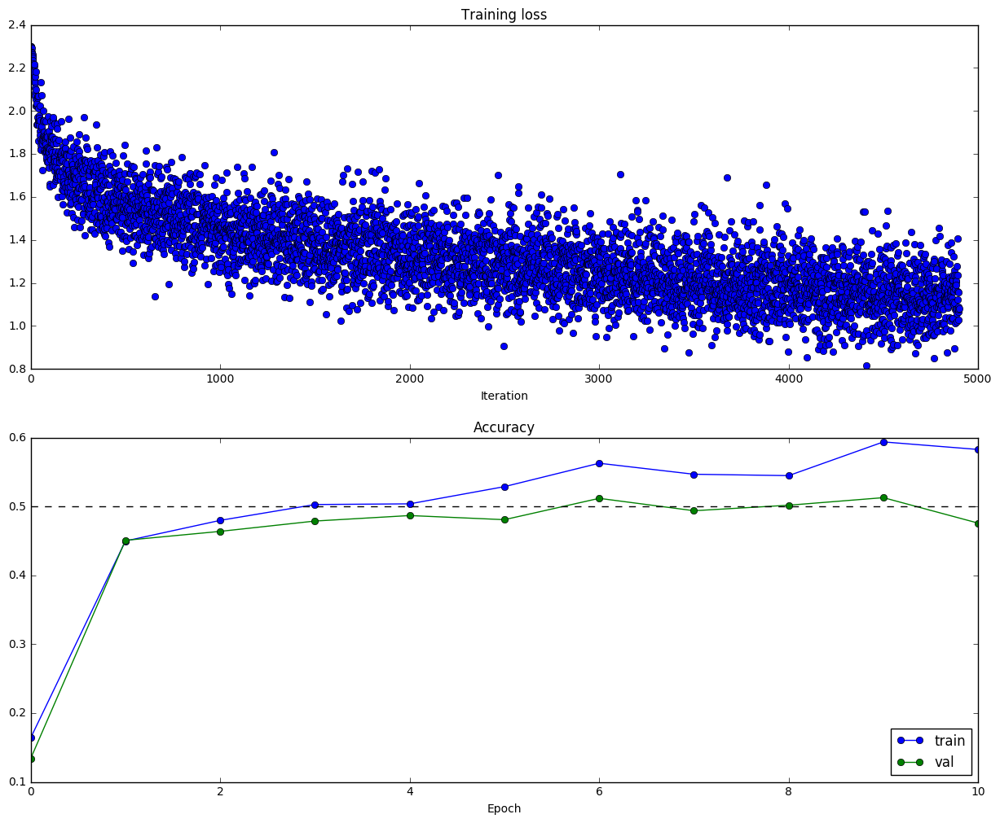

In [0]:
# Run this cell to visualize training loss and train / val accuracy

plt.subplot(2, 1, 1)
plt.title('Training loss')
plt.plot(solver.loss_history, 'o')
plt.xlabel('Iteration')

plt.subplot(2, 1, 2)
plt.title('Accuracy')
plt.plot(solver.train_acc_history, '-o', label='train')
plt.plot(solver.val_acc_history, '-o', label='val')
plt.plot([0.5] * len(solver.val_acc_history), 'k--')
plt.xlabel('Epoch')
plt.legend(loc='lower right')
plt.gcf().set_size_inches(15, 12)
plt.show()

# Multilayer network
Next you will implement a fully-connected network with an arbitrary number of hidden layers.

Read through the `FullyConnectedNet` class in the file `cs231n/classifiers/fc_net.py`.

Implement the initialization, the forward pass, and the backward pass. For the moment don't worry about implementing dropout or batch normalization; we will add those features soon.

## Initial loss and gradient check

As a sanity check, run the following to check the initial loss and to gradient check the network both with and without regularization. Do the initial losses seem reasonable?

For gradient checking, you should expect to see errors around 1e-6 or less.

In [0]:
np.random.seed(231)
N, D, H1, H2, C = 2, 15, 20, 30, 10
X = np.random.randn(N, D)
y = np.random.randint(C, size=(N,))

for reg in [0, 3.14]:
  print('Running check with reg = ', reg)
  model = FullyConnectedNet([H1, H2], input_dim=D, num_classes=C,
                            reg=reg, weight_scale=5e-2, dtype=np.float64)

  loss, grads = model.loss(X, y)
  print('Initial loss: ', loss)

  for name in sorted(grads):
    f = lambda _: model.loss(X, y)[0]
    grad_num = eval_numerical_gradient(f, model.params[name], verbose=False, h=1e-5)
    print('%s relative error: %.2e' % (name, rel_error(grad_num, grads[name])))

Running check with reg =  0
Initial loss:  2.30047908977
W1 relative error: 1.48e-07
W2 relative error: 2.21e-05
W3 relative error: 3.53e-07
b1 relative error: 5.38e-09
b2 relative error: 2.09e-09
b3 relative error: 5.80e-11
Running check with reg =  3.14
Initial loss:  7.05211477653
W1 relative error: 7.36e-09
W2 relative error: 6.87e-08
W3 relative error: 3.48e-08
b1 relative error: 1.48e-08
b2 relative error: 1.72e-09
b3 relative error: 1.80e-10


As another sanity check, make sure you can overfit a small dataset of 50 images. First we will try a three-layer network with 100 units in each hidden layer. You will need to tweak the learning rate and initialization scale, but you should be able to overfit and achieve 100% training accuracy within 20 epochs.

data['X_train'] : [[[[ -71.64189796  -87.05569388  -80.96055102 ...   27.08416327
      21.74489796   17.94502041]
   [-114.02414286 -129.26055102 -112.13655102 ...   -6.92971429
     -10.2192449    -7.05363265]
   [-104.66336735 -112.65646939  -80.41834694 ...  -11.12879592
      -8.51010204  -19.51812245]
   ...
   [  81.46373469   76.43038776   74.09187755 ...   35.71895918
     -68.71422449  -72.54308163]
   [  52.94057143   47.55583673   60.7444898  ...   58.46567347
     -28.6054898   -43.01536735]
   [  49.26402041   41.41073469   52.14669388 ...   89.1964898
      24.43428571   -3.64218367]]

  [[ -73.98173469  -89.34804082  -88.14328571 ...   -4.17532653
     -10.5802449   -11.36534694]
   [-115.21683673 -134.36308163 -127.08104082 ...  -47.03577551
     -51.456       -47.29195918]
   [-110.58489796 -126.42697959 -106.98687755 ...  -49.88912245
     -49.47059184  -60.49834694]
   ...
   [  44.06446939   29.28759184   38.21993878 ...    9.95071429
     -92.77730612  -90.8947551

 (100, 100)
x.shape : (100, 100)
w.shape : (100, 10)
b.shape : (10,)
out : [[ 1.22123418e-01  9.16508991e-02 -3.19363510e-03 -7.99623675e-02
  -2.32233208e-01 -4.01619993e-02  3.01339338e-02  8.40917334e-02
  -8.32808388e-02  1.14549020e-01]
 [ 7.38775330e-02  2.57880835e-01  2.21251258e-01 -1.02954077e-01
   6.26802484e-02 -2.15733893e-01  1.02271905e-01  1.77857175e-01
   2.45467310e-01  1.63403666e-01]
 [ 2.47964383e-01  9.85486491e-02 -3.29716785e-02 -1.60886010e-01
   2.82249590e-02 -1.16134928e-01  7.34401845e-02  1.77517251e-01
   1.93140811e-01  2.37929163e-01]
 [ 1.23717843e-01  1.97296665e-01 -1.01835080e-02 -2.01465335e-01
   1.77123479e-01  4.54247883e-02 -2.03830825e-01  2.69185439e-02
  -4.75651843e-02  9.69396259e-03]
 [ 1.29827285e-01  4.65157312e-01  1.04663365e-02 -1.73800583e-02
   2.36307485e-03 -6.30148655e-02  9.96096505e-02  7.33226963e-02
  -4.93557894e-02  8.51658085e-02]
 [ 2.30459958e-01 -3.75725368e-01 -1.55743156e-01 -4.89801978e-01
   5.01142600e-01 -1.606


relu_forward_out.shape : (25, 100)
x.shape : (25, 100)
w.shape : (100, 100)
b.shape : (100,)
out : [[-0.64759357  0.47781009  2.20261393 ... -0.37315328 -1.49937517
  -0.22840979]
 [ 0.64430751  4.78880222  2.44090555 ... -0.83436023  1.51818179
  -2.06309953]
 [-2.91524658  6.16965241  0.56554213 ... -7.27403484 -2.45739889
  -1.94845391]
 ...
 [-4.12435251  1.20415222  3.39268279 ... -5.04925451  2.54308032
  -1.89687817]
 [-2.91724053  1.68166061  4.15692314 ... -2.97748204  3.61641837
   0.34781926]
 [-4.36382093  5.64423463  4.8074535  ... -0.26409454  2.16826349
   0.96254696]]
out.shape : (25, 100)
relu_forward_out : [[0.         0.47781009 2.20261393 ... 0.         0.         0.        ]
 [0.64430751 4.78880222 2.44090555 ... 0.         1.51818179 0.        ]
 [0.         6.16965241 0.56554213 ... 0.         0.         0.        ]
 ...
 [0.         1.20415222 3.39268279 ... 0.         2.54308032 0.        ]
 [0.         1.68166061 4.15692314 ... 0.         3.61641837 0.3478192

[[ 4.79830643e-01  2.26915890e-01  7.57973873e-02 -8.40886768e-02
   1.08028888e-01  2.10051260e-02  1.58446151e-01  7.12151802e-02
  -7.67824642e-02  3.88748214e-02]
 [-5.74623630e-02  2.15195956e-01  6.82922478e-02 -4.26828926e-02
   7.65278073e-02  2.77900834e-02  5.82040507e-02  4.49399922e-02
  -5.83553347e-02  9.63354269e-02]
 [ 2.11053946e-01  3.05329131e-01 -6.14651733e-02 -1.51006787e-01
   4.63088215e-02  1.37421432e-01  3.83935573e-02  2.23133628e-01
  -5.22712445e-02  2.71945864e-01]
 [ 1.34351391e-02  8.87471118e-02  3.37530398e-02 -1.10551646e-01
   2.55243820e-01 -1.87649552e-01  1.31145529e-01  1.32900902e-01
  -6.33505933e-02  2.82560830e-02]
 [ 1.02750750e-01 -8.25496675e-02 -3.59646960e-02 -1.64460854e-01
   1.55267402e-02 -1.13630476e-02  1.52460486e-01  2.14450642e-02
  -1.99825848e-01 -8.13169042e-03]
 [ 6.02540430e-01 -6.65762403e-01  3.27118445e-01 -7.05733141e-01
   8.18627780e-01 -2.38024477e-01 -3.28875508e-01  2.70725399e-02
  -3.09302280e-02  3.31306325e-01

[[ 6.52184898e-01 -1.90735048e-01  5.80435329e-02  1.43156527e-01
   3.45860032e-01 -6.45917892e-01 -3.79382121e-01  1.38052883e-01
  -3.11758793e-01  5.54629222e-01]
 [ 1.05878894e+00 -1.17144910e+00  6.79954604e-01  1.72818473e-01
   1.66537311e+00 -1.15807118e+00 -9.63441193e-01  3.79549151e-01
  -6.67761952e-01  3.55951448e-01]
 [ 6.27768734e-02 -6.12777391e-02  3.30413689e-02  9.47200192e-02
   4.89324096e-02 -1.55266708e-01 -8.32133296e-02 -1.96819514e-02
  -7.01112758e-02  1.14924060e-01]
 [ 1.46012820e-01  2.22137600e-01  3.76823199e-01  2.86462924e-01
  -4.25272916e-02 -2.94758771e-01  1.29569763e-01  1.94414252e-01
  -9.13429529e-02 -4.98227683e-02]
 [ 9.91310599e-02  3.15758349e-01  1.07301146e-01  2.79453596e-01
   2.53253657e-02 -2.83324265e-01 -5.64657291e-02  1.41925264e-01
  -2.17033335e-01  1.33867037e-01]
 [ 2.06718609e-01  2.39078089e-02 -1.89104948e-01  4.72479764e-01
  -1.62779237e-01 -3.45622534e-01  1.09275707e-01  5.98263380e-01
  -4.31962854e-01  1.41652343e-01

[[ 3.73740276e-01 -1.28898683e-01  1.56999865e-01  1.21015896e-01
   3.75288225e-01 -3.53936667e-01 -2.54297981e-01  5.73375215e-02
  -3.50393020e-01  1.25879875e-01]
 [ 6.59183641e-01 -2.83056203e-01  6.39965687e-01  2.15511958e-01
   5.27529840e-01 -6.15628391e-01 -2.72985186e-02  4.80675392e-01
  -3.11584317e-01 -8.55217637e-02]
 [ 1.00555702e-01  3.59292985e-01  1.02632576e-01  6.12366966e-01
   2.56933587e-01 -6.01286300e-01  3.63889664e-01  2.67902920e-01
  -5.86396768e-01 -2.02297311e-01]
 [-3.07842431e-02  6.44156529e-01  9.28008619e-02  5.12546842e-01
   1.06992385e-01 -4.37976958e-01  1.77484772e-01  9.05990982e-02
  -4.96213826e-01 -5.12279477e-02]
 [-1.24410387e-01  2.78220691e-01 -3.87728285e-02  8.16712258e-01
   2.70896219e-01 -4.62498363e-01  4.15682270e-01  1.85028944e-01
  -7.74651379e-01 -2.45026928e-01]
 [ 8.19511070e-01 -3.43849840e-01 -1.08227262e-01  5.75702406e-01
   3.72410511e-01 -1.05256626e+00 -5.49057975e-01  4.19908620e-01
  -6.52732844e-01  7.43989759e-01

[[ 1.62178422e+00 -6.31359831e-01  4.08007371e-01  1.59953585e-01
  -3.27895479e-03 -5.44581882e-01 -5.38061245e-01 -1.67021084e-01
  -6.38676437e-01  8.69028885e-01]
 [ 2.28096270e+00 -1.28841598e+00  2.03004727e+00 -5.48053206e-01
   1.05963013e+00 -1.23195630e+00 -1.08360818e+00 -3.01702691e-01
  -1.00914666e+00  4.37706571e-01]
 [ 1.84735788e-01  2.33581883e-01  3.24437498e-01  2.31556287e-01
   7.29490177e-03 -3.80024071e-01  2.72893403e-01  1.33627099e-01
  -5.97979009e-01  1.05650750e-01]
 [ 3.25767974e-03  3.14418194e-01  8.50988588e-01  4.85684577e-01
  -2.06727847e-02 -6.88078472e-01  9.27838106e-01  2.75781155e-02
  -6.60048395e-01 -4.88702922e-01]
 [ 4.51402297e-01  4.82672199e-01  7.46264187e-01  1.08049568e-01
   5.24463116e-01 -7.52275401e-01  5.16679917e-01  1.20994861e-01
  -7.16352747e-01 -1.18732849e-01]
 [ 1.09918214e+00 -2.87702186e-02 -9.75087135e-02  2.70569346e-01
   7.82658179e-03 -3.88179616e-01 -2.45942985e-01  9.56611946e-02
  -6.44238842e-01  9.14227834e-01


out.shape : (100, 100)
relu_forward_out : [[21.25124543 21.76069253  5.95154874 ...  0.         12.46470647
   0.        ]
 [56.95279673  5.87707105  0.         ...  0.44668018  0.
  32.5423    ]
 [ 0.          0.         16.16861549 ...  0.          0.
   0.        ]
 ...
 [37.68204708  0.          0.         ... 27.18119158  0.
   0.        ]
 [ 0.         27.64888655  0.         ...  0.71909127  0.
  21.45442593]
 [48.42953837  1.63195395  0.         ... 45.93411356  0.71993477
   0.        ]]
relu_forward_out.shape : (100, 100)
x.shape : (100, 100)
w.shape : (100, 100)
b.shape : (100,)
out : [[-0.5525781   2.60396021  3.67363792 ... -3.2484312  -0.22151352
  -2.34059571]
 [-0.45508879  2.3628299   4.24101419 ...  0.51927706  4.35461993
  -1.57726213]
 [ 0.61879205  4.87666549  2.04926319 ... -5.69340575  4.40015134
  -2.72619069]
 ...
 [-0.19504133 11.24821192  2.1530037  ... -1.30763711 11.73728295
   3.54038913]
 [ 0.37498091  2.93734243  7.92249711 ... -5.25772695  8.10749032
 

 [[18.02280618  0.         21.46494773 ...  0.          8.13141129
  31.79484933]
 [49.43127093  0.         34.99558776 ... 40.20363812  0.
   4.32975184]
 [ 0.          7.94881336  0.         ...  0.          0.
  61.96937872]
 ...
 [ 0.54590391 61.93453168  6.05644443 ...  0.         58.5372865
  17.72403059]
 [95.32808106  0.         27.69460891 ... 39.83855077 12.85759457
   0.        ]
 [11.94692788  0.         28.97243492 ...  0.          5.36345206
  14.54297018]]
relu_forward_out.shape : (100, 100)
x.shape : (100, 100)
w.shape : (100, 100)
b.shape : (100,)
out : [[-1.90814915e-01  6.33753022e+00  3.53304725e+00 ...  6.99896344e-01
   1.41767538e+00 -1.95184296e+00]
 [-7.94056981e-03  1.16936773e+01  5.50081844e+00 ... -8.13060450e+00
   4.83606439e+00 -7.71061970e-02]
 [ 1.31714662e+00 -1.89606135e+00  1.32855747e+00 ...  1.73041984e-01
   2.08767373e+00  1.28106867e-01]
 ...
 [ 1.29175812e+00  3.23086253e+00  2.57635076e+00 ... -7.82534472e-02
  -1.49377045e+00 -5.18397323e+00

[[-8.84792696e-02  1.80452460e-01  6.91716114e-01  6.98835421e-01
  -5.94839451e-01 -2.41523560e-01  5.53945470e-01  2.12842607e-01
  -8.32907960e-01 -4.22850838e-01]
 [-1.91942970e-01  7.63805483e-01  5.66351126e-01  3.28061283e-01
  -3.16628938e-01 -4.18333601e-01 -9.78915083e-02  3.47887894e-01
  -4.43311148e-01  2.94397311e-01]
 [ 4.20775918e-01  4.07264250e-01  1.06569145e+00  4.41950839e-01
  -3.62175007e-01 -3.73150742e-01 -3.64622131e-01  4.67394134e-01
  -8.45010980e-01  6.93519321e-02]
 [ 4.41998864e-01 -1.90005138e-01  6.55794149e-01  3.15604852e-01
   1.19155232e-01 -3.57553628e-01 -5.86274999e-01  1.02725320e+00
  -8.53518105e-01 -3.04025502e-01]
 [-4.31728206e-01  1.17233053e+00  9.21934423e-01  1.16137747e+00
  -1.87121389e-01 -2.74364649e-01  4.13591619e-01 -5.17208278e-01
  -1.09924786e+00 -2.87354646e-01]
 [ 1.15257597e+00 -1.43872481e+00  3.05992774e+00  2.74136657e-01
   6.65611619e-02 -1.28548349e+00 -1.68846161e+00  1.10568374e+00
  -1.34588092e+00 -6.20268236e-01

[[ 5.52694524e-01 -3.84965112e-01  1.55765592e+00  1.57301032e-01
   1.59868956e-02 -6.41712548e-01 -5.59587931e-01  7.13414440e-01
  -8.57767605e-01 -3.57468349e-01]
 [ 8.97627185e-01 -7.65559029e-01  3.69195723e+00  4.67657171e-01
  -4.41348502e-01 -1.35224907e+00  1.74026834e-03  1.49462340e+00
  -1.33681666e+00 -1.24707593e+00]
 [-4.62725480e-01  8.05270749e-01  1.37906052e+00  1.04580876e+00
  -1.38593496e-01 -6.23021017e-01  8.44313021e-01 -8.38389700e-02
  -1.30443392e+00 -6.65728509e-01]
 [-5.97885254e-01  1.61168303e+00  1.30560064e+00  1.27104105e+00
  -4.05861904e-01 -6.43066410e-01  5.61660440e-01 -5.26193990e-01
  -1.36387042e+00 -1.22246874e-01]
 [-8.18514442e-01  5.92256264e-01  1.34640311e+00  1.50409437e+00
  -1.32936525e-01 -3.39706791e-01  1.00542848e+00 -8.89583973e-02
  -1.65528866e+00 -8.88365580e-01]
 [ 9.61576581e-01 -4.56514056e-01  6.42619829e-01  1.56048653e+00
  -1.15130452e+00 -1.12526307e+00 -1.78389490e+00  1.32942148e+00
  -1.71628062e+00  1.88123537e+00

[[ 1.40451663e+00  2.85087838e-01  4.43096811e-02  4.80793771e-01
  -3.57131545e-01 -1.12305142e+00 -7.93620191e-01  1.67673803e-01
  -1.12363077e+00  1.52048115e+00]
 [ 4.03452582e+00 -2.72207570e+00  3.56281665e+00  2.46903718e-02
   1.69082171e+00 -2.69973501e+00 -1.64288235e+00  1.67863962e+00
  -2.62411018e+00 -1.52753415e+00]
 [ 1.06081920e-01  8.72415085e-02  4.93712674e-04  2.71239274e-01
  -7.03337805e-02 -2.49144792e-01 -1.36859377e-01 -7.35258787e-02
  -3.21186659e-01  3.28128450e-01]
 [-1.15020567e-03  8.81563343e-01  1.47951683e+00  4.66947774e-01
  -3.62668984e-01 -7.23344789e-01  1.38020652e+00  1.13766644e-01
  -7.50350805e-01 -7.63324098e-01]
 [-1.78650092e-01  1.20408665e+00  9.29862028e-01  4.72546102e-01
  -2.45264977e-01 -6.94600692e-01  7.24900229e-01 -3.19905437e-01
  -1.05335012e+00  9.05515555e-02]
 [ 1.53860496e-01  3.53857623e-01 -1.93600437e-02  8.76163934e-01
  -3.95783528e-01 -2.81519633e-01  1.07060971e+00  8.00265828e-01
  -1.22966464e+00 -4.01884290e-01


b.shape : (100,)
out : [[ 0.29674776  2.30367691  1.08971594 ... -2.50772752  2.43609316
  -1.72399093]
 [-1.41006301  5.78155495  3.06705649 ... -0.16344179  5.9893695
  -1.36210105]
 [-1.74233282  2.27084752  4.72296195 ... -3.86483251  8.45442548
   0.53675087]
 ...
 [-1.26144332  0.95606419  4.25727256 ... -1.42061044 -0.39578613
   0.2015671 ]
 [-5.364382    0.90870786 10.49473759 ... -7.95125914 15.26275554
   0.62605904]
 [-1.97108348  0.93369388  7.6820816  ... -5.25281299  7.03308598
   0.4654592 ]]
out.shape : (100, 100)
relu_forward_out : [[ 0.29674776  2.30367691  1.08971594 ...  0.          2.43609316
   0.        ]
 [ 0.          5.78155495  3.06705649 ...  0.          5.9893695
   0.        ]
 [ 0.          2.27084752  4.72296195 ...  0.          8.45442548
   0.53675087]
 ...
 [ 0.          0.95606419  4.25727256 ...  0.          0.
   0.2015671 ]
 [ 0.          0.90870786 10.49473759 ...  0.         15.26275554
   0.62605904]
 [ 0.          0.93369388  7.6820816  ... 


w.shape : (100, 10)
b.shape : (10,)
out : [[ 1.03370223e+00 -1.45571995e+00  3.23381256e+00  9.01728945e-01
   3.84503116e-01 -1.64158760e+00  8.00083852e-01  3.51445340e-01
  -1.92130883e+00 -9.06496157e-01]
 [-3.84739405e-01 -7.14737700e-01 -4.90386559e-02  1.67489303e+00
  -5.51615204e-01 -6.47308045e-01  1.83681583e+00  1.76693683e-01
  -1.24792199e+00  7.68761585e-01]
 [ 1.03370223e+00 -1.45571995e+00  3.23381256e+00  9.01728945e-01
   3.84503116e-01 -1.64158760e+00  8.00083852e-01  3.51445340e-01
  -1.92130883e+00 -9.06496157e-01]
 [-8.77137972e-01 -1.42697507e-01  3.76137109e-01  7.20391398e-01
  -4.37870440e-01 -6.80934104e-01  1.41587816e+00  1.43075097e+00
  -9.51923762e-01 -2.27548988e-01]
 [-8.85074941e-01  5.10616381e-01  8.99998631e-01  2.71701404e+00
  -6.15470603e-01 -1.23323047e+00  4.19743263e+00 -5.98982741e-01
  -2.02612258e+00 -9.27316337e-01]
 [ 3.68879113e+00 -2.05192915e+00  6.17040309e-01  8.83061123e-01
  -6.99812089e-01 -2.42487293e+00  7.96403407e-01  2.068

 [[-59.2298762   73.20224204   3.06169157 ...   6.40355917  26.1719281
    8.31759571]
 [ -9.83793642  52.95472069  -9.00561559 ...  -1.12779601 -57.16510948
    7.60889111]
 [ 24.14470388 -28.31648705  -6.93323227 ... -18.1058756   -7.1149143
    4.26962319]
 ...
 [ -2.97392051 -71.8834515    0.27009972 ...  37.49351044 -44.82433698
  -35.39430385]
 [ 46.91407361  84.61711126  67.77472821 ... -27.20060244  13.17963013
  -15.17502473]
 [-35.22538852 -40.06359541  43.18165874 ...  27.97749038 -55.87337272
  -17.25680462]]
out.shape : (100, 100)
relu_forward_out : [[ 0.         73.20224204  3.06169157 ...  6.40355917 26.1719281
   8.31759571]
 [ 0.         52.95472069  0.         ...  0.          0.
   7.60889111]
 [24.14470388  0.          0.         ...  0.          0.
   4.26962319]
 ...
 [ 0.          0.          0.27009972 ... 37.49351044  0.
   0.        ]
 [46.91407361 84.61711126 67.77472821 ...  0.         13.17963013
   0.        ]
 [ 0.          0.         43.18165874 ... 27.9

[[-7.42056690e-01  5.80441848e-02  1.25066771e+00  2.04329670e+00
  -4.34753447e-01 -1.18139972e+00  2.74103030e+00 -1.58333340e-01
  -2.05706612e+00 -5.64068785e-01]
 [-2.26463674e-01  8.94277633e-01 -4.05321352e-01  8.56921959e-01
  -2.89711315e-01 -7.91660209e-01  1.04393751e+00  6.56537137e-01
  -7.51034080e-01  4.04194296e-01]
 [-1.03166728e-01  1.35390550e+00 -3.82855747e-01  9.30001376e-01
  -7.06420438e-01 -3.82111919e-01  7.03404118e-01 -4.44657913e-02
  -8.01240176e-01  5.94797355e-01]
 [-7.92501130e-02  1.03788530e-01  9.77644165e-01  3.29527442e-01
   1.48381669e-01 -7.98936802e-01  2.68366246e-01  1.32448841e-01
  -6.10136420e-01 -6.99739847e-02]
 [-1.31087548e-01 -4.58431458e-01  1.35427954e+00  8.52733503e-01
  -4.41565068e-01 -7.41019668e-01  1.50867819e+00  7.98047593e-01
  -1.02718988e+00 -6.00667729e-01]
 [ 1.29831783e-01  6.95016815e-01  5.57679354e-01  3.09012131e-02
  -9.17878241e-01 -1.08724472e+00  1.21385260e+00  1.43635711e+00
  -1.35348079e+00  1.22437016e+00

[[-0.84429843  0.21570868  0.53290226  1.26077661  1.40823023 -0.71553842
   2.79040373 -0.20662854 -1.84587749 -1.02549849]
 [-0.75532814  0.62762487 -1.36663443  1.07037862 -0.4068685  -1.04636011
  -0.25724797 -0.27452052 -0.657427    4.10184588]
 [-0.79465428 -0.1000311  -1.37919831  0.22852536 -0.28831623 -0.82649558
  -0.71072522  2.83873522 -1.6915434   5.13096617]
 [-0.29441609  0.95512748  0.15083364  0.45720865  1.64517266 -0.19849077
   0.41805103 -0.62988054 -1.11326081 -0.4668588 ]
 [-0.89865332  4.39057824 -0.59042655 -0.45904232 -0.66480337 -0.86624189
  -0.19047448  0.45249468 -0.91311528  1.24421275]
 [-0.47240601  1.08299644  0.36098471  0.85771053  1.09018863 -0.42017873
   1.12478057 -0.15894462 -1.63526044 -0.29967728]
 [-0.27857787  0.53187032  2.59775716 -0.5113004   0.69545558 -1.37637881
   0.49421769 -0.1278869  -1.57628108 -0.60951452]
 [ 0.1874453  -1.04046358  0.39936706 -1.06217705  1.02719321 -1.34537311
   0.58099782  4.70798873 -1.40670286 -1.14102487]


您的笔记本大小接近上限 (19.5M)。较大的新输出项可能会被舍弃。目前已舍弃 2.8M 个输出项。 

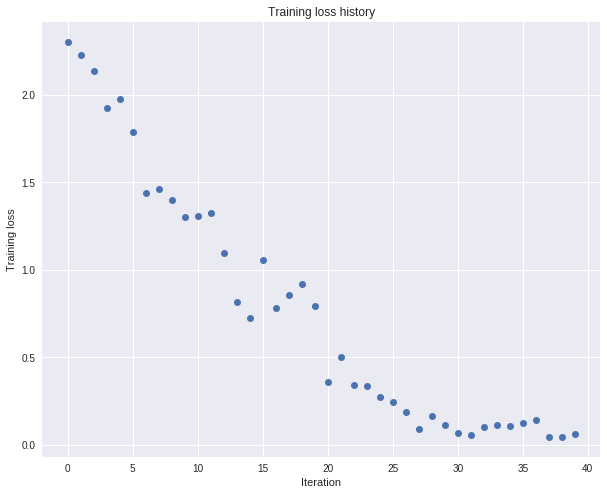

In [13]:
# TODO: Use a three-layer Net to overfit 50 training examples.

num_train = 50
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}
print("data['X_train'] :",data['X_train'])
print("small_data['X_train'] :",small_data['X_train'])
weight_scale = 1e-2
learning_rate = 8e-3
# add batch and dropout in this model
model = FullyConnectedNet([100, 100],
              weight_scale=weight_scale, dtype=np.float64)
solver = Solver(model, small_data,
                print_every=10, num_epochs=20, batch_size=25,
                update_rule='sgd',
                optim_config={
                  'learning_rate': learning_rate,
                }
         )
solver.train()

plt.plot(solver.loss_history, 'o')
plt.title('Training loss history')
plt.xlabel('Iteration')
plt.ylabel('Training loss')
plt.show()

Now try to use a five-layer network with 100 units on each layer to overfit 50 training examples. Again you will have to adjust the learning rate and weight initialization, but you should be able to achieve 100% training accuracy within 20 epochs.

(Iteration 1 / 40) loss: 139.150523
(Epoch 0 / 20) train acc: 0.220000; val_acc: 0.087000
(Epoch 1 / 20) train acc: 0.180000; val_acc: 0.110000
(Epoch 2 / 20) train acc: 0.320000; val_acc: 0.125000
(Epoch 3 / 20) train acc: 0.520000; val_acc: 0.137000
(Epoch 4 / 20) train acc: 0.560000; val_acc: 0.123000
(Epoch 5 / 20) train acc: 0.680000; val_acc: 0.130000
(Iteration 11 / 40) loss: 2.793172
(Epoch 6 / 20) train acc: 0.820000; val_acc: 0.133000
(Epoch 7 / 20) train acc: 0.920000; val_acc: 0.147000
(Epoch 8 / 20) train acc: 0.980000; val_acc: 0.149000
(Epoch 9 / 20) train acc: 0.980000; val_acc: 0.149000
(Epoch 10 / 20) train acc: 0.980000; val_acc: 0.150000
(Iteration 21 / 40) loss: 0.001506
(Epoch 11 / 20) train acc: 1.000000; val_acc: 0.149000
(Epoch 12 / 20) train acc: 1.000000; val_acc: 0.149000
(Epoch 13 / 20) train acc: 1.000000; val_acc: 0.149000
(Epoch 14 / 20) train acc: 1.000000; val_acc: 0.148000
(Epoch 15 / 20) train acc: 1.000000; val_acc: 0.148000
(Iteration 31 / 40) loss

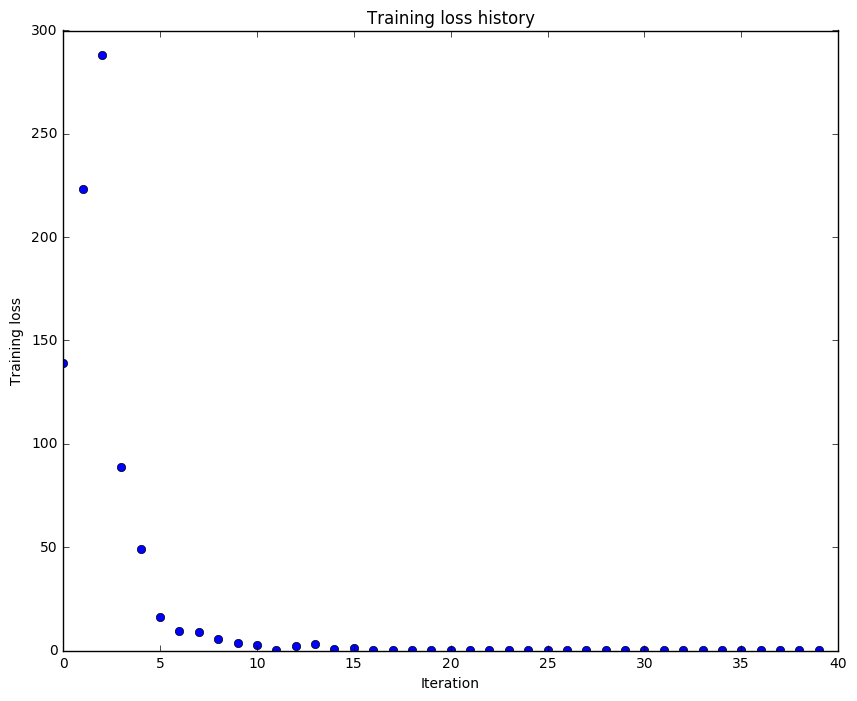

In [0]:
# TODO: Use a five-layer Net to overfit 50 training examples.

num_train = 50
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

weight_scale = 1e-1
learning_rate = 1e-3

model = FullyConnectedNet([100, 100, 100, 100],
                weight_scale=weight_scale, dtype=np.float64)
solver = Solver(model, small_data,
                print_every=10, num_epochs=20, batch_size=25,
                update_rule='sgd',
                optim_config={
                  'learning_rate': learning_rate,
                }
         )
solver.train()

plt.plot(solver.loss_history, 'o')
plt.title('Training loss history')
plt.xlabel('Iteration')
plt.ylabel('Training loss')
plt.show()

# Inline question: 
Did you notice anything about the comparative difficulty of training the three-layer net vs training the five layer net?

# Answer:
[FILL THIS IN]
While I tuning the hyperparameters of the five layer, I find the min loss is more sensitive to the weight_scale which make the loss function converge to a local minimum easily. I think this phenomenon happened beacause the high capacity of the five layer also make the five layer net's loss function more complex and harder to optimal domain than the three layer net and much more sensitive to initialization.

# Update rules
So far we have used vanilla stochastic gradient descent (SGD) as our update rule. More sophisticated update rules can make it easier to train deep networks. We will implement a few of the most commonly used update rules and compare them to vanilla SGD.

# SGD+Momentum
Stochastic gradient descent with momentum is a widely used update rule that tends to make deep networks converge faster than vanilla stochstic gradient descent.

Open the file `cs231n/optim.py` and read the documentation at the top of the file to make sure you understand the API. Implement the SGD+momentum update rule in the function `sgd_momentum` and run the following to check your implementation. You should see errors less than 1e-8.

In [0]:
from cs231n.optim import sgd_momentum

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
v = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-3, 'velocity': v}
next_w, _ = sgd_momentum(w, dw, config=config)

expected_next_w = np.asarray([
  [ 0.1406,      0.20738947,  0.27417895,  0.34096842,  0.40775789],
  [ 0.47454737,  0.54133684,  0.60812632,  0.67491579,  0.74170526],
  [ 0.80849474,  0.87528421,  0.94207368,  1.00886316,  1.07565263],
  [ 1.14244211,  1.20923158,  1.27602105,  1.34281053,  1.4096    ]])
expected_velocity = np.asarray([
  [ 0.5406,      0.55475789,  0.56891579, 0.58307368,  0.59723158],
  [ 0.61138947,  0.62554737,  0.63970526,  0.65386316,  0.66802105],
  [ 0.68217895,  0.69633684,  0.71049474,  0.72465263,  0.73881053],
  [ 0.75296842,  0.76712632,  0.78128421,  0.79544211,  0.8096    ]])

print('next_w error: ', rel_error(next_w, expected_next_w))
print('velocity error: ', rel_error(expected_velocity, config['velocity']))

next_w error:  8.88234703351e-09
velocity error:  4.26928774328e-09


Once you have done so, run the following to train a six-layer network with both SGD and SGD+momentum. You should see the SGD+momentum update rule converge faster.

running with  sgd
(Iteration 1 / 200) loss: 3.172982
(Epoch 0 / 5) train acc: 0.121000; val_acc: 0.106000
(Iteration 11 / 200) loss: 2.256368
(Iteration 21 / 200) loss: 2.180894
(Iteration 31 / 200) loss: 2.098789
(Epoch 1 / 5) train acc: 0.271000; val_acc: 0.240000
(Iteration 41 / 200) loss: 2.080658
(Iteration 51 / 200) loss: 2.040536
(Iteration 61 / 200) loss: 1.829603
(Iteration 71 / 200) loss: 1.883715
(Epoch 2 / 5) train acc: 0.315000; val_acc: 0.293000
(Iteration 81 / 200) loss: 1.943460
(Iteration 91 / 200) loss: 1.901979
(Iteration 101 / 200) loss: 1.827220
(Iteration 111 / 200) loss: 1.811500
(Epoch 3 / 5) train acc: 0.349000; val_acc: 0.294000
(Iteration 121 / 200) loss: 1.768563
(Iteration 131 / 200) loss: 1.965277
(Iteration 141 / 200) loss: 1.702832
(Iteration 151 / 200) loss: 1.699803
(Epoch 4 / 5) train acc: 0.360000; val_acc: 0.315000
(Iteration 161 / 200) loss: 1.793433
(Iteration 171 / 200) loss: 1.659870
(Iteration 181 / 200) loss: 1.791729
(Iteration 191 / 200) los

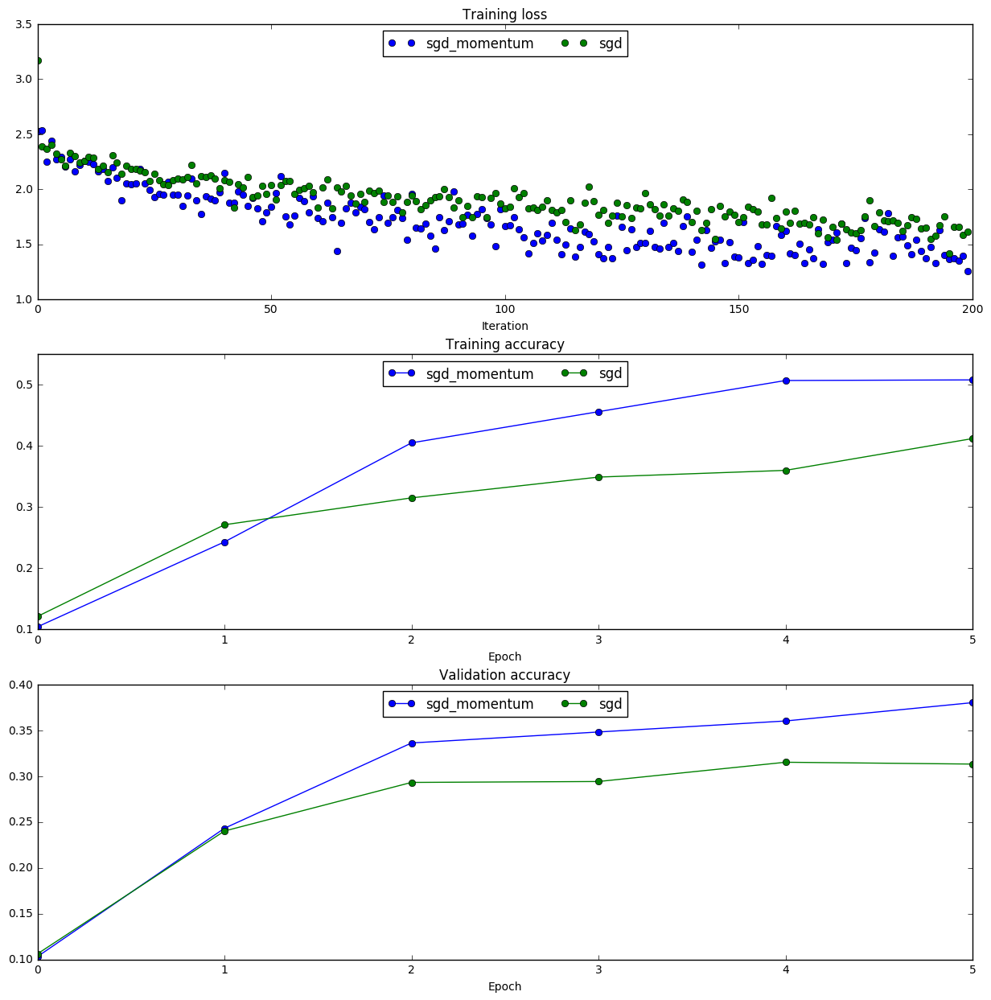

In [0]:
num_train = 4000
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

solvers = {}

for update_rule in ['sgd', 'sgd_momentum']:
  print('running with ', update_rule)
  model = FullyConnectedNet([100, 100, 100, 100, 100], weight_scale=5e-2)

  solver = Solver(model, small_data,
                  num_epochs=5, batch_size=100,
                  update_rule=update_rule,
                  optim_config={
                    'learning_rate': 1e-2,
                  },
                  verbose=True)
  solvers[update_rule] = solver
  solver.train()
  print()

plt.subplot(3, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')

plt.subplot(3, 1, 2)
plt.title('Training accuracy')
plt.xlabel('Epoch')

plt.subplot(3, 1, 3)
plt.title('Validation accuracy')
plt.xlabel('Epoch')

for update_rule, solver in list(solvers.items()):
  plt.subplot(3, 1, 1)
  plt.plot(solver.loss_history, 'o', label=update_rule)
  
  plt.subplot(3, 1, 2)
  plt.plot(solver.train_acc_history, '-o', label=update_rule)

  plt.subplot(3, 1, 3)
  plt.plot(solver.val_acc_history, '-o', label=update_rule)
  
for i in [1, 2, 3]:
  plt.subplot(3, 1, i)
  plt.legend(loc='upper center', ncol=4)
plt.gcf().set_size_inches(15, 15)
plt.show()

# RMSProp and Adam
RMSProp [1] and Adam [2] are update rules that set per-parameter learning rates by using a running average of the second moments of gradients.

In the file `cs231n/optim.py`, implement the RMSProp update rule in the `rmsprop` function and implement the Adam update rule in the `adam` function, and check your implementations using the tests below.

[1] Tijmen Tieleman and Geoffrey Hinton. "Lecture 6.5-rmsprop: Divide the gradient by a running average of its recent magnitude." COURSERA: Neural Networks for Machine Learning 4 (2012).

[2] Diederik Kingma and Jimmy Ba, "Adam: A Method for Stochastic Optimization", ICLR 2015.

In [0]:
# Test RMSProp implementation; you should see errors less than 1e-7
from cs231n.optim import rmsprop

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
cache = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-2, 'cache': cache}
next_w, _ = rmsprop(w, dw, config=config)

expected_next_w = np.asarray([
  [-0.39223849, -0.34037513, -0.28849239, -0.23659121, -0.18467247],
  [-0.132737,   -0.08078555, -0.02881884,  0.02316247,  0.07515774],
  [ 0.12716641,  0.17918792,  0.23122175,  0.28326742,  0.33532447],
  [ 0.38739248,  0.43947102,  0.49155973,  0.54365823,  0.59576619]])
expected_cache = np.asarray([
  [ 0.5976,      0.6126277,   0.6277108,   0.64284931,  0.65804321],
  [ 0.67329252,  0.68859723,  0.70395734,  0.71937285,  0.73484377],
  [ 0.75037008,  0.7659518,   0.78158892,  0.79728144,  0.81302936],
  [ 0.82883269,  0.84469141,  0.86060554,  0.87657507,  0.8926    ]])

print('next_w error: ', rel_error(expected_next_w, next_w))
print('cache error: ', rel_error(expected_cache, config['cache']))

next_w error:  9.52468751104e-08
cache error:  2.64779558072e-09


In [0]:
# Test Adam implementation; you should see errors around 1e-7 or less
from cs231n.optim import adam

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
m = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)
v = np.linspace(0.7, 0.5, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-2, 'm': m, 'v': v, 't': 5}
next_w, _ = adam(w, dw, config=config)

expected_next_w = np.asarray([
  [-0.40094747, -0.34836187, -0.29577703, -0.24319299, -0.19060977],
  [-0.1380274,  -0.08544591, -0.03286534,  0.01971428,  0.0722929],
  [ 0.1248705,   0.17744702,  0.23002243,  0.28259667,  0.33516969],
  [ 0.38774145,  0.44031188,  0.49288093,  0.54544852,  0.59801459]])
expected_v = np.asarray([
  [ 0.69966,     0.68908382,  0.67851319,  0.66794809,  0.65738853,],
  [ 0.64683452,  0.63628604,  0.6257431,   0.61520571,  0.60467385,],
  [ 0.59414753,  0.58362676,  0.57311152,  0.56260183,  0.55209767,],
  [ 0.54159906,  0.53110598,  0.52061845,  0.51013645,  0.49966,   ]])
expected_m = np.asarray([
  [ 0.48,        0.49947368,  0.51894737,  0.53842105,  0.55789474],
  [ 0.57736842,  0.59684211,  0.61631579,  0.63578947,  0.65526316],
  [ 0.67473684,  0.69421053,  0.71368421,  0.73315789,  0.75263158],
  [ 0.77210526,  0.79157895,  0.81105263,  0.83052632,  0.85      ]])

print('next_w error: ', rel_error(expected_next_w, next_w))
print('v error: ', rel_error(expected_v, config['v']))
print('m error: ', rel_error(expected_m, config['m']))

next_w error:  0.207207036686
v error:  4.20831403811e-09
m error:  4.21496319311e-09


Once you have debugged your RMSProp and Adam implementations, run the following to train a pair of deep networks using these new update rules:

running with  adam
(Iteration 1 / 200) loss: 2.721424
(Epoch 0 / 5) train acc: 0.134000; val_acc: 0.113000
(Iteration 11 / 200) loss: 2.202307
(Iteration 21 / 200) loss: 2.200554
(Iteration 31 / 200) loss: 2.029114
(Epoch 1 / 5) train acc: 0.348000; val_acc: 0.293000
(Iteration 41 / 200) loss: 1.872584
(Iteration 51 / 200) loss: 1.911158
(Iteration 61 / 200) loss: 1.905196
(Iteration 71 / 200) loss: 1.760092
(Epoch 2 / 5) train acc: 0.357000; val_acc: 0.314000
(Iteration 81 / 200) loss: 1.735753
(Iteration 91 / 200) loss: 1.839110
(Iteration 101 / 200) loss: 1.709435
(Iteration 111 / 200) loss: 1.739040
(Epoch 3 / 5) train acc: 0.404000; val_acc: 0.328000
(Iteration 121 / 200) loss: 1.704484
(Iteration 131 / 200) loss: 1.544026
(Iteration 141 / 200) loss: 1.572505
(Iteration 151 / 200) loss: 1.586239
(Epoch 4 / 5) train acc: 0.431000; val_acc: 0.335000
(Iteration 161 / 200) loss: 1.661597
(Iteration 171 / 200) loss: 1.550715
(Iteration 181 / 200) loss: 1.479263
(Iteration 191 / 200) lo

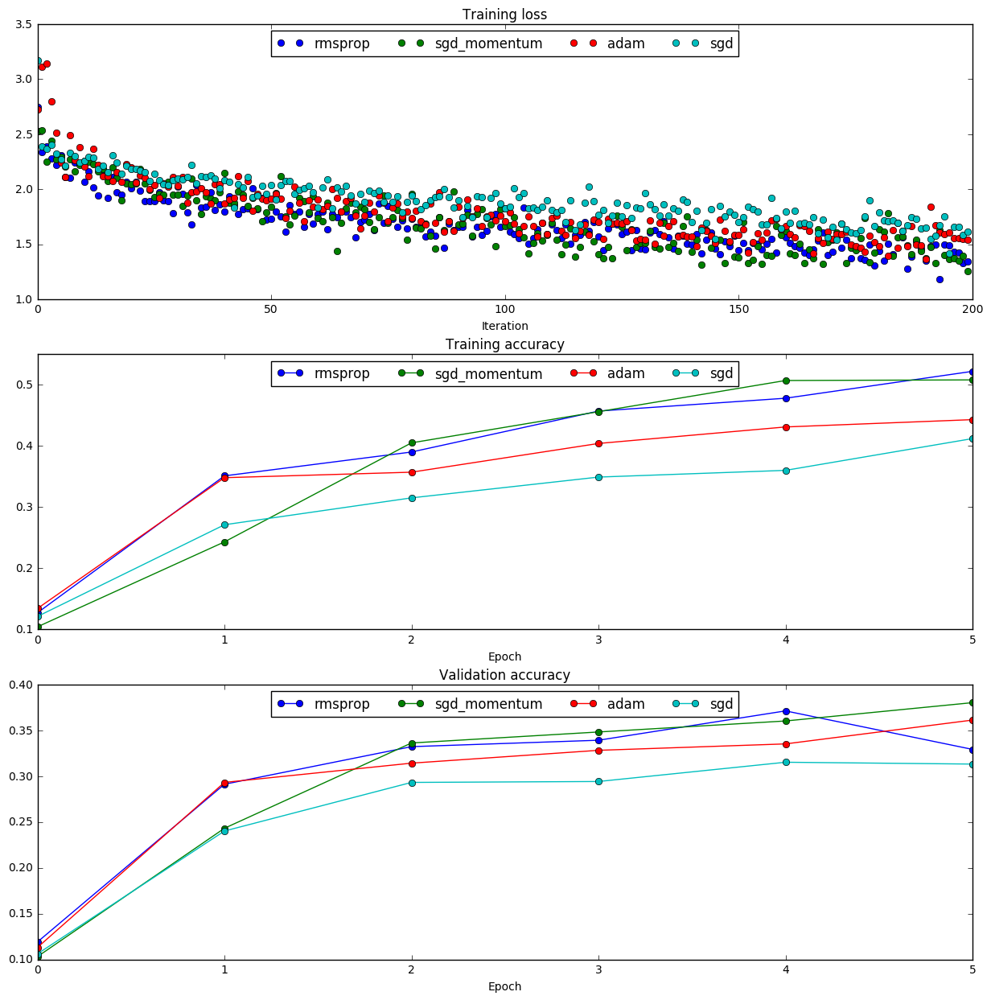

In [0]:
learning_rates = {'rmsprop': 1e-4, 'adam': 1e-3}
for update_rule in ['adam', 'rmsprop']:
  print('running with ', update_rule)
  model = FullyConnectedNet([100, 100, 100, 100, 100], weight_scale=5e-2)

  solver = Solver(model, small_data,
                  num_epochs=5, batch_size=100,
                  update_rule=update_rule,
                  optim_config={
                    'learning_rate': learning_rates[update_rule]
                  },
                  verbose=True)
  solvers[update_rule] = solver
  solver.train()
  print()

plt.subplot(3, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')

plt.subplot(3, 1, 2)
plt.title('Training accuracy')
plt.xlabel('Epoch')

plt.subplot(3, 1, 3)
plt.title('Validation accuracy')
plt.xlabel('Epoch')

for update_rule, solver in list(solvers.items()):
  plt.subplot(3, 1, 1)
  plt.plot(solver.loss_history, 'o', label=update_rule)
  
  plt.subplot(3, 1, 2)
  plt.plot(solver.train_acc_history, '-o', label=update_rule)

  plt.subplot(3, 1, 3)
  plt.plot(solver.val_acc_history, '-o', label=update_rule)
  
for i in [1, 2, 3]:
  plt.subplot(3, 1, i)
  plt.legend(loc='upper center', ncol=4)
plt.gcf().set_size_inches(15, 15)
plt.show()

# Train a good model!
Train the best fully-connected model that you can on CIFAR-10, storing your best model in the `best_model` variable. We require you to get at least 50% accuracy on the validation set using a fully-connected net.

If you are careful it should be possible to get accuracies above 55%, but we don't require it for this part and won't assign extra credit for doing so. Later in the assignment we will ask you to train the best convolutional network that you can on CIFAR-10, and we would prefer that you spend your effort working on convolutional nets rather than fully-connected nets.

You might find it useful to complete the `BatchNormalization.ipynb` and `Dropout.ipynb` notebooks before completing this part, since those techniques can help you train powerful models.

In [1]:
best_model = None
################################################################################
# TODO: Train the best FullyConnectedNet that you can on CIFAR-10. You might   #
# batch normalization and dropout useful. Store your best model in the         #
# best_model variable.                                                         #
################################################################################
weight_scale = 2e-2
learning_rate = 1e-4
update_rule='rmsprop'


model = FullyConnectedNet([600, 500, 400, 300, 200], weight_scale=weight_scale)

solver = Solver(model, data,
                print_every=500, num_epochs=5, batch_size=100,
                update_rule='adam',
                optim_config={
                'learning_rate': learning_rate
                },
                lr_decay=0.9,
                verbose=True)
solver.train()

plt.subplot(3, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')

plt.subplot(3, 1, 2)
plt.title('Training accuracy')
plt.xlabel('Epoch')

plt.subplot(3, 1, 3)
plt.title('Validation accuracy')
plt.xlabel('Epoch')

plt.subplot(3, 1, 1)
plt.plot(solver.loss_history, label=update_rule)
  
plt.subplot(3, 1, 2)
plt.plot(solver.train_acc_history, '-o', label=update_rule)

plt.subplot(3, 1, 3)
plt.plot(solver.val_acc_history, '-o', label=update_rule)
  
for i in [1, 2, 3]:
  plt.subplot(3, 1, i)
  plt.legend(loc='upper center', ncol=4)
plt.gcf().set_size_inches(15, 15)
plt.show()

best_model = model

################################################################################
#                              END OF YOUR CODE                                #
################################################################################

NameError: ignored

# Test you model
Run your best model on the validation and test sets. You should achieve above 50% accuracy on the validation set.

In [0]:
y_test_pred = np.argmax(best_model.loss(data['X_test']), axis=1)
y_val_pred = np.argmax(best_model.loss(data['X_val']), axis=1)
print('Validation set accuracy: ', (y_val_pred == data['y_val']).mean())
print('Test set accuracy: ', (y_test_pred == data['y_test']).mean())

Validation set accuracy:  0.553
Test set accuracy:  0.526
